## Germany & neighbors drought scenario with 130 €/t CO2 price. Transmission Expansion is allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
country = 'DE'
buses = '20'
le = '1.0'

In [3]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_168h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_168h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [4]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [5]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [6]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [7]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [8]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [9]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'drought'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 82.64it/s]
INFO:linopy.io: Writing time: 0.86s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6u37a09.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6u37a09.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59446 rows, 27740 columns, 108191 nonzeros


INFO:gurobipy:obj: 59446 rows, 27740 columns, 108191 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59446 rows, 27740 columns and 108191 nonzeros


INFO:gurobipy:Optimize a model with 59446 rows, 27740 columns and 108191 nonzeros


Model fingerprint: 0x4867858d


INFO:gurobipy:Model fingerprint: 0x4867858d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 43455 rows and 7595 columns


INFO:gurobipy:Presolve removed 43455 rows and 7595 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 15991 rows, 20145 columns, 56294 nonzeros


INFO:gurobipy:Presolved: 15991 rows, 20145 columns, 56294 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 40


INFO:gurobipy: Dense cols : 40


 AA' NZ     : 1.541e+05


INFO:gurobipy: AA' NZ     : 1.541e+05


 Factor NZ  : 7.916e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 7.916e+05 (roughly 20 MB of memory)


 Factor Ops : 1.275e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.275e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.04123457e+12 -8.56320024e+13  8.67e+05 5.53e+03  2.75e+10     0s


INFO:gurobipy:   0   4.04123457e+12 -8.56320024e+13  8.67e+05 5.53e+03  2.75e+10     0s


   1   3.77755593e+12 -4.64742522e+13  5.36e+05 5.40e+04  1.26e+10     0s


INFO:gurobipy:   1   3.77755593e+12 -4.64742522e+13  5.36e+05 5.40e+04  1.26e+10     0s


   2   2.33273514e+12 -2.65915705e+13  9.31e+04 1.06e+04  2.64e+09     0s


INFO:gurobipy:   2   2.33273514e+12 -2.65915705e+13  9.31e+04 1.06e+04  2.64e+09     0s


   3   1.74283839e+12 -7.90582083e+12  7.94e+03 5.84e+02  3.34e+08     0s


INFO:gurobipy:   3   1.74283839e+12 -7.90582083e+12  7.94e+03 5.84e+02  3.34e+08     0s


   4   8.54313312e+11 -2.09811340e+12  6.28e+02 1.10e+02  7.52e+07     0s


INFO:gurobipy:   4   8.54313312e+11 -2.09811340e+12  6.28e+02 1.10e+02  7.52e+07     0s


   5   5.42603268e+11 -1.30569331e+12  3.06e+02 5.99e+01  4.52e+07     0s


INFO:gurobipy:   5   5.42603268e+11 -1.30569331e+12  3.06e+02 5.99e+01  4.52e+07     0s


   6   2.84922201e+11 -4.38105256e+11  1.14e+02 5.14e+00  1.71e+07     0s


INFO:gurobipy:   6   2.84922201e+11 -4.38105256e+11  1.14e+02 5.14e+00  1.71e+07     0s


   7   1.39262928e+11 -1.32132968e+11  2.88e+01 1.95e-09  6.28e+06     0s


INFO:gurobipy:   7   1.39262928e+11 -1.32132968e+11  2.88e+01 1.95e-09  6.28e+06     0s


   8   9.36632915e+10 -5.35941417e+10  1.17e+01 1.13e-09  3.39e+06     1s


INFO:gurobipy:   8   9.36632915e+10 -5.35941417e+10  1.17e+01 1.13e-09  3.39e+06     1s


   9   7.68474755e+10  8.79582750e+09  6.63e+00 3.92e-10  1.56e+06     1s


INFO:gurobipy:   9   7.68474755e+10  8.79582750e+09  6.63e+00 3.92e-10  1.56e+06     1s


  10   6.81168149e+10  2.71008394e+10  4.32e+00 1.86e-10  9.41e+05     1s


INFO:gurobipy:  10   6.81168149e+10  2.71008394e+10  4.32e+00 1.86e-10  9.41e+05     1s


  11   5.86286080e+10  3.83567708e+10  2.01e+00 1.69e-10  4.65e+05     1s


INFO:gurobipy:  11   5.86286080e+10  3.83567708e+10  2.01e+00 1.69e-10  4.65e+05     1s


  12   5.40901067e+10  4.45885139e+10  9.92e-01 8.82e-11  2.18e+05     1s


INFO:gurobipy:  12   5.40901067e+10  4.45885139e+10  9.92e-01 8.82e-11  2.18e+05     1s


  13   5.28660247e+10  4.74917776e+10  7.38e-01 8.63e-11  1.23e+05     1s


INFO:gurobipy:  13   5.28660247e+10  4.74917776e+10  7.38e-01 8.63e-11  1.23e+05     1s


  14   5.16534209e+10  4.81442864e+10  4.89e-01 7.75e-11  8.04e+04     1s


INFO:gurobipy:  14   5.16534209e+10  4.81442864e+10  4.89e-01 7.75e-11  8.04e+04     1s


  15   5.07564397e+10  4.84088235e+10  3.12e-01 5.54e-11  5.38e+04     1s


INFO:gurobipy:  15   5.07564397e+10  4.84088235e+10  3.12e-01 5.54e-11  5.38e+04     1s


  16   5.00583567e+10  4.86472434e+10  1.70e-01 5.91e-11  3.23e+04     1s


INFO:gurobipy:  16   5.00583567e+10  4.86472434e+10  1.70e-01 5.91e-11  3.23e+04     1s


  17   4.96263065e+10  4.88892762e+10  8.57e-02 6.05e-11  1.69e+04     1s


INFO:gurobipy:  17   4.96263065e+10  4.88892762e+10  8.57e-02 6.05e-11  1.69e+04     1s


  18   4.94403936e+10  4.90375655e+10  5.03e-02 7.12e-11  9.22e+03     1s


INFO:gurobipy:  18   4.94403936e+10  4.90375655e+10  5.03e-02 7.12e-11  9.22e+03     1s


  19   4.93051316e+10  4.90769371e+10  2.46e-02 8.47e-11  5.22e+03     1s


INFO:gurobipy:  19   4.93051316e+10  4.90769371e+10  2.46e-02 8.47e-11  5.22e+03     1s


  20   4.92697825e+10  4.91048735e+10  1.78e-02 7.56e-11  3.78e+03     1s


INFO:gurobipy:  20   4.92697825e+10  4.91048735e+10  1.78e-02 7.56e-11  3.78e+03     1s


  21   4.92180350e+10  4.91344274e+10  8.46e-03 1.05e-10  1.91e+03     1s


INFO:gurobipy:  21   4.92180350e+10  4.91344274e+10  8.46e-03 1.05e-10  1.91e+03     1s


  22   4.91830205e+10  4.91544332e+10  2.23e-03 7.15e-11  6.54e+02     1s


INFO:gurobipy:  22   4.91830205e+10  4.91544332e+10  2.23e-03 7.15e-11  6.54e+02     1s


  23   4.91700359e+10  4.91629427e+10  1.98e-04 1.01e-10  1.62e+02     1s


INFO:gurobipy:  23   4.91700359e+10  4.91629427e+10  1.98e-04 1.01e-10  1.62e+02     1s


  24   4.91689099e+10  4.91666509e+10  5.48e-05 6.67e-11  5.17e+01     1s


INFO:gurobipy:  24   4.91689099e+10  4.91666509e+10  5.48e-05 6.67e-11  5.17e+01     1s


  25   4.91684460e+10  4.91677821e+10  1.53e-05 2.13e-10  1.52e+01     1s


INFO:gurobipy:  25   4.91684460e+10  4.91677821e+10  1.53e-05 2.13e-10  1.52e+01     1s


  26   4.91682958e+10  4.91681806e+10  4.18e-06 9.61e-11  2.64e+00     2s


INFO:gurobipy:  26   4.91682958e+10  4.91681806e+10  4.18e-06 9.61e-11  2.64e+00     2s


  27   4.91682427e+10  4.91682323e+10  7.14e-06 7.27e-11  2.38e-01     2s


INFO:gurobipy:  27   4.91682427e+10  4.91682323e+10  7.14e-06 7.27e-11  2.38e-01     2s


  28   4.91682392e+10  4.91682372e+10  9.58e-07 1.28e-10  4.56e-02     2s


INFO:gurobipy:  28   4.91682392e+10  4.91682372e+10  9.58e-07 1.28e-10  4.56e-02     2s


  29   4.91682385e+10  4.91682382e+10  1.35e-07 1.92e-10  6.91e-03     2s


INFO:gurobipy:  29   4.91682385e+10  4.91682382e+10  1.35e-07 1.92e-10  6.91e-03     2s


  30   4.91682384e+10  4.91682383e+10  1.22e-08 8.27e-11  7.01e-04     2s


INFO:gurobipy:  30   4.91682384e+10  4.91682383e+10  1.22e-08 8.27e-11  7.01e-04     2s


  31   4.91682384e+10  4.91682384e+10  8.00e-08 9.56e-11  5.92e-05     2s


INFO:gurobipy:  31   4.91682384e+10  4.91682384e+10  8.00e-08 9.56e-11  5.92e-05     2s


  32   4.91682384e+10  4.91682384e+10  4.77e-09 1.79e-10  2.06e-06     2s


INFO:gurobipy:  32   4.91682384e+10  4.91682384e+10  4.77e-09 1.79e-10  2.06e-06     2s


  33   4.91682384e+10  4.91682384e+10  3.35e-10 6.41e-11  1.48e-08     2s


INFO:gurobipy:  33   4.91682384e+10  4.91682384e+10  3.35e-10 6.41e-11  1.48e-08     2s


  34   4.91682384e+10  4.91682384e+10  1.46e-10 1.66e-10  1.04e-10     2s


INFO:gurobipy:  34   4.91682384e+10  4.91682384e+10  1.46e-10 1.66e-10  1.04e-10     2s


INFO:gurobipy:


Barrier solved model in 34 iterations and 2.02 seconds (0.56 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 2.02 seconds (0.56 work units)


Optimal objective 4.91682384e+10


INFO:gurobipy:Optimal objective 4.91682384e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    9915 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    9915 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     191 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     191 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2499722e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2499722e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4993    4.9168238e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    4993    4.9168238e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 4993 iterations and 2.21 seconds (0.62 work units)


INFO:gurobipy:Solved in 4993 iterations and 2.21 seconds (0.62 work units)


Optimal objective  4.916823836e+10


INFO:gurobipy:Optimal objective  4.916823836e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27740 primals, 59446 duals
Objective: 4.92e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [10]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_solved_168h.nc has global_constraints, generators, links, lines, carriers, storage_units, loads, buses


<xarray.Dataset> Size: 269kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0,
                                           global_constraints_i: 1,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 98, links_i: 28,
                                           ...
                                           storage_units_t_state_of_charge_i: 65,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                      (generators_t_p_i) object 784B 'AT1...
    ...                                    ...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_drought
    network_objective:           49168238361.87465
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [11]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [12]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


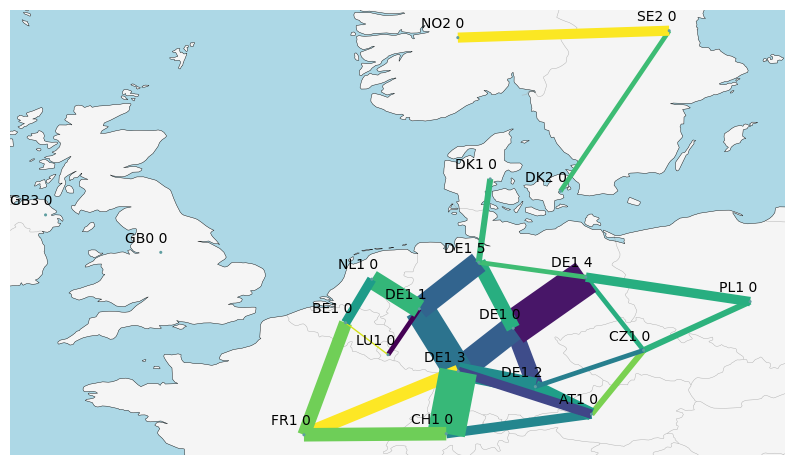

In [13]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [14]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


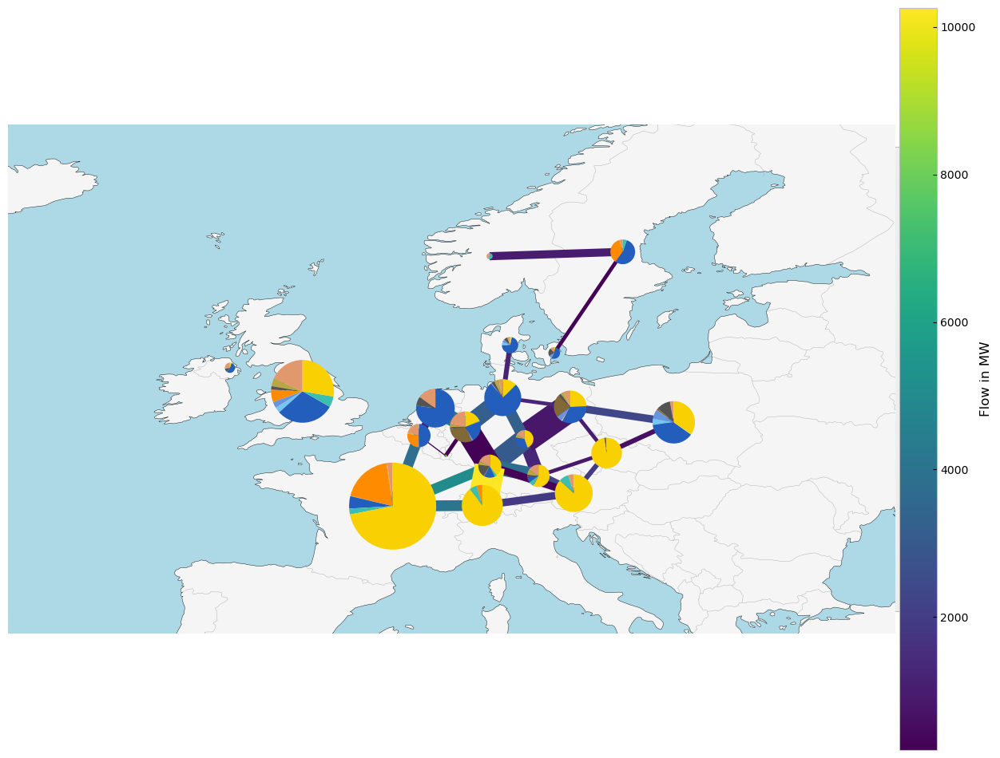

In [15]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [16]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


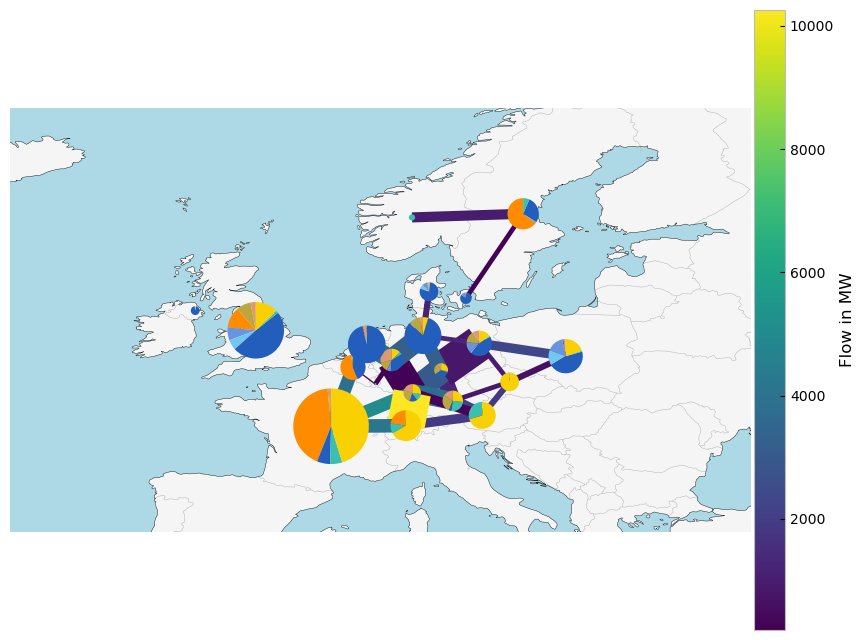

In [17]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

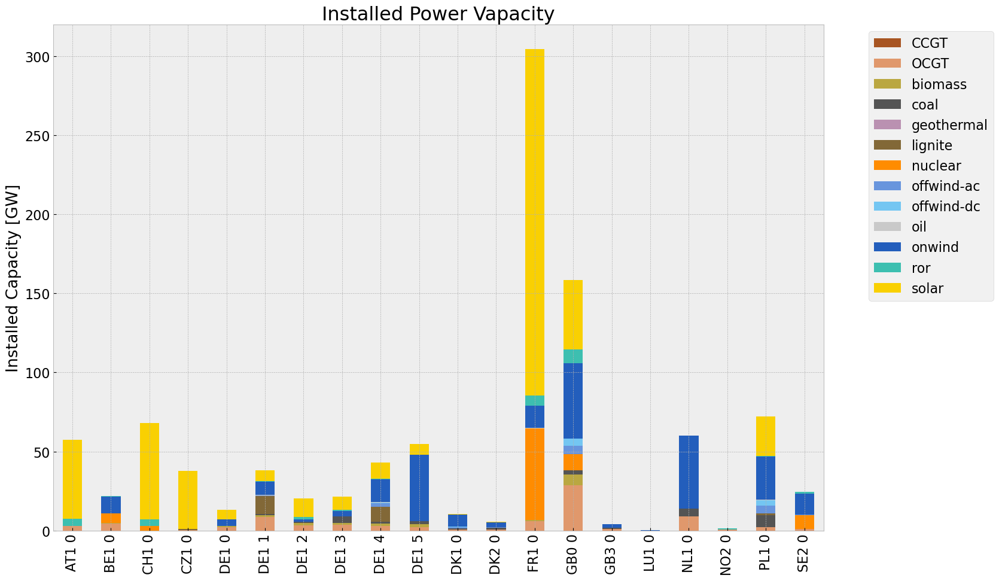

In [18]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

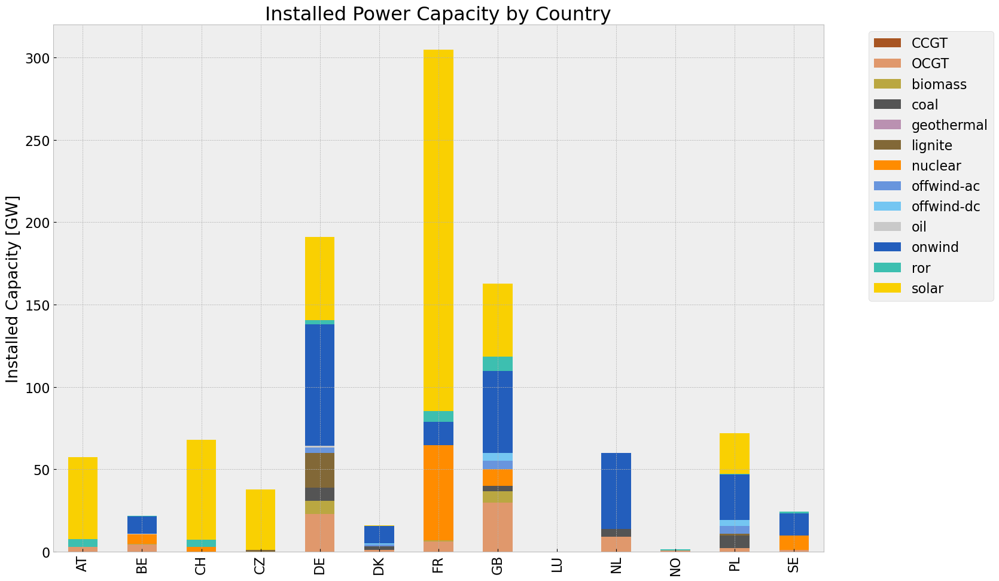

In [19]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

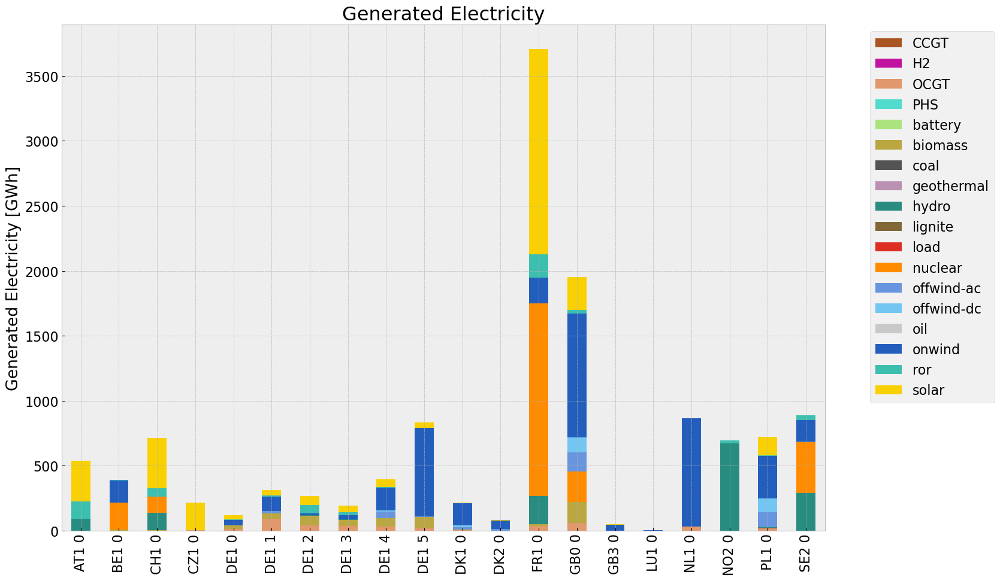

In [20]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

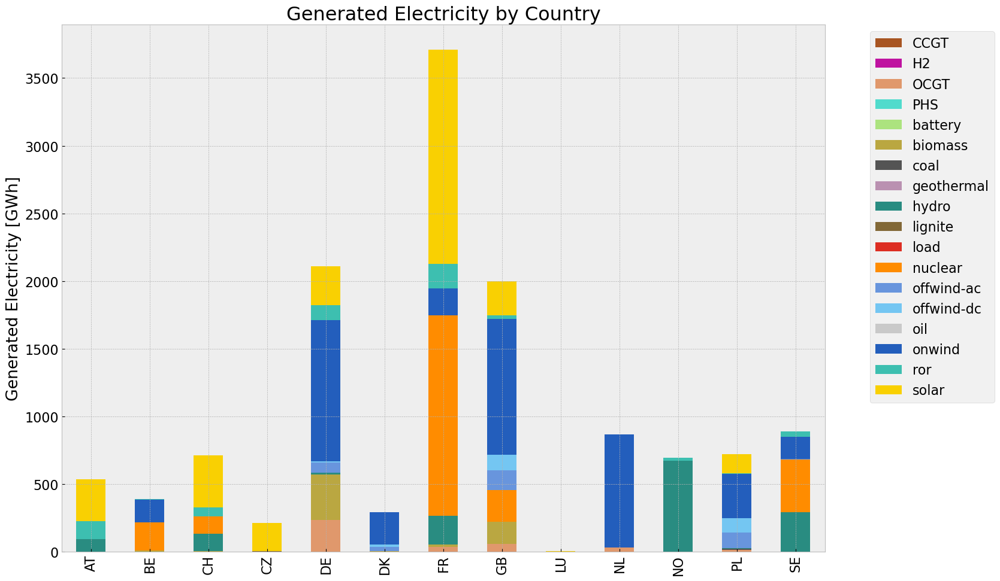

In [21]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [22]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [23]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [24]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [25]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [26]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [27]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [28]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pandas\plotting\_matplotlib\core.py:1794: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(None, 0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:79: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')


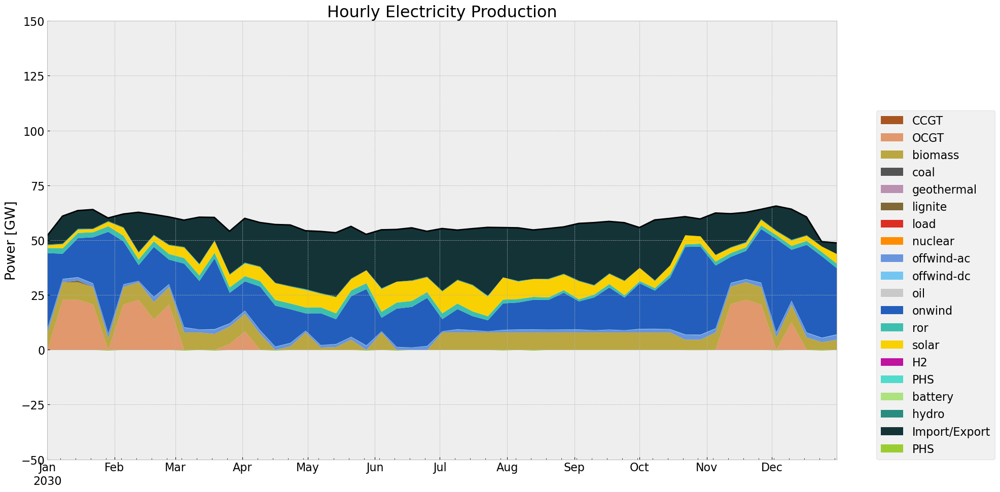

In [29]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

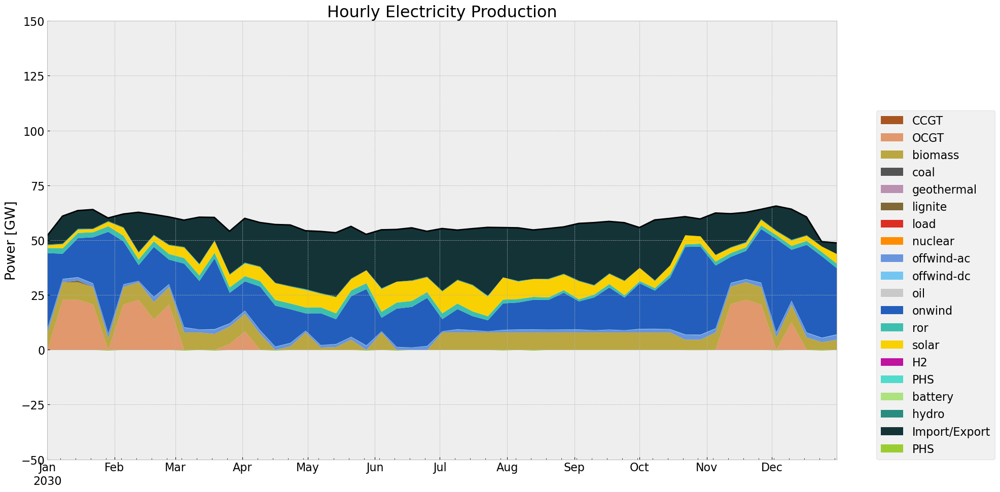

In [30]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [31]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

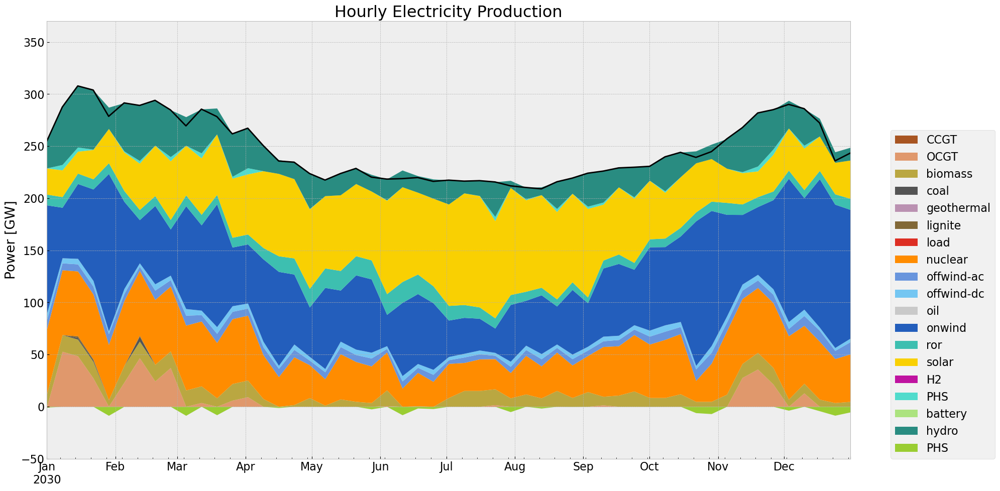

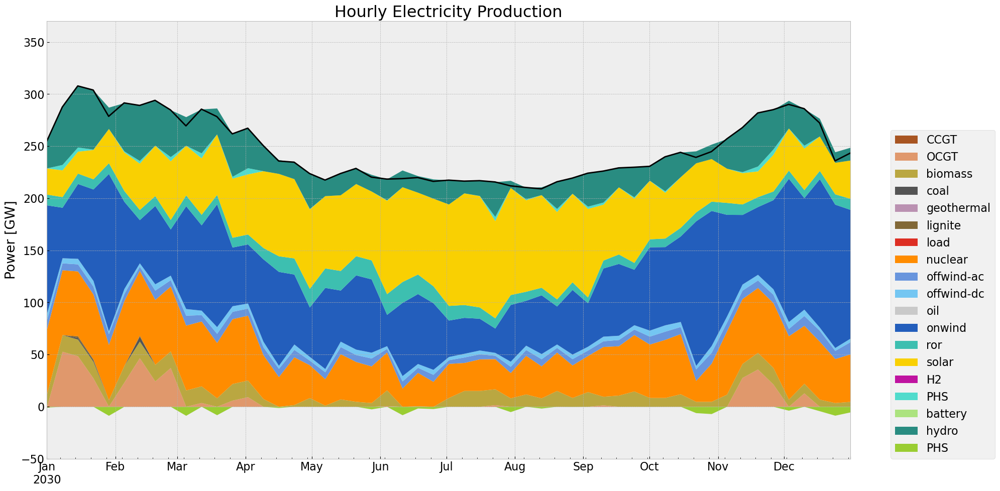

In [32]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [33]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

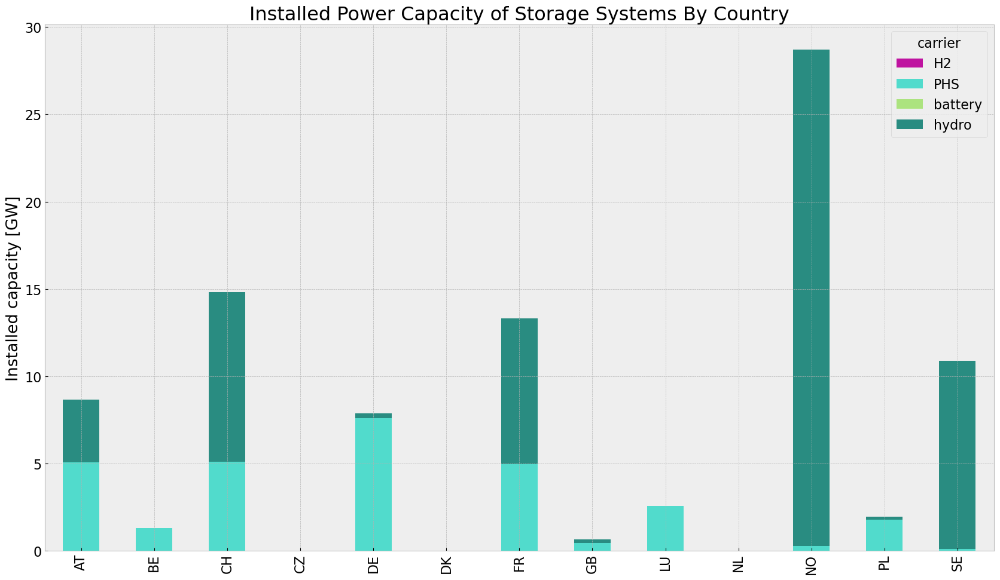

In [34]:
store_base = inst_store_table(n)

In [35]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_18360\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


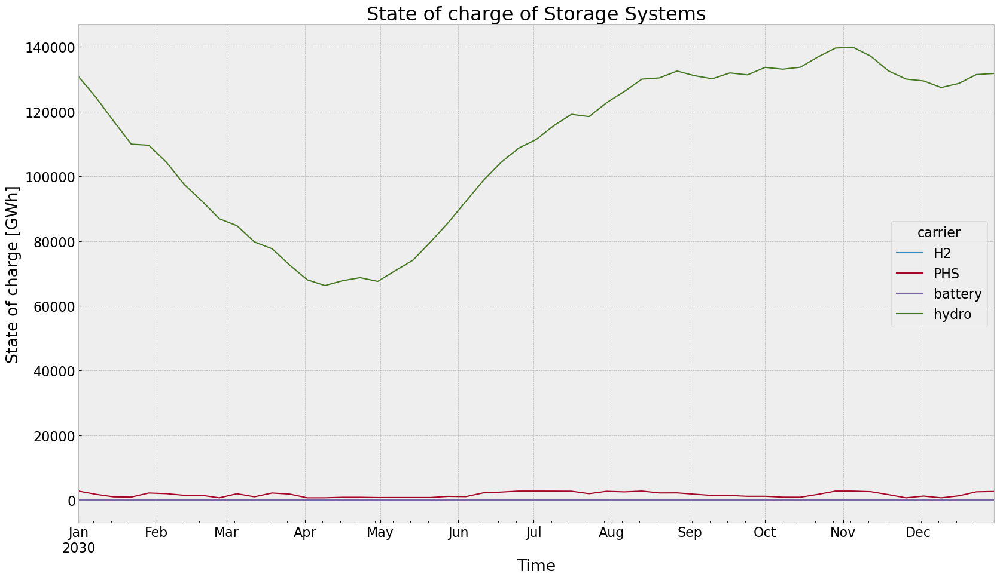

In [36]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [37]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [38]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


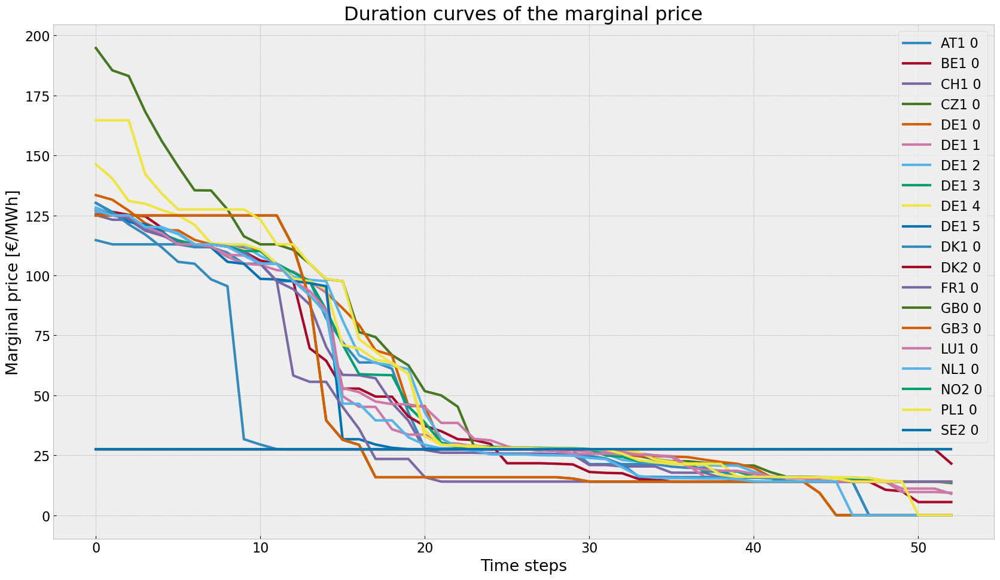

In [39]:
price_dur_curve_plot(n)

In [40]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


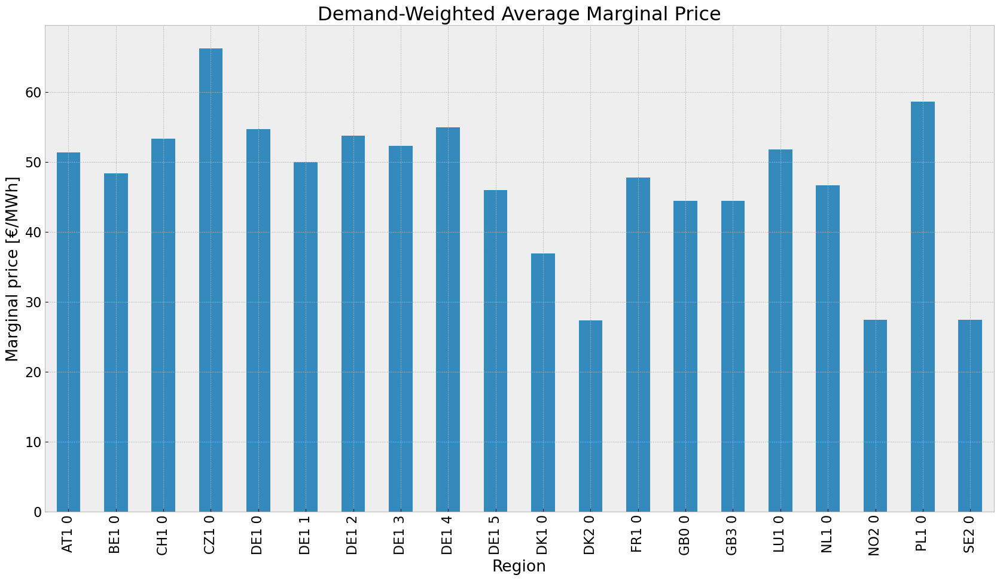

In [41]:
price_regions_table(n)

In [42]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


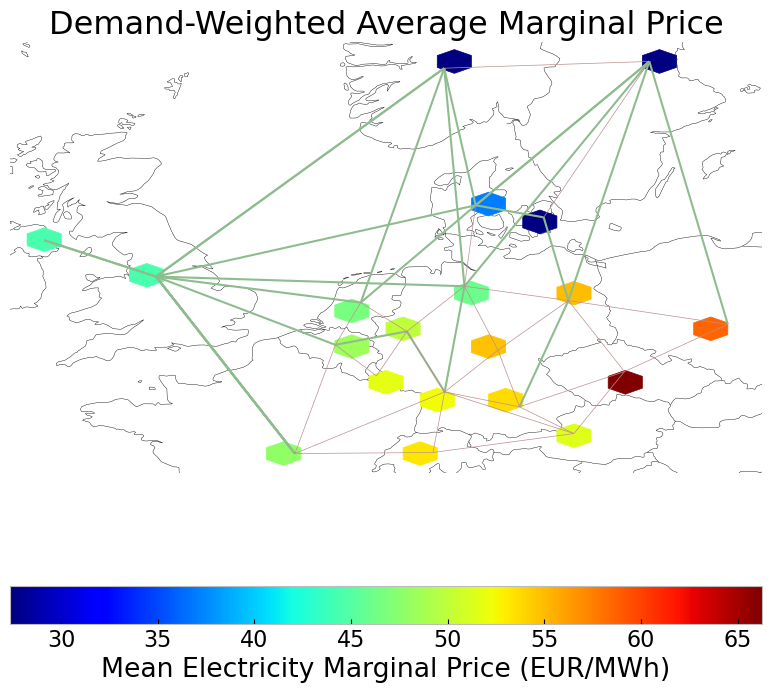

In [43]:
price_regions(n)

## Emission

In [44]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,3.802787e+05,0.451621,0.1980,166722.109286
biomass,5.322671e+05,0.468000,0.0000,0.000000
coal,7.782127e+03,0.329908,0.3361,7928.187466
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.352508e+03,0.337285,0.4069,4044.462271
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.445132e+06,0.326600,0.0000,0.000000
offwind-ac,3.712800e+05,1.000000,0.0000,0.000000


# Drought Scenario



In [45]:
def extract_carriers(column_names, carriers):
    """
    Filters columns that match the specified carrier names.
    
    Parameters:
    - column_names: List of column names in the DataFrame.
    - carriers: List of carrier names to match.
    
    Returns:
    - List of column names that match the carriers.
    """
    return [col for col in column_names if any(carrier in col for carrier in carriers)]

def max_generation_period(n, num_days, carriers):
    """
    Iterates through the DataFrame and finds the start date with the maximum generation sum for specified carriers over a given number of days.
    
    Parameters:
    - df: DataFrame containing the data.
    - num_days: The total number of days over which to sum the generation.
    - carriers: List of carrier names to be summed (e.g., ['CCGT', 'OCGT', 'biomass']).

    Returns:
    - Start date with the highest generation and the corresponding sum.
    """
    #combine storage production with generators
    df = n.generators_t.p
    sto = n.storage_units_t.p
    df = pd.concat([df,sto], axis = 1)
    
    # Determine the timestep in days based on the DataFrame's index
    timestep = (df.index[1] - df.index[0]).total_seconds() / 86400  # Convert seconds to days
    num_rows = round(num_days / timestep)  # Calculate number of rows needed, round to nearest whole number
    
    # Extract column names matching the specified carriers
    relevant_columns = extract_carriers(df.columns, carriers)
    
    max_generation = 0
    start_date_with_max_generation = None

    # Iterate over each row in the DataFrame
    for start_idx in range(len(df)):
        #print(start_idx)
        # Ensure we do not exceed the DataFrame's length
        if start_idx + num_rows <= len(df):
            # Sum the generation for specified carriers over the period
            current_sum = df.iloc[start_idx:start_idx + num_rows][relevant_columns].sum().sum()
            #print(df.index[start_idx],current_sum)
            # Check if the current sum is the highest found so far
            if current_sum > max_generation:
                max_generation = current_sum
                start_date_with_max_generation = df.index[start_idx]

    return start_date_with_max_generation

def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC':
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC':
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False 
            
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

In [52]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
#cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.5


def droughtscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()

    #define cut start based on the period with max generation of the chosen carrier    
    cut_start = max_generation_period(n, duration, carriers_to_cut)
    #print(cut_start)    
    cut_end = cut_start + pd.Timedelta(days= duration)

    #implement drought

    #storage hydro cut
    n_new.storage_units_t.inflow.loc[cut_start:cut_end] *= reductionto

    #ror cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('ror') or column.endswith('nuclear') :
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu

    return n_new

carriers_to_cut = ['ror','nuclear','hydro']
n1 = droughtscenario(n, carriers_to_cut, duration, reductionto)
n1.name = f'inv_{contingency}'          

2013-01-01 00:00:00


In [53]:
pd.concat([n1.generators_t.p_max_pu['AT1 0 ror'],n.generators_t.p_max_pu['AT1 0 ror']], axis = 1)

,AT1 0 ror,AT1 0 ror
snapshot,,
2013-01-01,0.166027,0.332055
2013-01-08,0.194960,0.389920
2013-01-15,0.172691,0.345382
2013-01-22,0.165101,0.330202
2013-01-29,0.166781,0.333562
2013-02-05,0.152434,0.304869
2013-02-12,0.136394,0.272788
2013-02-19,0.131107,0.262213
2013-02-26,0.135170,0.270340


## 1. Model: perfect foresight with allowed additional investment

In [211]:
country = 'DE'

### Allow investment

In [212]:

allow_inv(n1,n, country)

In [213]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 94.48it/s]
INFO:linopy.io: Writing time: 0.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rpoenq55.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rpoenq55.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x0f22a603


INFO:gurobipy:Model fingerprint: 0x0f22a603


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68077246e+13 -1.25117400e+14  7.62e+05 2.49e+05  3.36e+10     0s


INFO:gurobipy:   0   2.68077246e+13 -1.25117400e+14  7.62e+05 2.49e+05  3.36e+10     0s


   1   1.83220465e+13 -5.61286339e+13  4.80e+05 6.62e+04  1.73e+10     0s


INFO:gurobipy:   1   1.83220465e+13 -5.61286339e+13  4.80e+05 6.62e+04  1.73e+10     0s


   2   6.02778177e+12 -3.15798064e+13  1.12e+05 1.55e+04  4.50e+09     0s


INFO:gurobipy:   2   6.02778177e+12 -3.15798064e+13  1.12e+05 1.55e+04  4.50e+09     0s


   3   1.38438615e+12 -1.18497004e+13  9.63e+03 1.50e+03  6.44e+08     0s


INFO:gurobipy:   3   1.38438615e+12 -1.18497004e+13  9.63e+03 1.50e+03  6.44e+08     0s


   4   4.63460515e+11 -2.54763191e+12  1.18e+03 1.82e+02  1.10e+08     0s


INFO:gurobipy:   4   4.63460515e+11 -2.54763191e+12  1.18e+03 1.82e+02  1.10e+08     0s


   5   2.20515032e+11 -1.59696885e+12  2.75e+02 1.13e+02  5.97e+07     0s


INFO:gurobipy:   5   2.20515032e+11 -1.59696885e+12  2.75e+02 1.13e+02  5.97e+07     0s


   6   1.52107482e+11 -7.63197961e+11  1.22e+02 5.17e+01  2.94e+07     0s


INFO:gurobipy:   6   1.52107482e+11 -7.63197961e+11  1.22e+02 5.17e+01  2.94e+07     0s


   7   8.64141038e+10 -2.25706368e+11  2.75e+01 1.45e+01  9.80e+06     0s


INFO:gurobipy:   7   8.64141038e+10 -2.25706368e+11  2.75e+01 1.45e+01  9.80e+06     0s


   8   4.87691006e+10 -9.15976444e+10  5.62e+00 6.52e+00  4.37e+06     0s


INFO:gurobipy:   8   4.87691006e+10 -9.15976444e+10  5.62e+00 6.52e+00  4.37e+06     0s


   9   3.61160041e+10 -3.47816197e+10  2.47e+00 3.10e+00  2.20e+06     0s


INFO:gurobipy:   9   3.61160041e+10 -3.47816197e+10  2.47e+00 3.10e+00  2.20e+06     0s


  10   3.26786367e+10 -2.60527199e+09  1.87e+00 1.24e+00  1.10e+06     0s


INFO:gurobipy:  10   3.26786367e+10 -2.60527199e+09  1.87e+00 1.24e+00  1.10e+06     0s


  11   2.71486431e+10  8.54945238e+09  1.04e+00 5.66e-01  5.77e+05     0s


INFO:gurobipy:  11   2.71486431e+10  8.54945238e+09  1.04e+00 5.66e-01  5.77e+05     0s


  12   2.48314943e+10  1.05889691e+10  7.04e-01 4.58e-01  4.42e+05     0s


INFO:gurobipy:  12   2.48314943e+10  1.05889691e+10  7.04e-01 4.58e-01  4.42e+05     0s


  13   2.24986470e+10  1.41291186e+10  3.78e-01 2.60e-01  2.59e+05     0s


INFO:gurobipy:  13   2.24986470e+10  1.41291186e+10  3.78e-01 2.60e-01  2.59e+05     0s


  14   2.05283110e+10  1.76576540e+10  1.11e-01 7.78e-02  8.90e+04     0s


INFO:gurobipy:  14   2.05283110e+10  1.76576540e+10  1.11e-01 7.78e-02  8.90e+04     0s


  15   2.00673450e+10  1.90041157e+10  6.20e-02 1.62e-02  3.29e+04     0s


INFO:gurobipy:  15   2.00673450e+10  1.90041157e+10  6.20e-02 1.62e-02  3.29e+04     0s


  16   1.97484734e+10  1.91414265e+10  3.03e-02 1.06e-02  1.88e+04     0s


INFO:gurobipy:  16   1.97484734e+10  1.91414265e+10  3.03e-02 1.06e-02  1.88e+04     0s


  17   1.96504063e+10  1.92657070e+10  2.12e-02 5.53e-03  1.19e+04     0s


INFO:gurobipy:  17   1.96504063e+10  1.92657070e+10  2.12e-02 5.53e-03  1.19e+04     0s


  18   1.95044649e+10  1.93489684e+10  7.48e-03 2.44e-03  4.82e+03     0s


INFO:gurobipy:  18   1.95044649e+10  1.93489684e+10  7.48e-03 2.44e-03  4.82e+03     0s


  19   1.94743419e+10  1.93887311e+10  4.63e-03 1.03e-03  2.65e+03     0s


INFO:gurobipy:  19   1.94743419e+10  1.93887311e+10  4.63e-03 1.03e-03  2.65e+03     0s


  20   1.94398930e+10  1.94103026e+10  1.62e-03 2.99e-04  9.16e+02     1s


INFO:gurobipy:  20   1.94398930e+10  1.94103026e+10  1.62e-03 2.99e-04  9.16e+02     1s


  21   1.94227074e+10  1.94181861e+10  1.54e-04 4.56e-05  1.40e+02     1s


INFO:gurobipy:  21   1.94227074e+10  1.94181861e+10  1.54e-04 4.56e-05  1.40e+02     1s


  22   1.94212618e+10  1.94195616e+10  5.87e-05 1.44e-05  5.26e+01     1s


INFO:gurobipy:  22   1.94212618e+10  1.94195616e+10  5.87e-05 1.44e-05  5.26e+01     1s


  23   1.94204893e+10  1.94200558e+10  1.23e-05 4.37e-06  1.34e+01     1s


INFO:gurobipy:  23   1.94204893e+10  1.94200558e+10  1.23e-05 4.37e-06  1.34e+01     1s


  24   1.94203445e+10  1.94202090e+10  9.61e-06 1.41e-06  4.20e+00     1s


INFO:gurobipy:  24   1.94203445e+10  1.94202090e+10  9.61e-06 1.41e-06  4.20e+00     1s


  25   1.94202987e+10  1.94202669e+10  1.74e-06 3.64e-07  9.83e-01     1s


INFO:gurobipy:  25   1.94202987e+10  1.94202669e+10  1.74e-06 3.64e-07  9.83e-01     1s


  26   1.94202886e+10  1.94202863e+10  3.48e-07 3.03e-08  7.25e-02     1s


INFO:gurobipy:  26   1.94202886e+10  1.94202863e+10  3.48e-07 3.03e-08  7.25e-02     1s


  27   1.94202883e+10  1.94202882e+10  1.35e-07 3.33e-10  1.18e-03     1s


INFO:gurobipy:  27   1.94202883e+10  1.94202882e+10  1.35e-07 3.33e-10  1.18e-03     1s


  28   1.94202883e+10  1.94202883e+10  3.29e-07 8.07e-11  6.78e-06     1s


INFO:gurobipy:  28   1.94202883e+10  1.94202883e+10  3.29e-07 8.07e-11  6.78e-06     1s


  29   1.94202883e+10  1.94202883e+10  8.15e-10 1.24e-10  1.80e-08     1s


INFO:gurobipy:  29   1.94202883e+10  1.94202883e+10  8.15e-10 1.24e-10  1.80e-08     1s


  30   1.94202883e+10  1.94202883e+10  2.22e-10 9.46e-11  5.88e-10     1s


INFO:gurobipy:  30   1.94202883e+10  1.94202883e+10  2.22e-10 9.46e-11  5.88e-10     1s


INFO:gurobipy:


Barrier solved model in 30 iterations and 0.69 seconds (0.28 work units)


INFO:gurobipy:Barrier solved model in 30 iterations and 0.69 seconds (0.28 work units)


Optimal objective 1.94202883e+10


INFO:gurobipy:Optimal objective 1.94202883e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3144 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3144 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     155 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     155 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2507660e-09      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2507660e-09      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1757    1.9420288e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1757    1.9420288e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1757 iterations and 0.84 seconds (0.32 work units)


INFO:gurobipy:Solved in 1757 iterations and 0.84 seconds (0.32 work units)


Optimal objective  1.942028826e+10


INFO:gurobipy:Optimal objective  1.942028826e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.94e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [214]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_drought.nc has loads, generators, carriers, lines, storage_units, buses, links


<xarray.Dataset> Size: 277kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, loads_i: 20,
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 97,
                                           ...
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           links_i: 28, links_t_p0_i: 16,
                                           links_t_p1_i: 16)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
    ...                                    ...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 128B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 128B '14801' ...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    links_p_nom_opt                       (links_i) float64 224B 1.881e+03 .....
    links_reversed                        (links_i) bool 28B False ... False
    links_p_nom_extendable                (links_i) bool 28B True ... False
    links_p_nom_min                       (links_i) float64 224B 0.0 0.0 ... 0.0
    links_t_p0                            (snapshots, links_t_p0_i) float64 7kB ...
    links_t_p1                            (snapshots, links_t_p1_i) float64 7kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_drought
    network_objective:           19420288262.10643
    network_objective_constant:  10801412755.028429
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [215]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

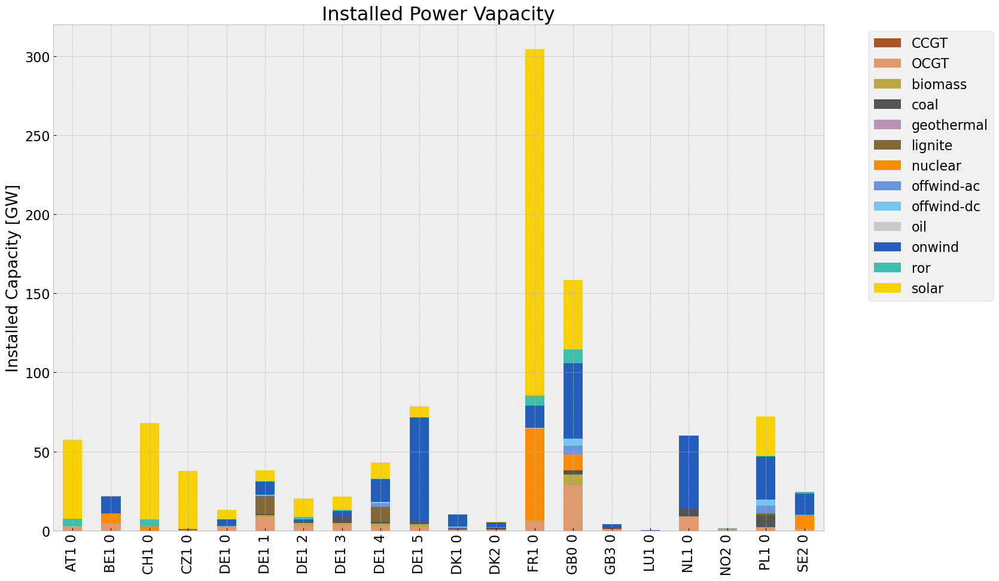

<Figure size 640x480 with 0 Axes>

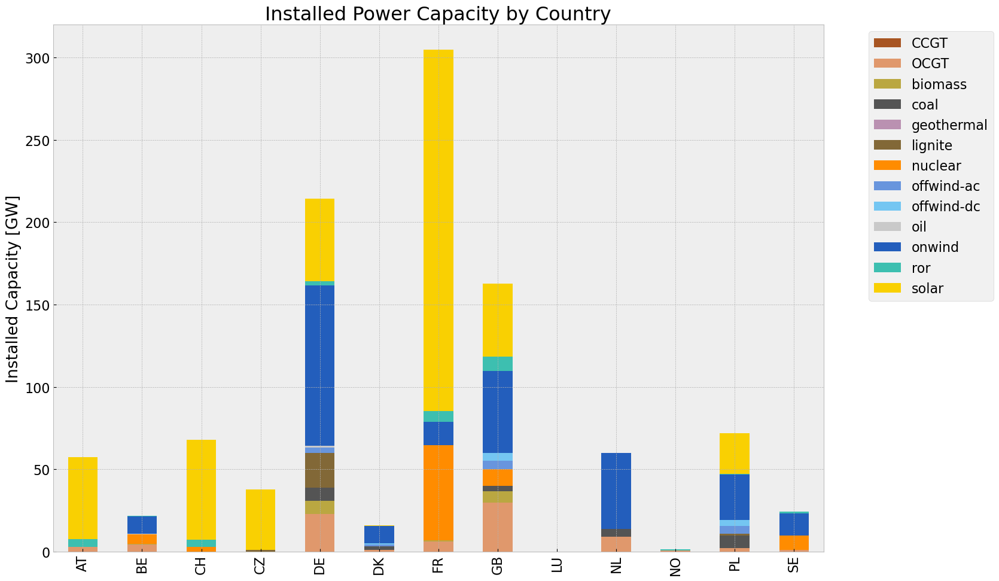

In [216]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

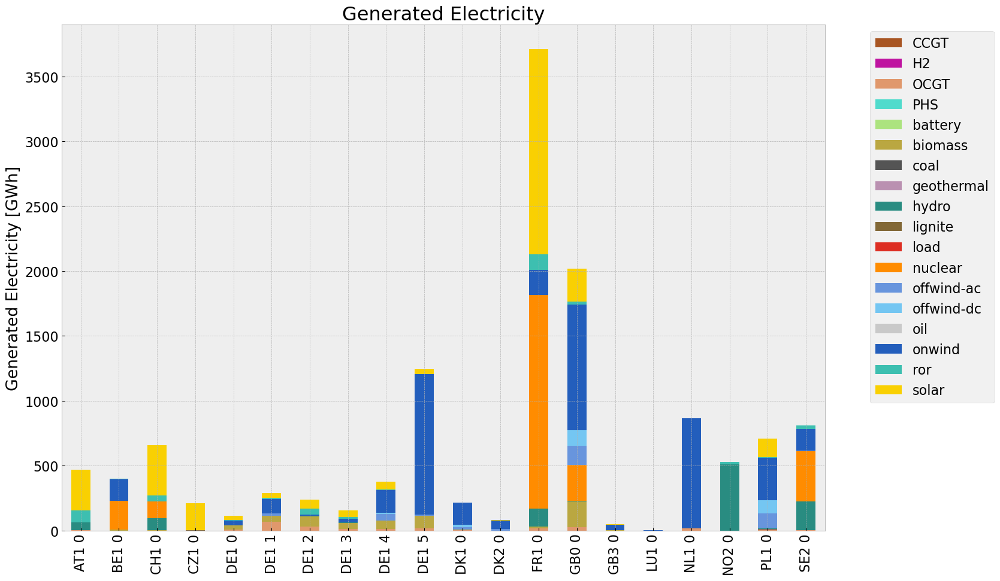

<Figure size 640x480 with 0 Axes>

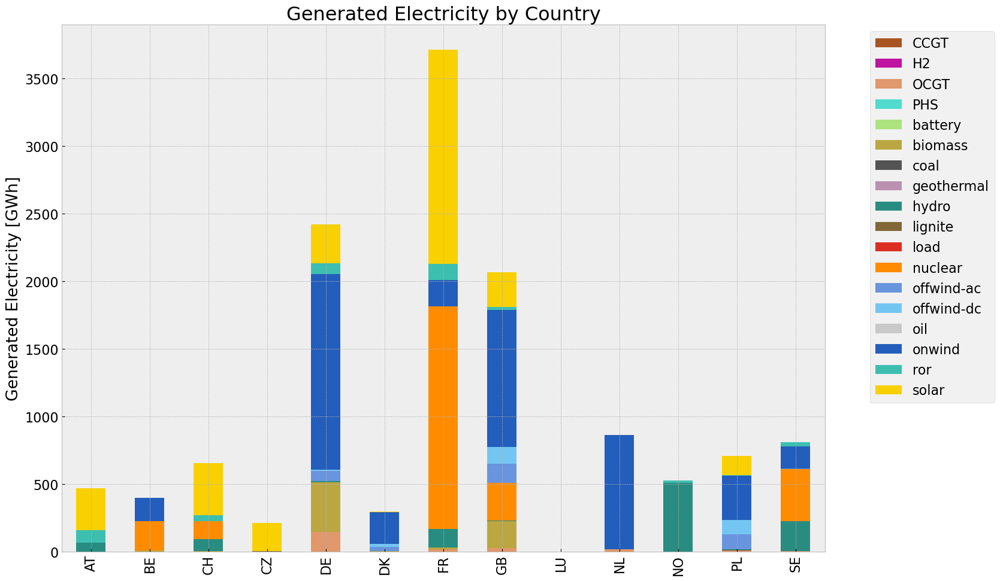

In [217]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

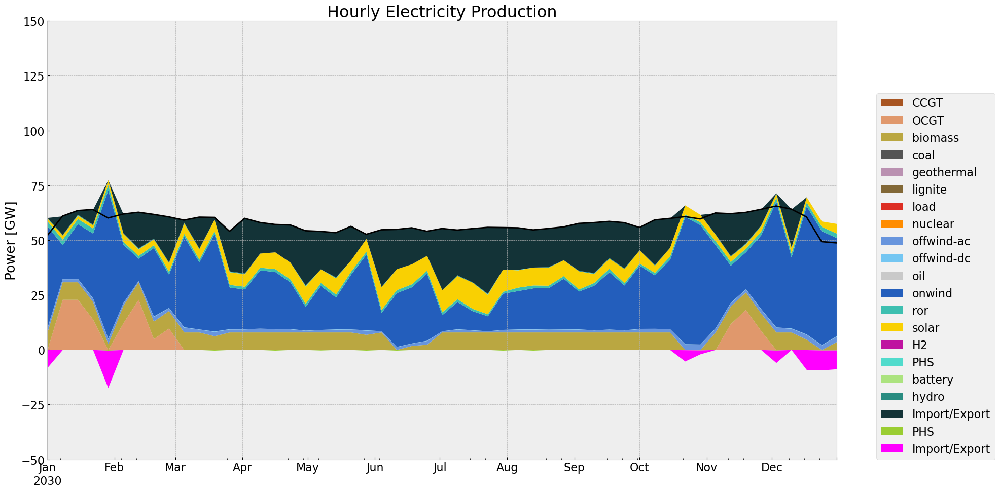

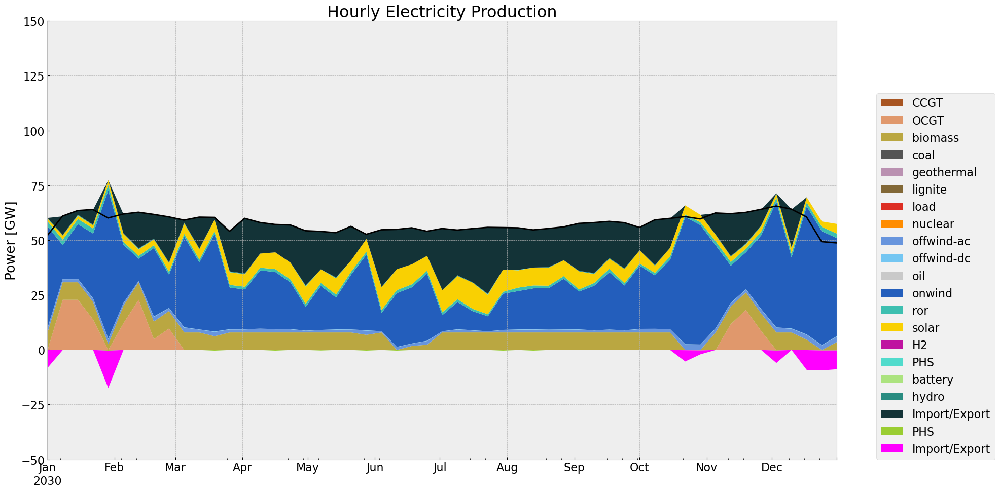

In [218]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

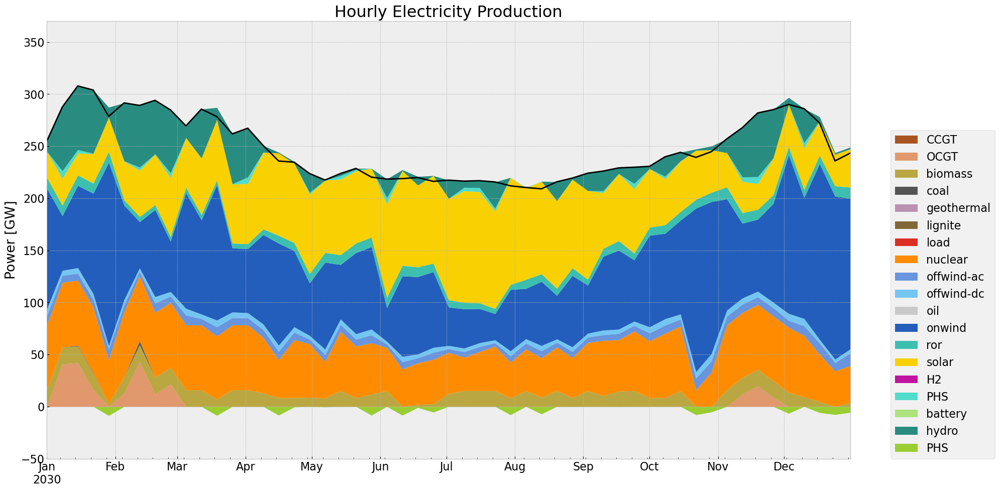

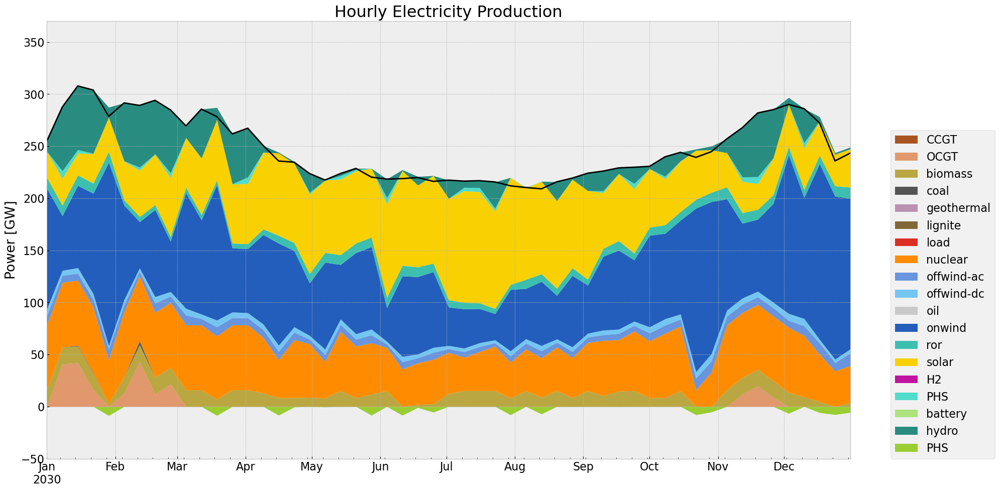

In [219]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

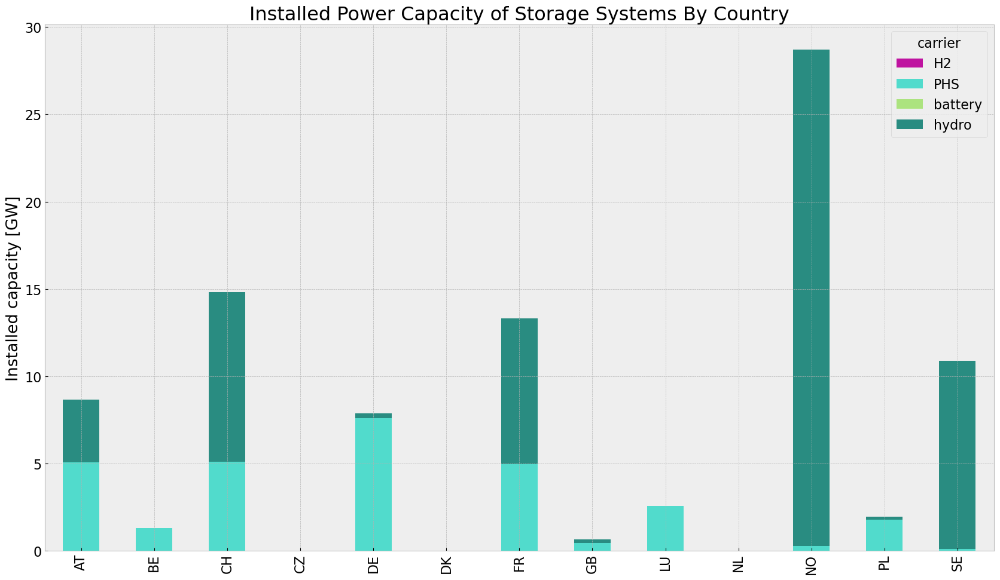

In [220]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


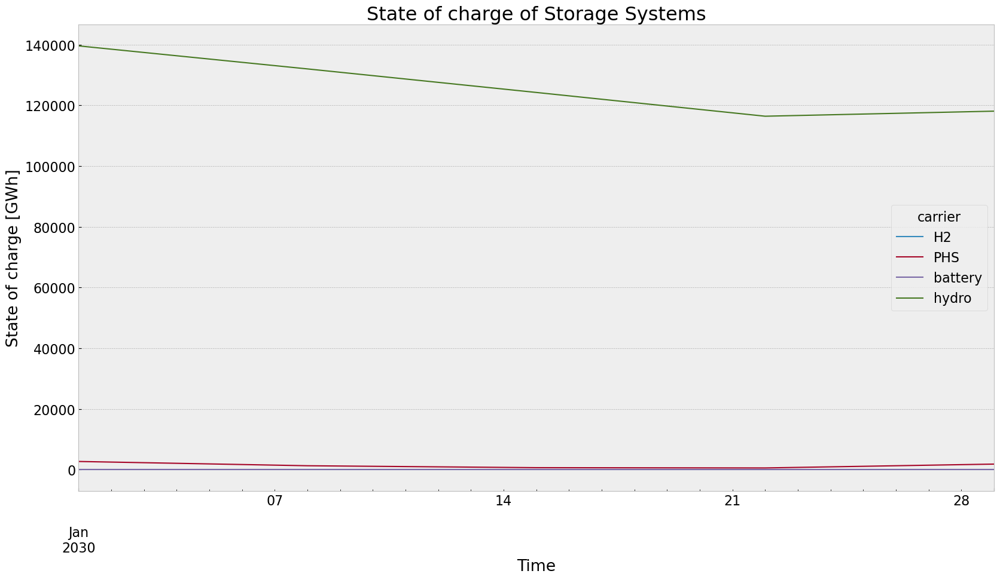

In [221]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


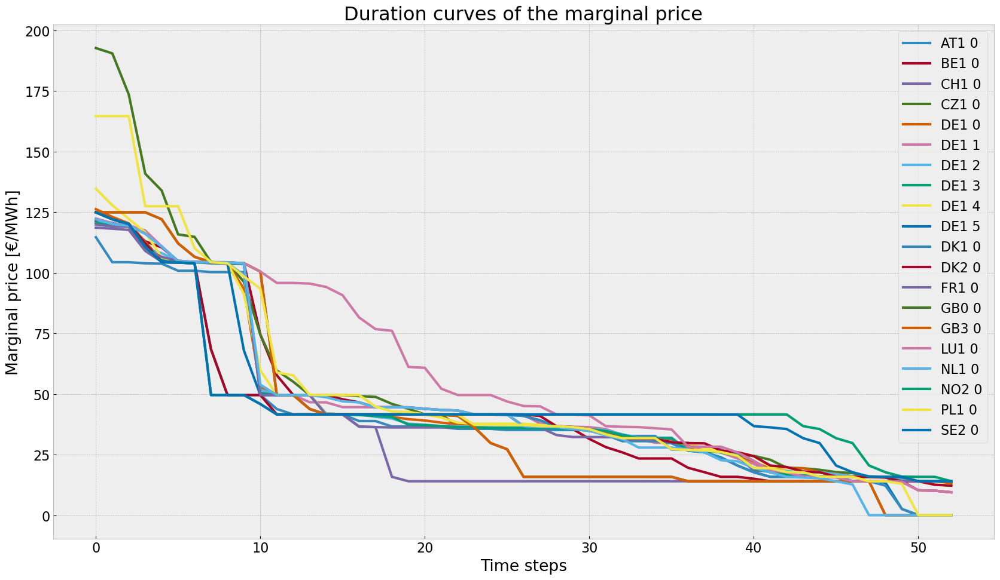

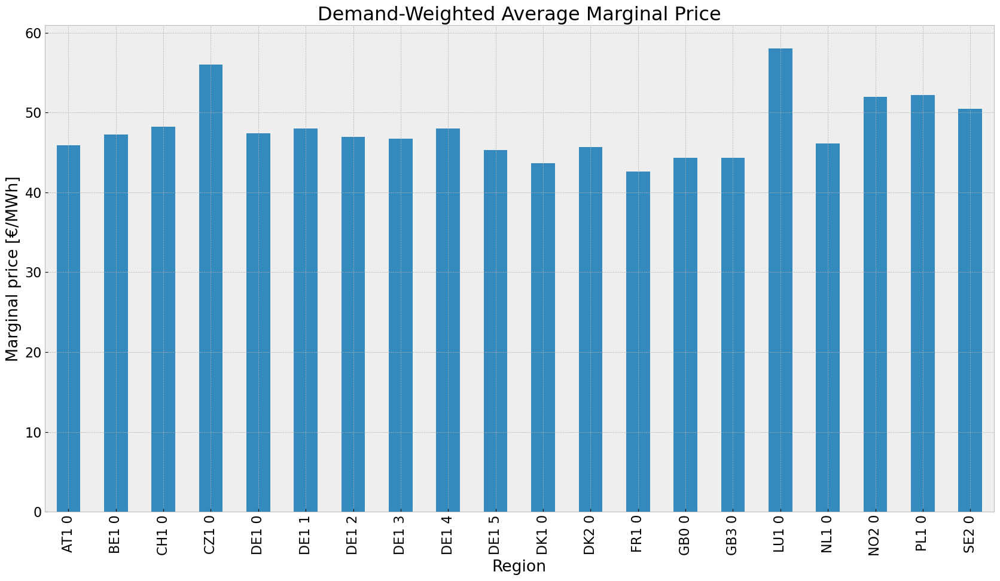

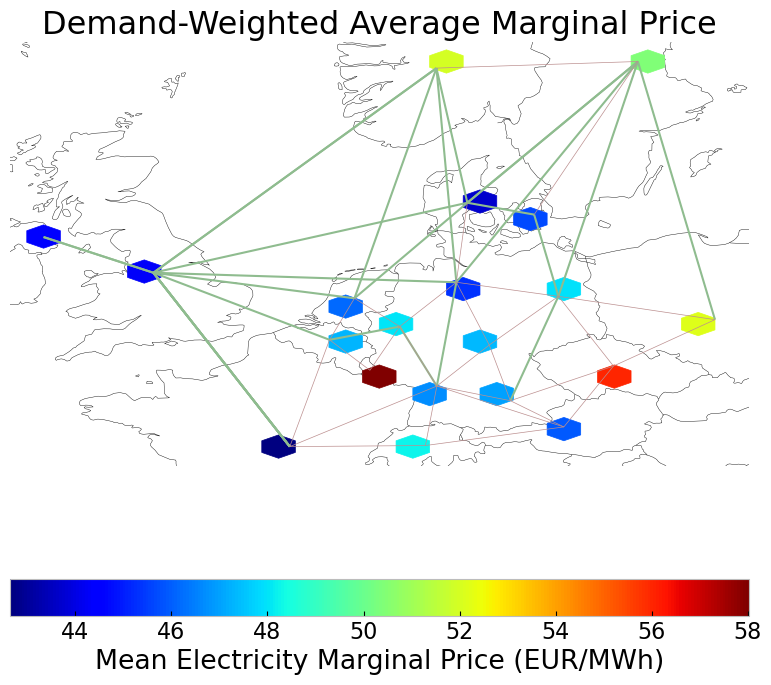

In [222]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [223]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,2.285568e+05,0.451621,0.1980,100204.054909
biomass,6.003143e+05,0.468000,0.0000,0.000000
coal,3.464756e+03,0.329908,0.3361,3529.785628
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.483056e+03,0.337285,0.4069,2995.556866
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.657874e+06,0.326600,0.0000,0.000000
offwind-ac,3.721348e+05,1.000000,0.0000,0.000000


## 2. Noinv

In [224]:
n2 = droughtscenario(n, cut_start, duration, reductionto)

### No Investment

In [225]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)


In [226]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 4
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'


INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-61rhy20_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-61rhy20_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x4a9ca0bd


INFO:gurobipy:Model fingerprint: 0x4a9ca0bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9320496e+08   1.010944e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.9320496e+08   1.010944e+06   0.000000e+00      0s


Extra simplex iterations after uncrush: 4


INFO:gurobipy:Extra simplex iterations after uncrush: 4


     327    1.9170658e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     327    1.9170658e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 327 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 327 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917065804e+10


INFO:gurobipy:Optimal objective  1.917065804e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2tuc9nx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2tuc9nx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x3c3c5b83


INFO:gurobipy:Model fingerprint: 0x3c3c5b83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4232792e+08   9.960889e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4232792e+08   9.960889e+05   0.000000e+00      0s


     306    2.2149209e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    2.2149209e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.214920893e+10


INFO:gurobipy:Optimal objective  2.214920893e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.21e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wsf08bg5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wsf08bg5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xf638a196


INFO:gurobipy:Model fingerprint: 0xf638a196


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1108 columns


INFO:gurobipy:Presolve removed 4248 rows and 1108 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 976 columns, 1588 nonzeros


INFO:gurobipy:Presolved: 224 rows, 976 columns, 1588 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1237358e+08   1.009312e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1237358e+08   1.009312e+06   0.000000e+00      0s


     337    2.1379023e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    2.1379023e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 337 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.137902280e+10


INFO:gurobipy:Optimal objective  2.137902280e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.14e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f09ivbkg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f09ivbkg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x5a97a2c5


INFO:gurobipy:Model fingerprint: 0x5a97a2c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1110 columns


INFO:gurobipy:Presolve removed 4248 rows and 1110 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0143271e+07   1.029741e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.0143271e+07   1.029741e+06   0.000000e+00      0s


     341    1.4441892e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    1.4441892e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.444189229e+10


INFO:gurobipy:Optimal objective  1.444189229e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vulj6ghq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vulj6ghq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x164c57d7


INFO:gurobipy:Model fingerprint: 0x164c57d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4248 rows and 1114 columns


INFO:gurobipy:Presolve removed 4248 rows and 1114 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5953365e+07   1.042646e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5953365e+07   1.042646e+06   0.000000e+00      0s


     378    3.4065602e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     378    3.4065602e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 378 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 378 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.406560217e+08


INFO:gurobipy:Optimal objective  3.406560217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a5ncz7dx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a5ncz7dx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xd0f7767a


INFO:gurobipy:Model fingerprint: 0xd0f7767a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1120 columns


INFO:gurobipy:Presolve removed 4248 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 964 columns, 1576 nonzeros


INFO:gurobipy:Presolved: 224 rows, 964 columns, 1576 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6016608e+07   1.035588e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6016608e+07   1.035588e+06   0.000000e+00      0s


     314    1.3165586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    1.3165586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 314 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.316558575e+08


INFO:gurobipy:Optimal objective  1.316558575e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wm7b_ez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wm7b_ez.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xa1e13e04


INFO:gurobipy:Model fingerprint: 0xa1e13e04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1114 columns


INFO:gurobipy:Presolve removed 4248 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6044006e+07   1.032866e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6044006e+07   1.032866e+06   0.000000e+00      0s


     350    1.4744221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     350    1.4744221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 350 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 350 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.474422140e+08


INFO:gurobipy:Optimal objective  1.474422140e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rflhh9cx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rflhh9cx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x5a1b49ae


INFO:gurobipy:Model fingerprint: 0x5a1b49ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1115 columns


INFO:gurobipy:Presolve removed 4248 rows and 1115 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 969 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 224 rows, 969 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1595451e+07   1.029643e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1595451e+07   1.029643e+06   0.000000e+00      0s


     329    3.1834043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     329    3.1834043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 329 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 329 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.183404274e+08


INFO:gurobipy:Optimal objective  3.183404274e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu0iv6ee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu0iv6ee.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x136d60ec


INFO:gurobipy:Model fingerprint: 0x136d60ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1113 columns


INFO:gurobipy:Presolve removed 4248 rows and 1113 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 971 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 224 rows, 971 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1615286e+07   1.026767e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1615286e+07   1.026767e+06   0.000000e+00      0s


     392    3.8620363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     392    3.8620363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 392 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 392 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.862036320e+08


INFO:gurobipy:Optimal objective  3.862036320e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzvyd76s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzvyd76s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x4d2b6b03


INFO:gurobipy:Model fingerprint: 0x4d2b6b03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1116 columns


INFO:gurobipy:Presolve removed 4248 rows and 1116 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 968 columns, 1580 nonzeros


INFO:gurobipy:Presolved: 224 rows, 968 columns, 1580 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6013515e+07   1.020785e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6013515e+07   1.020785e+06   0.000000e+00      0s


     387    5.9520926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     387    5.9520926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 387 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 387 iterations and 0.05 seconds (0.01 work units)


Optimal objective  5.952092565e+08


INFO:gurobipy:Optimal objective  5.952092565e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cfypr164.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cfypr164.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xb51f4b0a


INFO:gurobipy:Model fingerprint: 0xb51f4b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1112 columns


INFO:gurobipy:Presolve removed 4248 rows and 1112 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 972 columns, 1584 nonzeros


INFO:gurobipy:Presolved: 224 rows, 972 columns, 1584 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1288144e+05   1.009929e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1288144e+05   1.009929e+06   0.000000e+00      0s


     371    3.7020635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     371    3.7020635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 371 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 371 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.702063494e+08


INFO:gurobipy:Optimal objective  3.702063494e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bdoldcwh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bdoldcwh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x3bb4207e


INFO:gurobipy:Model fingerprint: 0x3bb4207e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1110 columns


INFO:gurobipy:Presolve removed 4248 rows and 1110 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2054966e+07   9.852851e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2054966e+07   9.852851e+05   0.000000e+00      0s


     390    3.4097911e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     390    3.4097911e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 390 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 390 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.409791140e+09


INFO:gurobipy:Optimal objective  3.409791140e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5m6kfm6o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5m6kfm6o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xbcb8bc0a


INFO:gurobipy:Model fingerprint: 0xbcb8bc0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 224 rows, 955 columns, 1567 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1567 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4233708e+05   1.013131e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.4233708e+05   1.013131e+06   0.000000e+00      0s


     358    6.2039731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     358    6.2039731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 358 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 358 iterations and 0.07 seconds (0.01 work units)


Optimal objective  6.203973073e+08


INFO:gurobipy:Optimal objective  6.203973073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8u1d3hu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8u1d3hu5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1702 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1702 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


Model fingerprint: 0x3ffe68e1


INFO:gurobipy:Model fingerprint: 0x3ffe68e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1087 rows and 348 columns


INFO:gurobipy:Presolve removed 1087 rows and 348 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 31 rows, 173 columns, 261 nonzeros


INFO:gurobipy:Presolved: 31 rows, 173 columns, 261 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6087164e+04   1.529662e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6087164e+04   1.529662e+05   0.000000e+00      0s


      27    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      27    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 27 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 27 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.965476552e+06


INFO:gurobipy:Optimal objective  9.965476552e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [227]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.85it/s]
INFO:linopy.io: Writing time: 0.75s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-per4_l5m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-per4_l5m.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x6e561107


INFO:gurobipy:Model fingerprint: 0x6e561107


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14791 columns


INFO:gurobipy:Presolve removed 56286 rows and 14791 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12822 columns, 20931 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12822 columns, 20931 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49727183e+13 -2.94587622e+13  4.27e+05 1.46e-11  6.57e+09     0s


INFO:gurobipy:   0   1.49727183e+13 -2.94587622e+13  4.27e+05 1.46e-11  6.57e+09     0s


   1   1.70029838e+12 -7.43176310e+12  4.15e+04 8.73e-11  7.68e+08     0s


INFO:gurobipy:   1   1.70029838e+12 -7.43176310e+12  4.15e+04 8.73e-11  7.68e+08     0s


   2   3.86407503e+11 -2.51165361e+12  5.73e+03 1.86e-09  1.56e+08     0s


INFO:gurobipy:   2   3.86407503e+11 -2.51165361e+12  5.73e+03 1.86e-09  1.56e+08     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.34 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.34 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4888    2.1260082e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4888    2.1260082e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4888 iterations and 0.39 seconds (0.12 work units)


INFO:gurobipy:Solved in 4888 iterations and 0.39 seconds (0.12 work units)


Optimal objective  2.126008220e+10


INFO:gurobipy:Optimal objective  2.126008220e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.13e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [228]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_roll_solved_168h.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


<xarray.Dataset> Size: 278kB
Dimensions:                                         (snapshots: 53,
                                                     investment_periods: 0,
                                                     loads_i: 20,
                                                     loads_t_p_set_i: 20,
                                                     loads_t_p_i: 20,
                                                     generators_i: 261,
                                                     ...
                                                     buses_t_v_ang_i: 18,
                                                     buses_t_marginal_price_i: 20,
                                                     links_i: 28,
                                                     links_t_p0_i: 12,
                                                     links_t_p1_i: 12,
                                                     global_constraints_i: 1)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 424B 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * loads_i                                         (loads_i) object 160B 'AT...
  * loads_t_p_set_i                                 (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                     (loads_t_p_i) object 160B ...
  * generators_i                                    (generators_i) object 2kB ...
    ...                                              ...
  * buses_t_v_ang_i                                 (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                        (buses_t_marginal_price_i) object 160B ...
  * links_i                                         (links_i) object 224B '14...
  * links_t_p0_i                                    (links_t_p0_i) object 96B ...
  * links_t_p1_i                                    (links_t_p1_i) object 96B ...
  * global_constraints_i                            (global_constraints_i) object 8B ...
Data variables: (12/102)
    snapshots_snapshot                              (snapshots) datetime64[ns] 424B ...
    snapshots_objective                             (snapshots) float64 424B ...
    snapshots_generators                            (snapshots) float64 424B ...
    snapshots_stores                                (snapshots) float64 424B ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    links_t_p0                                      (snapshots, links_t_p0_i) float64 5kB ...
    links_t_p1                                      (snapshots, links_t_p1_i) float64 5kB ...
    global_constraints_type                         (global_constraints_i) object 8B ...
    global_constraints_carrier_attribute            (global_constraints_i) object 8B ...
    global_constraints_sense                        (global_constraints_i) object 8B ...
    global_constraints_constant                     (global_constraints_i) float64 8B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_drought_roll
    network_objective:       9965476.55201545
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [229]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_drought.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


<xarray.Dataset> Size: 272kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, loads_i: 20,
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 99,
                                           ...
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           links_i: 28, links_t_p0_i: 12,
                                           links_t_p1_i: 12,
                                           global_constraints_i: 1)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
    ...                                    ...
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14805' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14805' ....
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    links_t_p0                            (snapshots, links_t_p0_i) float64 5kB ...
    links_t_p1                            (snapshots, links_t_p1_i) float64 5kB ...
    global_constraints_type               (global_constraints_i) object 8B 't...
    global_constraints_carrier_attribute  (global_constraints_i) object 8B 'A...
    global_constraints_sense              (global_constraints_i) object 8B '<='
    global_constraints_constant           (global_constraints_i) float64 8B 1...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_drought
    network_objective:       21260082201.86979
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [230]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Base Rolling Horizon

In [231]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

<Figure size 640x480 with 0 Axes>

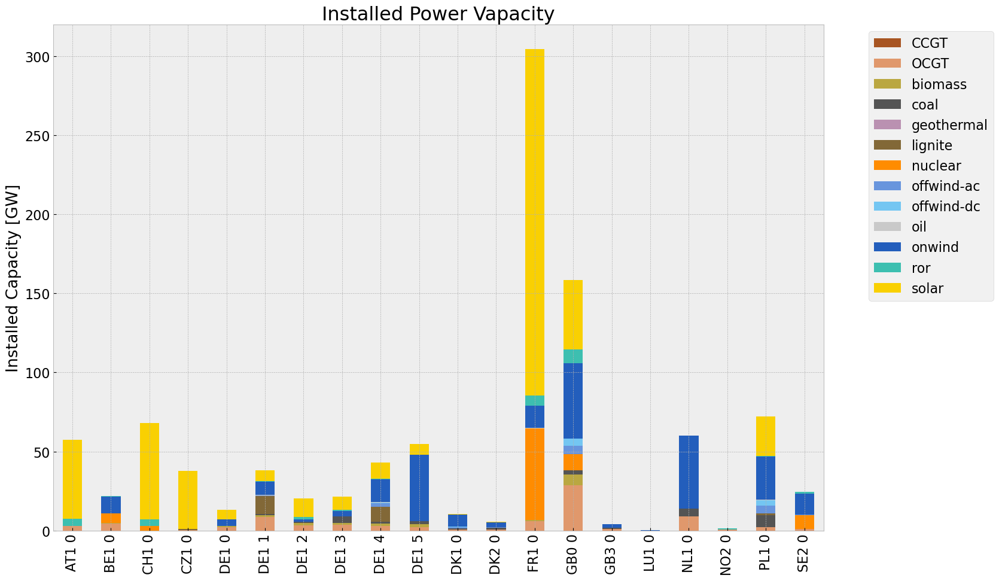

<Figure size 640x480 with 0 Axes>

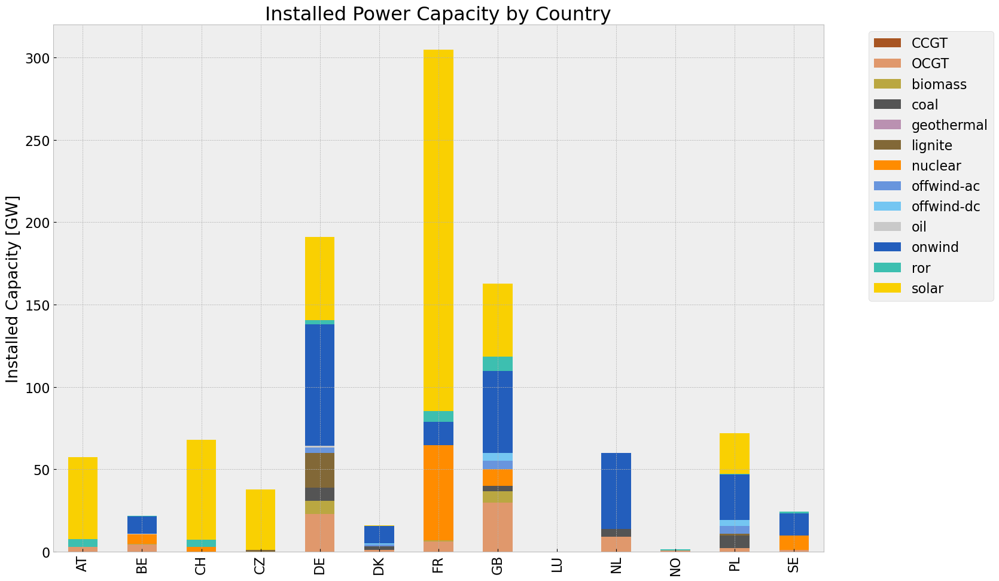

<Figure size 640x480 with 0 Axes>

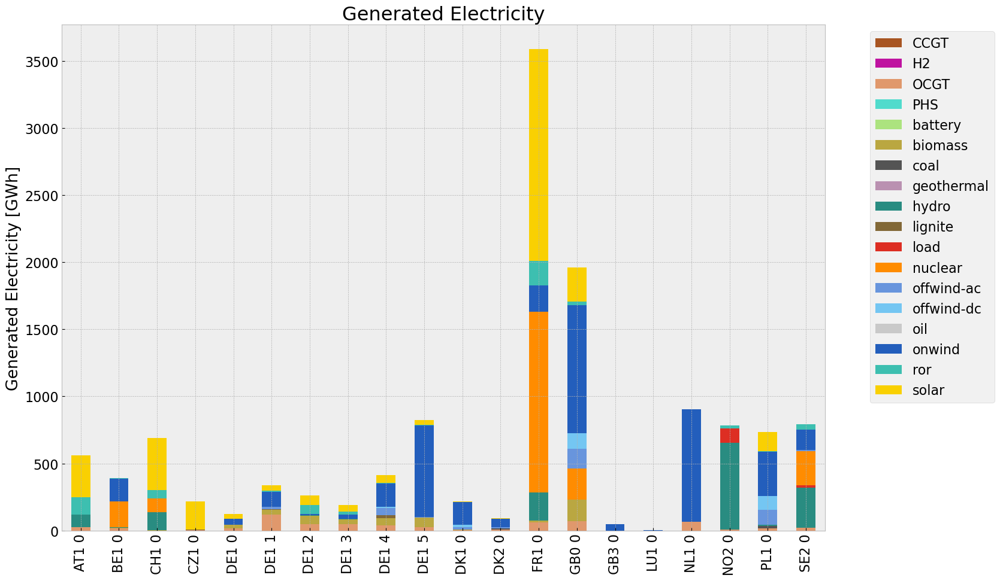

<Figure size 640x480 with 0 Axes>

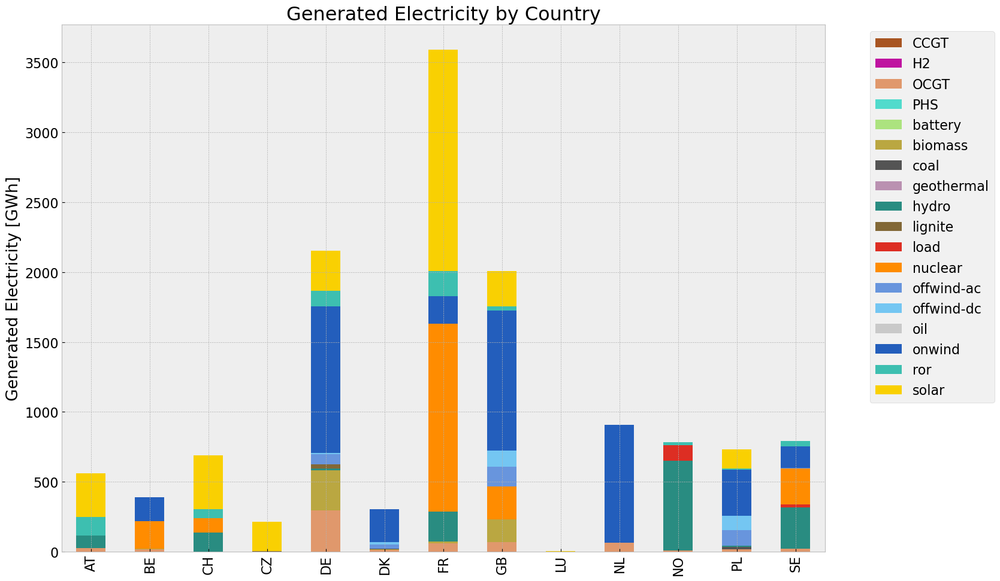

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,5.974587e+05,0.451621,0.1980,261938.380893
biomass,4.733575e+05,0.468000,0.0000,0.000000
coal,2.692287e+04,0.329908,0.3361,27428.180300
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.468601e+04,0.337285,0.4069,41845.167298
load,1.274518e+05,1.000000,0.0000,0.000000
nuclear,2.135659e+06,0.326600,0.0000,0.000000
offwind-ac,3.696111e+05,1.000000,0.0000,0.000000


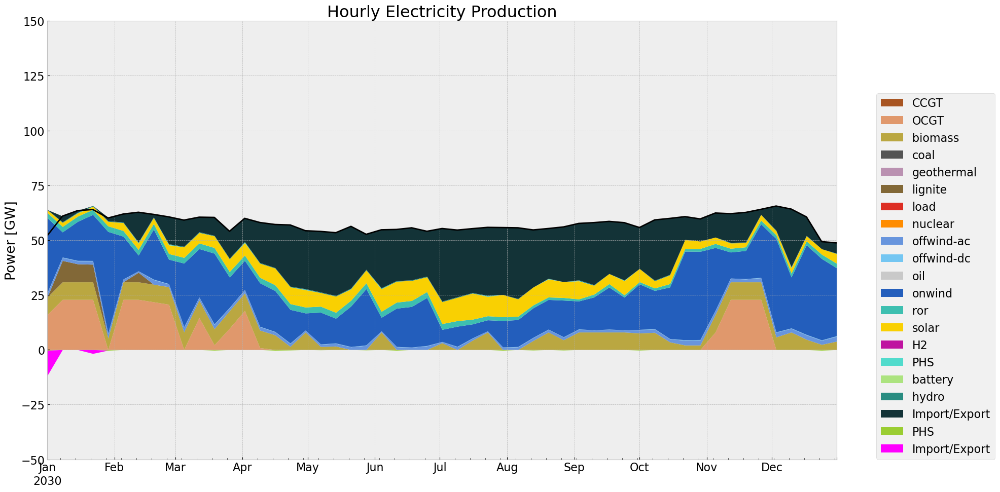

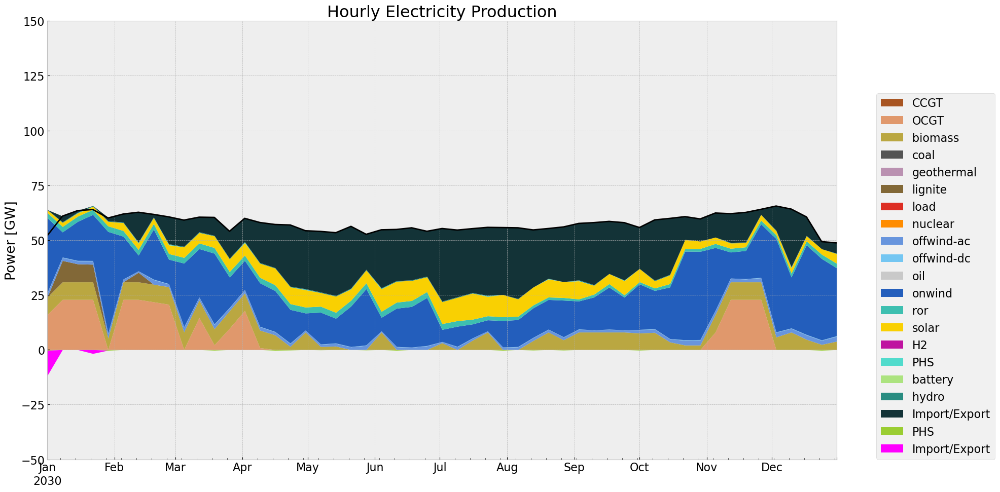

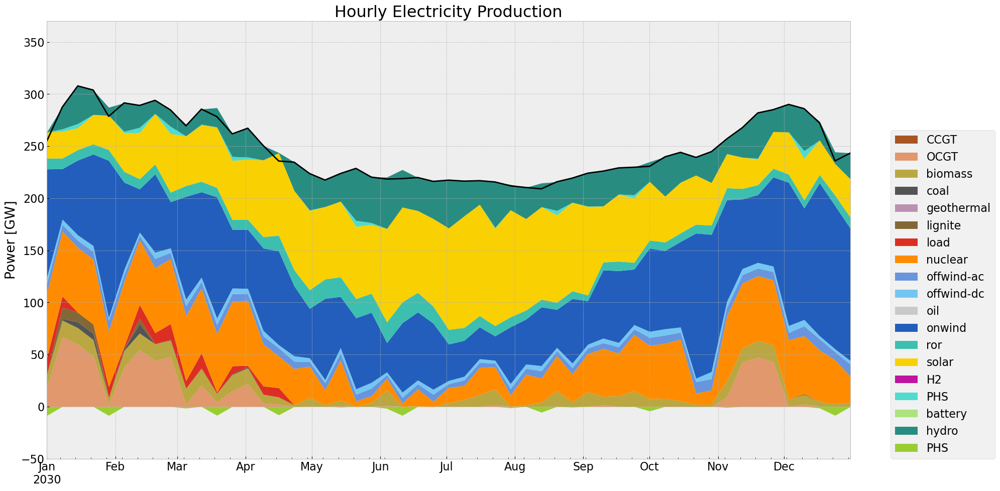

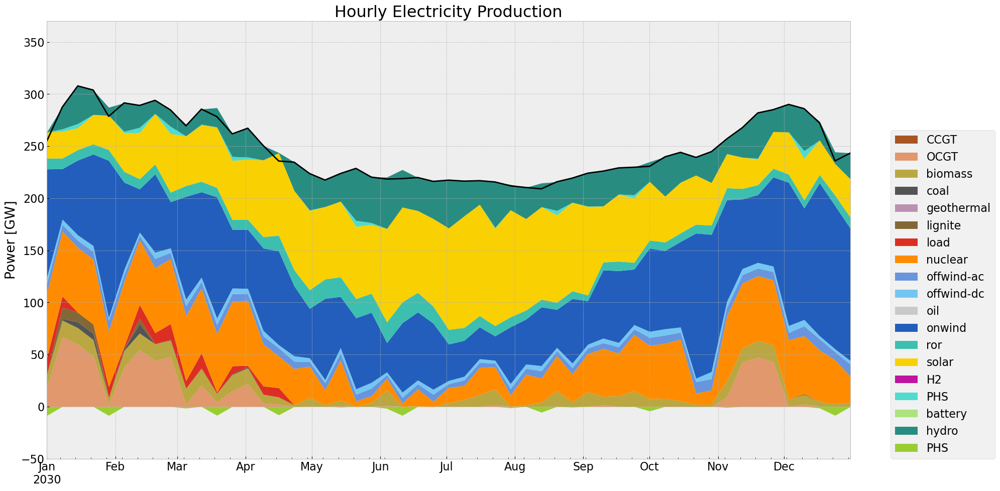

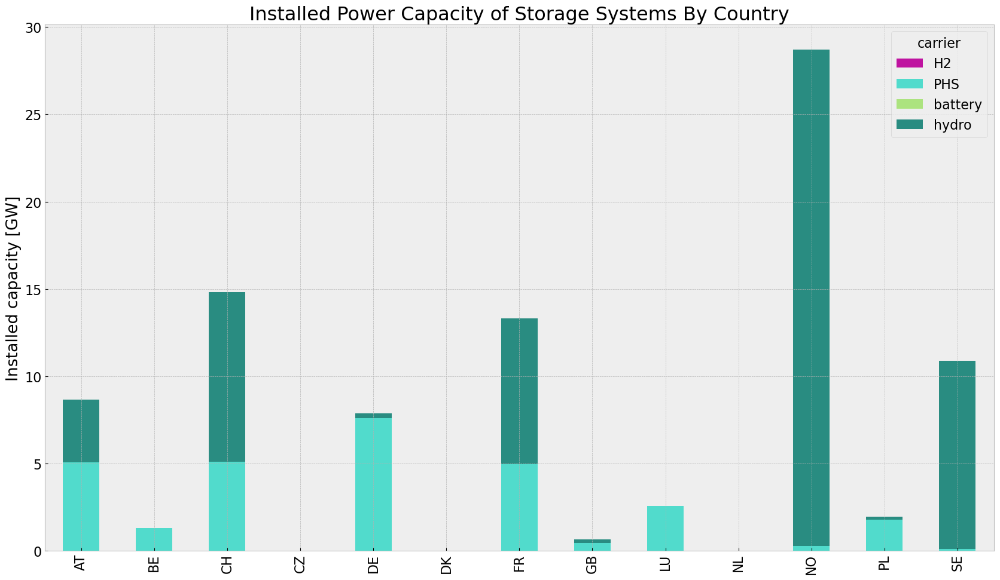

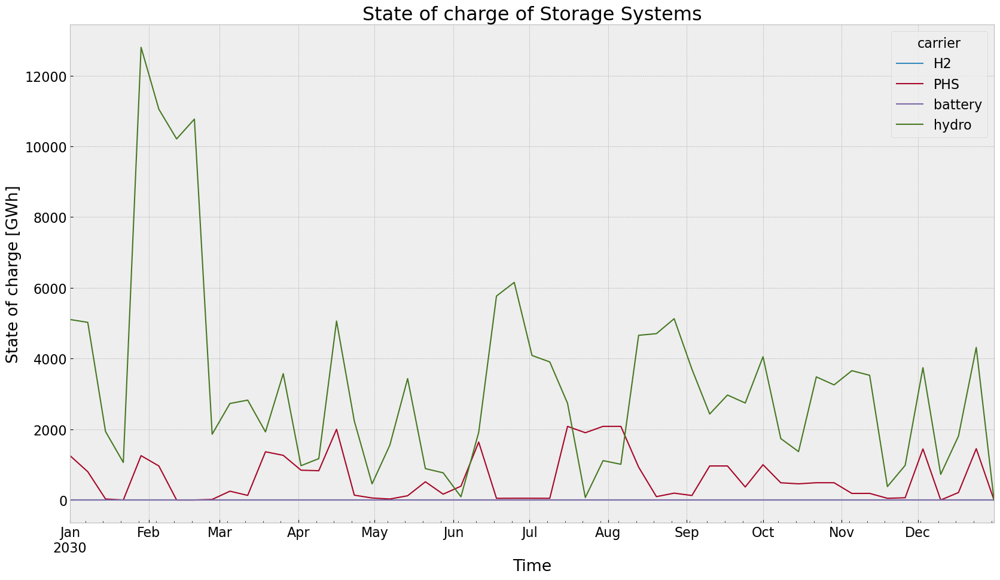

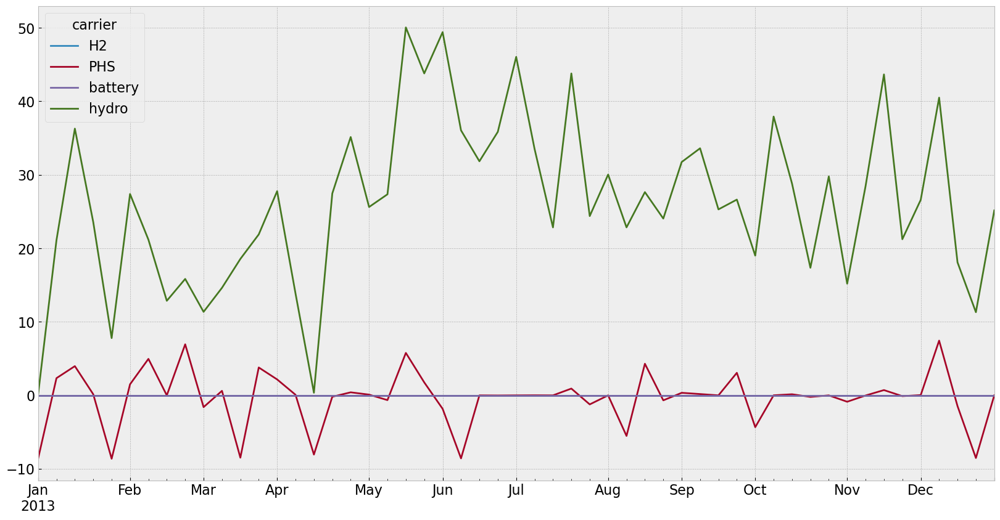

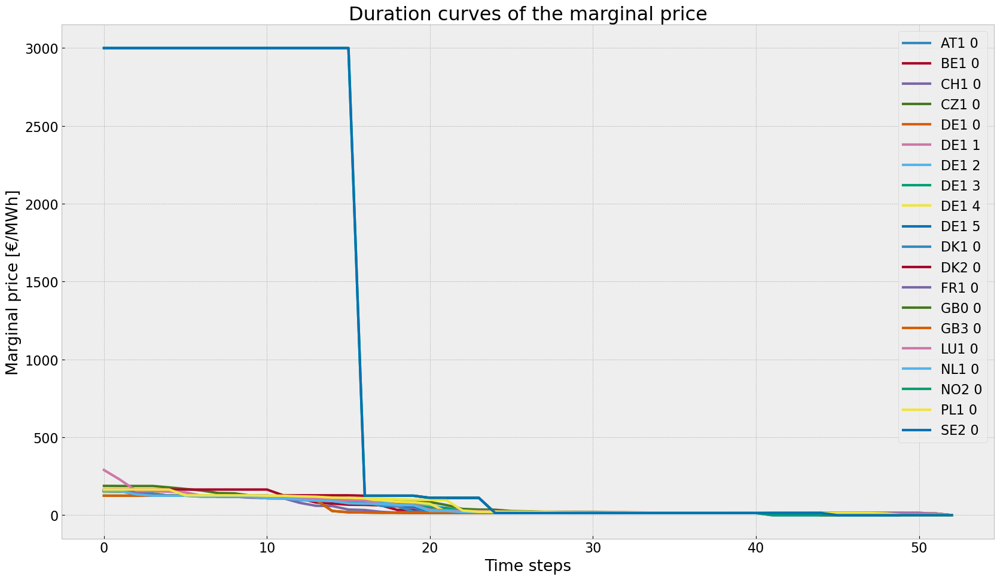

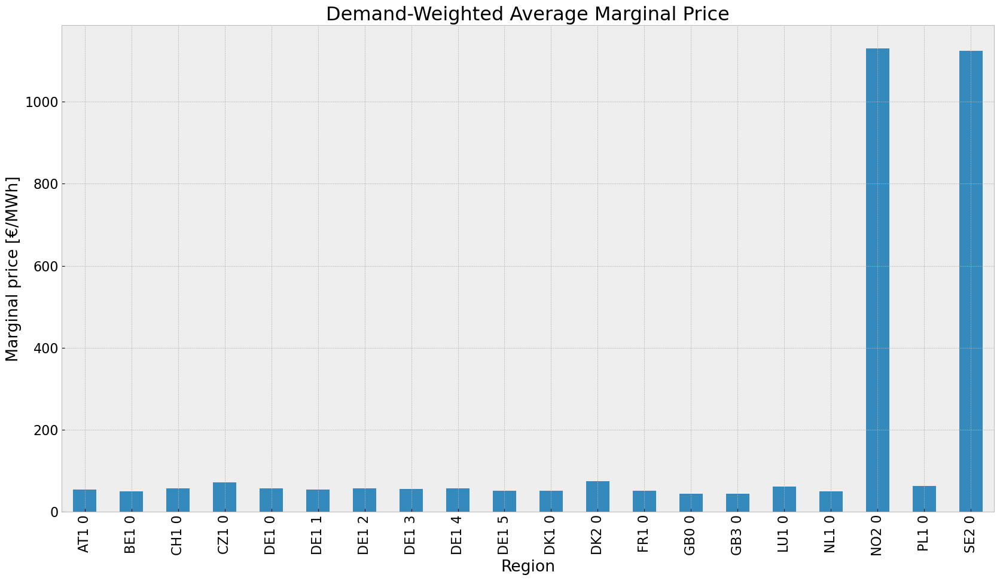

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


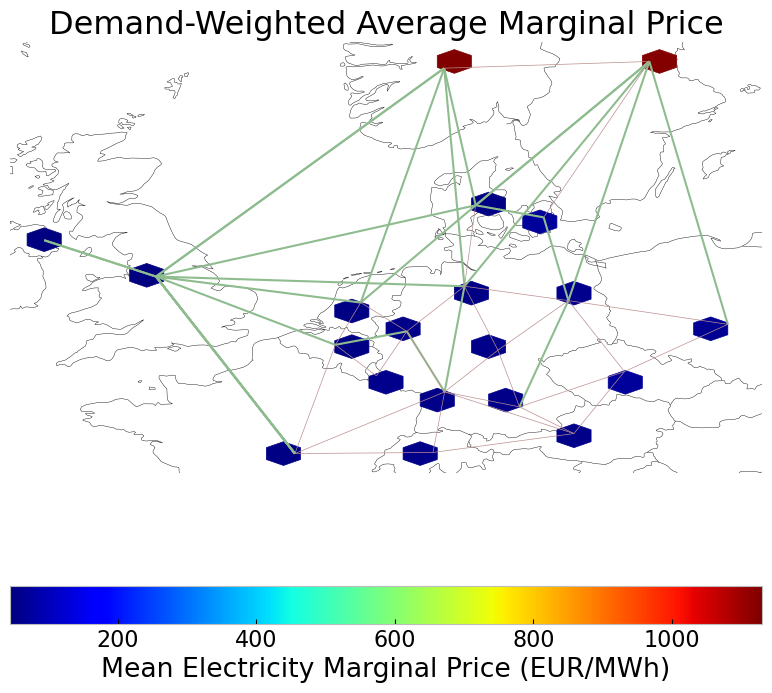

In [232]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

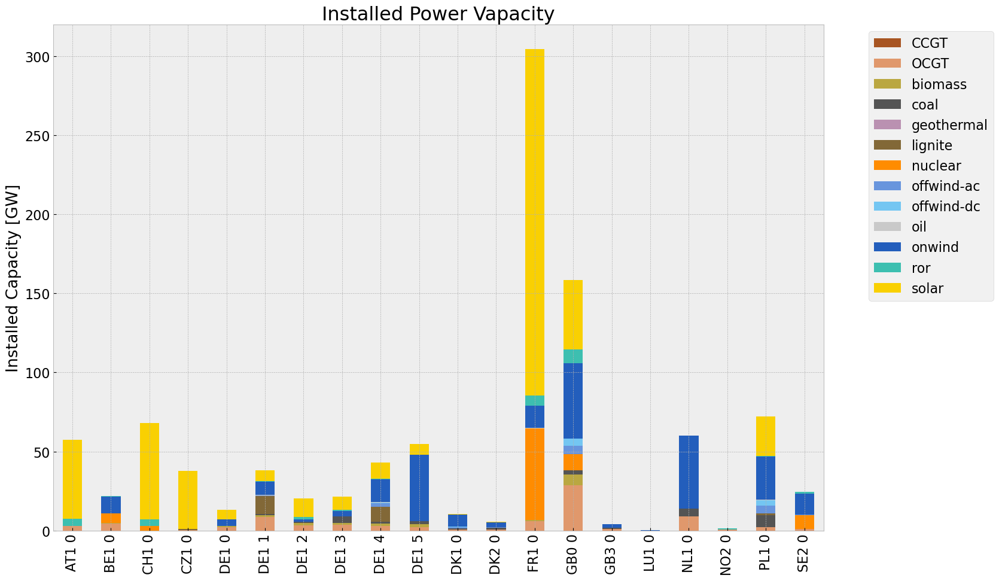

<Figure size 640x480 with 0 Axes>

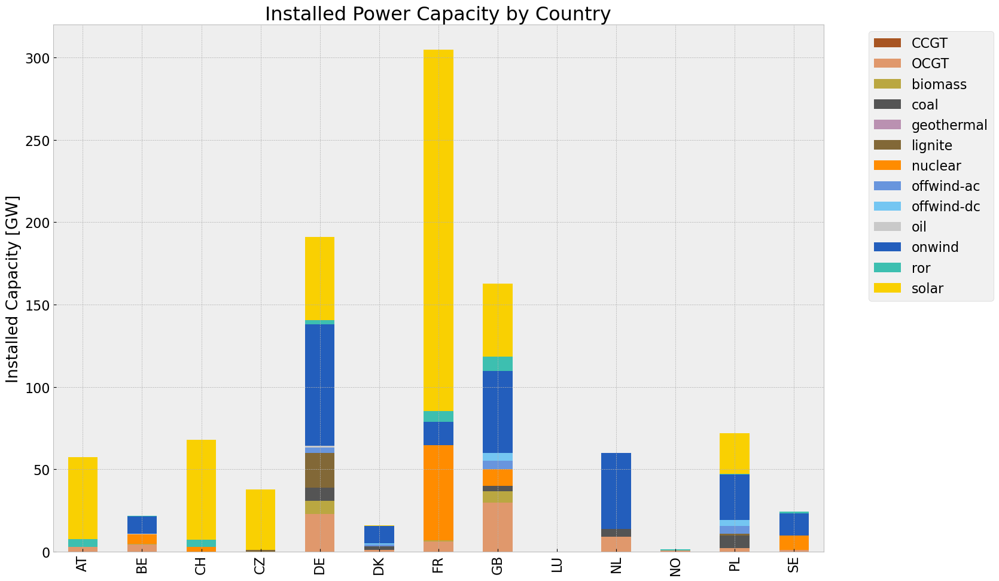

In [233]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

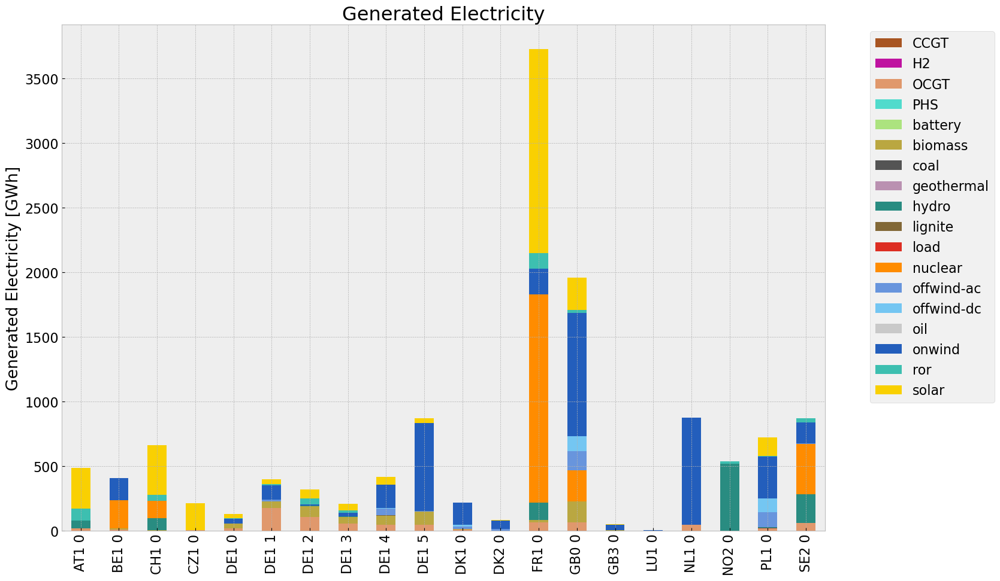

<Figure size 640x480 with 0 Axes>

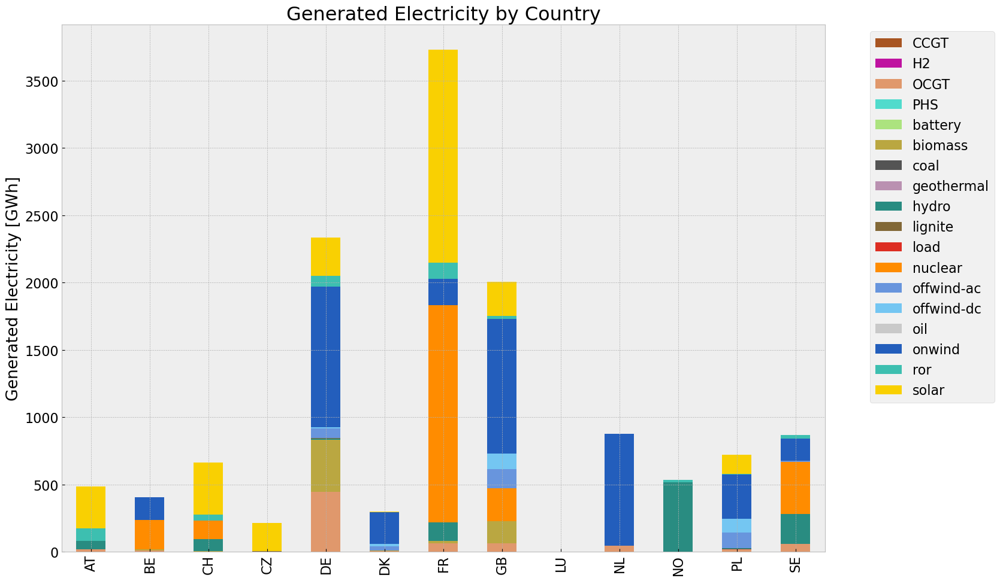

In [234]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2267199707.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2267199707.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

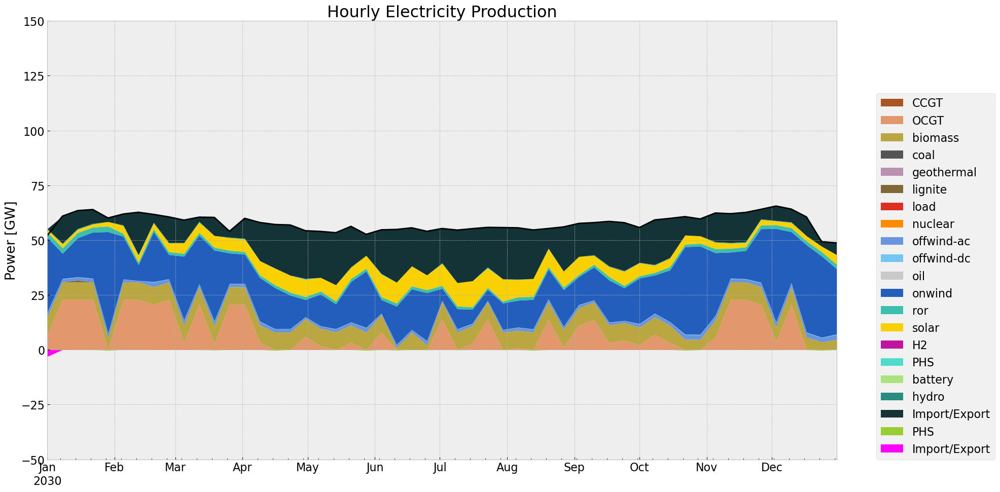

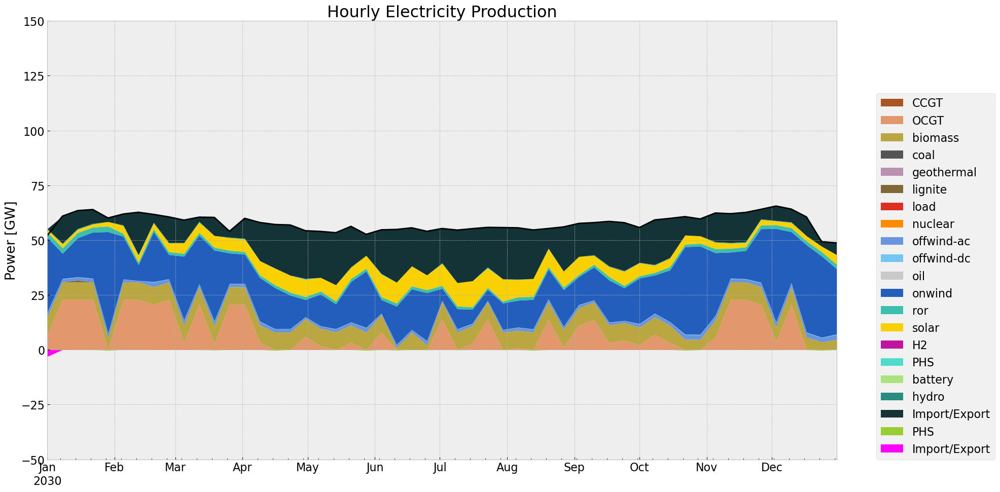

In [235]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

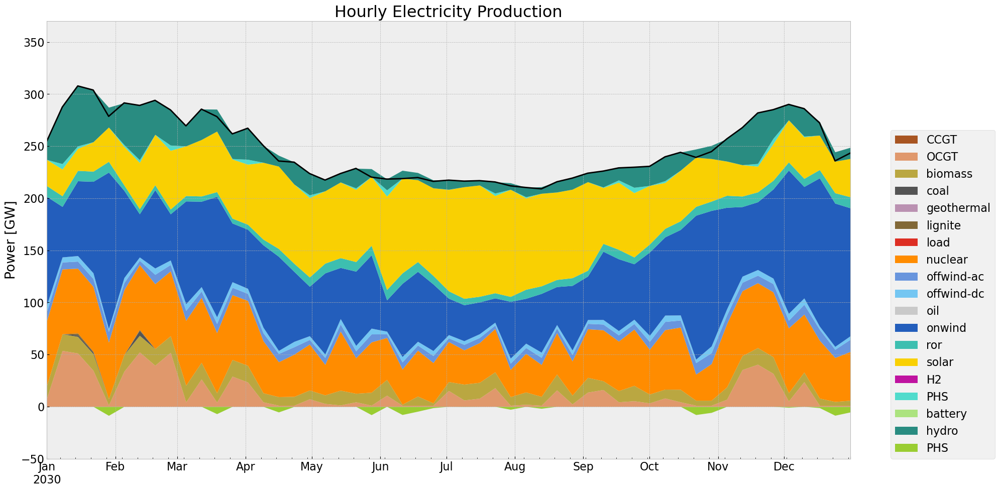

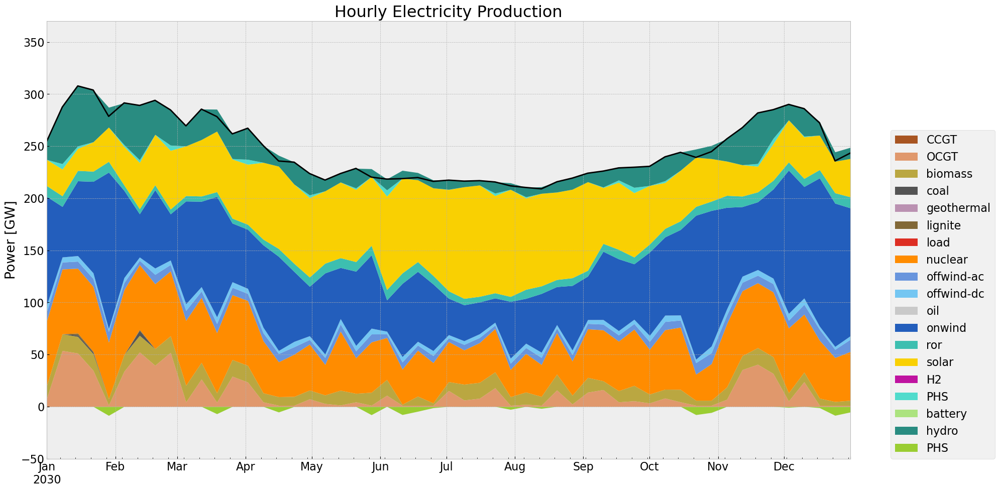

In [236]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

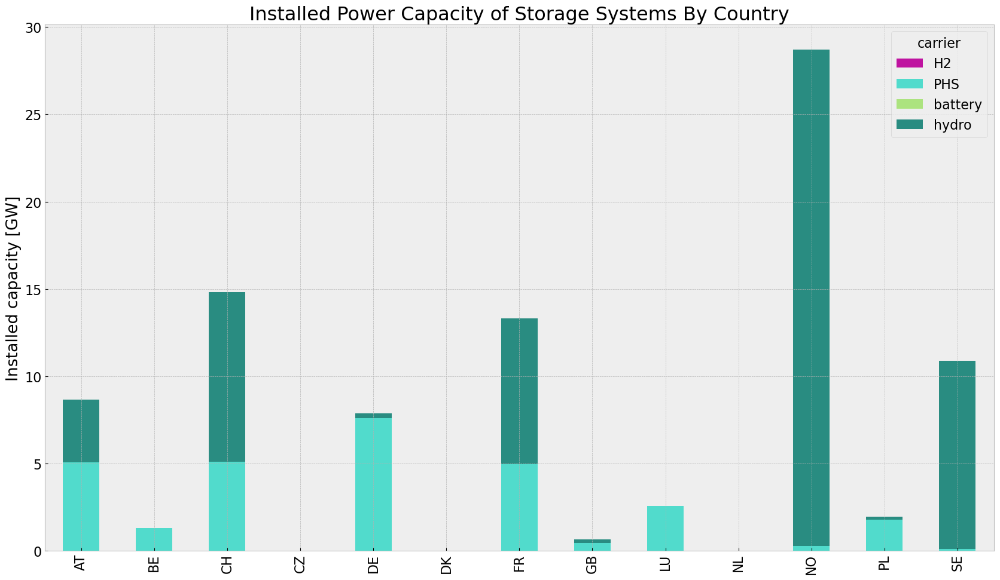

In [237]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, 

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,7.232343e+05,0.451621,0.1980,317081.011474
biomass,5.895134e+05,0.468000,0.0000,0.000000
coal,7.815687e+03,0.329908,0.3361,7962.378130
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.317534e+03,0.337285,0.4069,4002.270487
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.597087e+06,0.326600,0.0000,0.000000
offwind-ac,3.715717e+05,1.000000,0.0000,0.000000


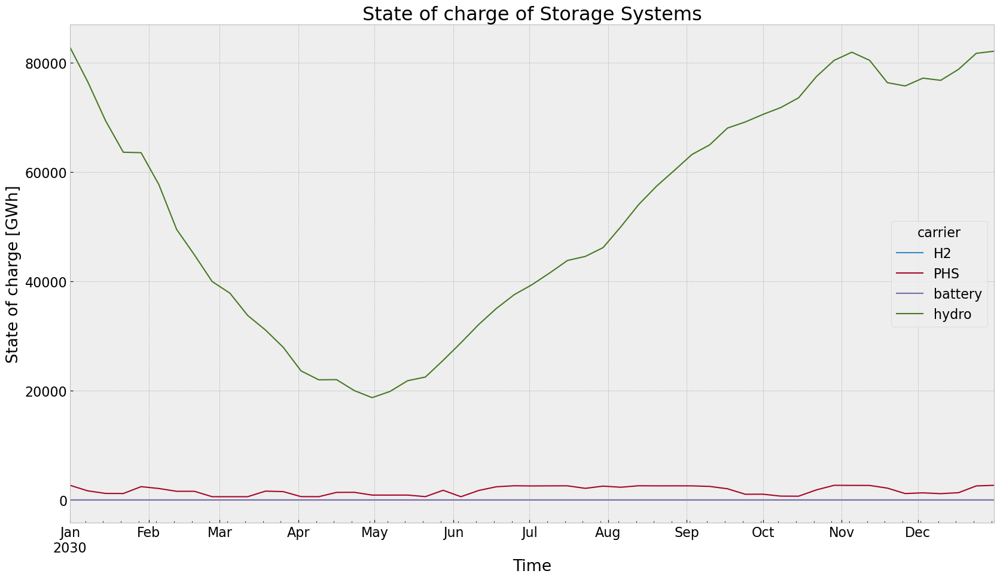

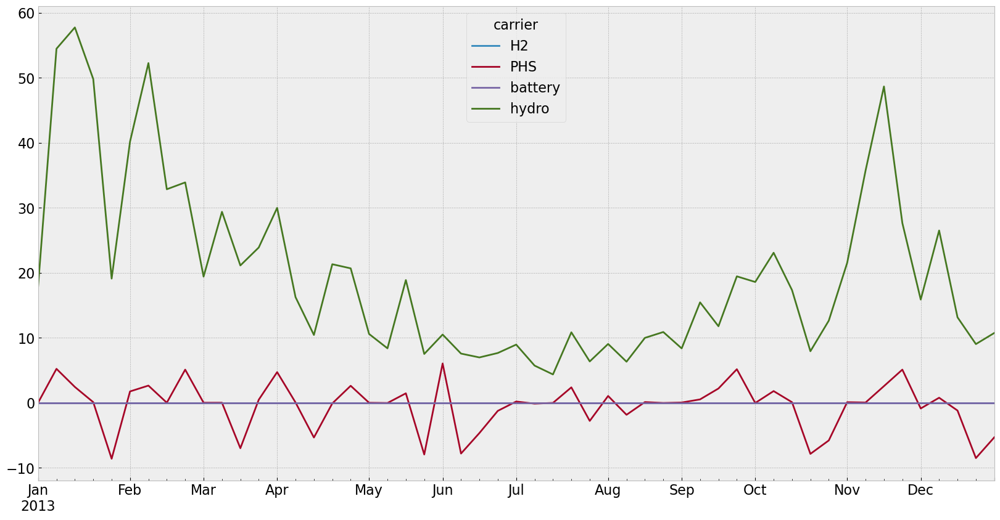

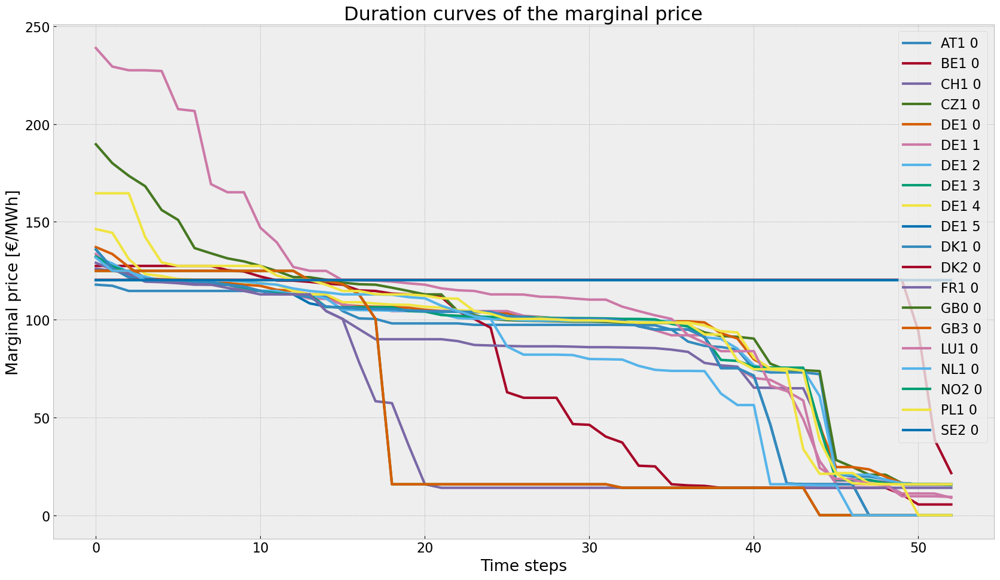

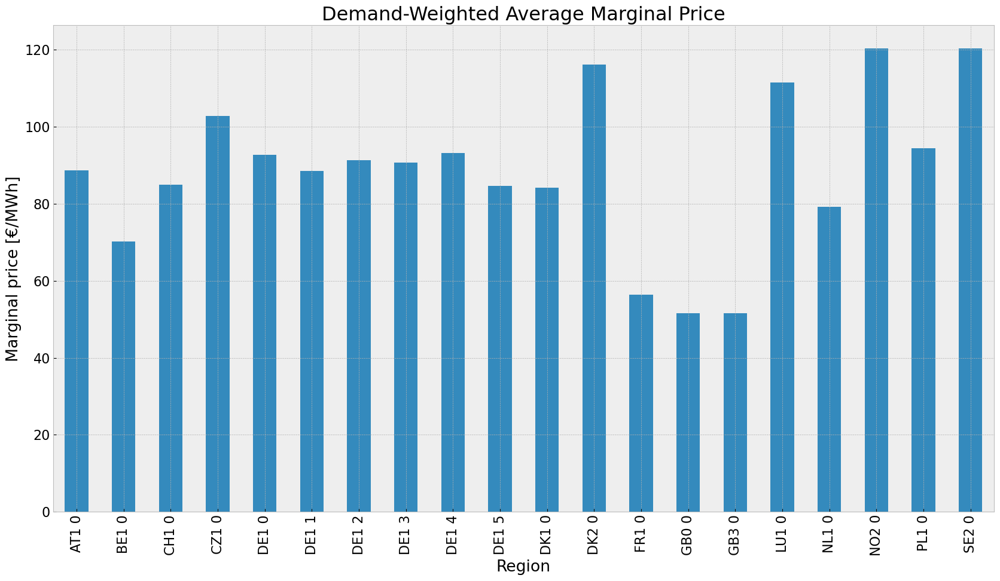

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


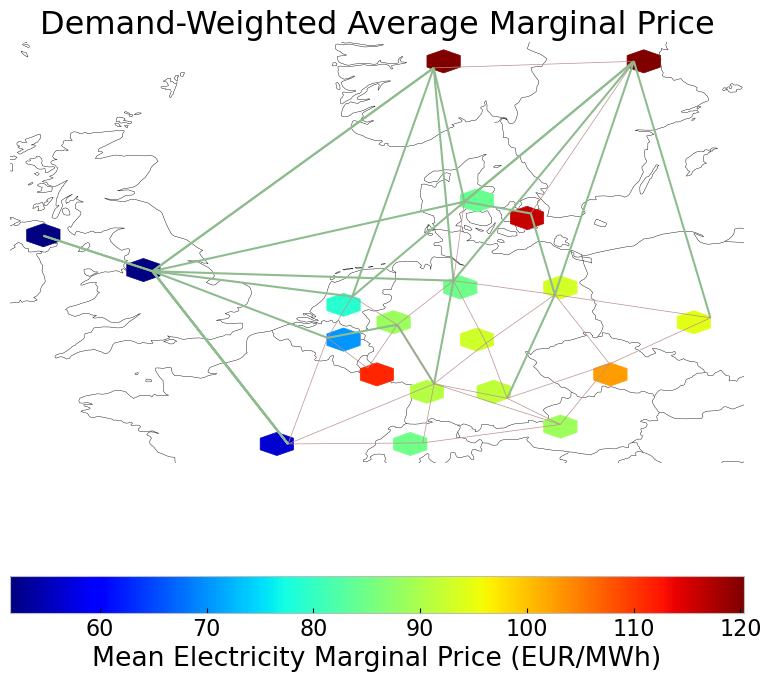

In [238]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [239]:
n3 = droughtscenario(n, cut_start, duration, reductionto)

no_inv(n3,n)
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_p501z7v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_p501z7v.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd7fcfe05


INFO:gurobipy:Model fingerprint: 0xd7fcfe05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1147 columns


INFO:gurobipy:Presolve removed 4248 rows and 1147 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 937 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 224 rows, 937 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9320496e+08   9.022944e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9320496e+08   9.022944e+05   0.000000e+00      0s


     299    1.9176872e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     299    1.9176872e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 299 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 299 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917687160e+10


INFO:gurobipy:Optimal objective  1.917687160e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6ms4af0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6ms4af0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd738b85c


INFO:gurobipy:Model fingerprint: 0xd738b85c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4250 rows and 1170 columns


INFO:gurobipy:Presolve removed 4250 rows and 1170 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 914 columns, 1489 nonzeros


INFO:gurobipy:Presolved: 222 rows, 914 columns, 1489 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7635132e+09   8.356354e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7635132e+09   8.356354e+05   0.000000e+00      0s


     315    3.1280322e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     315    3.1280322e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 315 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 315 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.128032163e+10


INFO:gurobipy:Optimal objective  3.128032163e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.13e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_cmnl2q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_cmnl2q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x266aa4b1


INFO:gurobipy:Model fingerprint: 0x266aa4b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4252 rows and 1179 columns


INFO:gurobipy:Presolve removed 4252 rows and 1179 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 220 rows, 905 columns, 1468 nonzeros


INFO:gurobipy:Presolved: 220 rows, 905 columns, 1468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4621322e+09   8.328083e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4621322e+09   8.328083e+05   0.000000e+00      0s


     281    3.1592040e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     281    3.1592040e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 281 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 281 iterations and 0.08 seconds (0.01 work units)


Optimal objective  3.159204017e+10


INFO:gurobipy:Optimal objective  3.159204017e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayyw6n64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayyw6n64.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x67194e05


INFO:gurobipy:Model fingerprint: 0x67194e05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4251 rows and 1167 columns


INFO:gurobipy:Presolve removed 4251 rows and 1167 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 221 rows, 917 columns, 1486 nonzeros


INFO:gurobipy:Presolved: 221 rows, 917 columns, 1486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1742094e+09   9.168864e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1742094e+09   9.168864e+05   0.000000e+00      0s


     301    2.3302201e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    2.3302201e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.330220118e+10


INFO:gurobipy:Optimal objective  2.330220118e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.33e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7vk5sps.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7vk5sps.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb0472913


INFO:gurobipy:Model fingerprint: 0xb0472913


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 7e+03]


INFO:gurobipy:  Bounds range     [3e+00, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4250 rows and 1154 columns


INFO:gurobipy:Presolve removed 4250 rows and 1154 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 222 rows, 930 columns, 1505 nonzeros


INFO:gurobipy:Presolved: 222 rows, 930 columns, 1505 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8742765e+09   9.185889e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8742765e+09   9.185889e+05   0.000000e+00      0s


     302    8.5179009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     302    8.5179009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 302 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 302 iterations and 0.04 seconds (0.01 work units)


Optimal objective  8.517900867e+09


INFO:gurobipy:Optimal objective  8.517900867e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 8.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aiecljhg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aiecljhg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6ff8c1d8


INFO:gurobipy:Model fingerprint: 0x6ff8c1d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1144 columns


INFO:gurobipy:Presolve removed 4248 rows and 1144 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 940 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 224 rows, 940 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1661778e+07   9.187976e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1661778e+07   9.187976e+05   0.000000e+00      0s


     308    3.7598975e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     308    3.7598975e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 308 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 308 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.759897452e+08


INFO:gurobipy:Optimal objective  3.759897452e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2b7ccdc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2b7ccdc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3b46a30d


INFO:gurobipy:Model fingerprint: 0x3b46a30d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 224 rows, 945 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6028055e+07   9.125535e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6028055e+07   9.125535e+05   0.000000e+00      0s


     400    3.7725203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     400    3.7725203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 400 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 400 iterations and 0.08 seconds (0.01 work units)


Optimal objective  3.772520293e+08


INFO:gurobipy:Optimal objective  3.772520293e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hh3wp8v2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hh3wp8v2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf25b580f


INFO:gurobipy:Model fingerprint: 0xf25b580f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 945 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1587539e+07   8.989952e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1587539e+07   8.989952e+05   0.000000e+00      0s


     341    6.7334272e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    6.7334272e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.733427225e+08


INFO:gurobipy:Optimal objective  6.733427225e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lb4uycru.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lb4uycru.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x156a28ae


INFO:gurobipy:Model fingerprint: 0x156a28ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1137 columns


INFO:gurobipy:Presolve removed 4248 rows and 1137 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 947 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 947 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1615286e+07   8.982206e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1615286e+07   8.982206e+05   0.000000e+00      0s


     379    3.8622026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     379    3.8622026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 379 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 379 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.862202647e+08


INFO:gurobipy:Optimal objective  3.862202647e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j6ac5ey_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j6ac5ey_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x4f17e84f


INFO:gurobipy:Model fingerprint: 0x4f17e84f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1142 columns


INFO:gurobipy:Presolve removed 4248 rows and 1142 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 942 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 942 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6013515e+07   9.006435e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6013515e+07   9.006435e+05   0.000000e+00      0s


     292    7.0792578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    7.0792578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.079257814e+08


INFO:gurobipy:Optimal objective  7.079257814e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tvvf5a5l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tvvf5a5l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x30ef51a9


INFO:gurobipy:Model fingerprint: 0x30ef51a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1136 columns


INFO:gurobipy:Presolve removed 4248 rows and 1136 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 948 columns, 1535 nonzeros


INFO:gurobipy:Presolved: 224 rows, 948 columns, 1535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1288144e+05   8.969974e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1288144e+05   8.969974e+05   0.000000e+00      0s


     332    5.0520030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    5.0520030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.052003006e+08


INFO:gurobipy:Optimal objective  5.052003006e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ip1jzop.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ip1jzop.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x399422e4


INFO:gurobipy:Model fingerprint: 0x399422e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1133 columns


INFO:gurobipy:Presolve removed 4248 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 951 columns, 1538 nonzeros


INFO:gurobipy:Presolved: 224 rows, 951 columns, 1538 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2054966e+07   8.642865e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2054966e+07   8.642865e+05   0.000000e+00      0s


     357    3.4146349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     357    3.4146349e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 357 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 357 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.414634854e+09


INFO:gurobipy:Optimal objective  3.414634854e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0kkxa_n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0kkxa_n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe2e21a82


INFO:gurobipy:Model fingerprint: 0xe2e21a82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1155 columns


INFO:gurobipy:Presolve removed 4248 rows and 1155 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 929 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 929 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4233708e+05   8.867421e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4233708e+05   8.867421e+05   0.000000e+00      0s


     265    9.0572788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    9.0572788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.05 seconds (0.00 work units)


Optimal objective  9.057278818e+08


INFO:gurobipy:Optimal objective  9.057278818e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tb1wing.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tb1wing.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xfea831f3


INFO:gurobipy:Model fingerprint: 0xfea831f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 314 columns


INFO:gurobipy:Presolve removed 1072 rows and 314 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 207 columns, 325 nonzeros


INFO:gurobipy:Presolved: 46 rows, 207 columns, 325 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2592674e+04   8.611146e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.2592674e+04   8.611146e+04   0.000000e+00      0s


      41    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      41    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 41 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 41 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.965476552e+06


INFO:gurobipy:Optimal objective  9.965476552e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [240]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_drought.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


<xarray.Dataset> Size: 275kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      loads_i: 20,
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20,
                                                      generators_i: 261,
                                                      ...
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20,
                                                      links_i: 28,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      global_constraints_i: 1)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * loads_i                                          (loads_i) object 160B 'A...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
  * generators_i                                     (generators_i) object 2kB ...
    ...                                               ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
Data variables: (12/99)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    links_t_p0                                       (snapshots, links_t_p0_i) float64 5kB ...
    links_t_p1                                       (snapshots, links_t_p1_i) float64 5kB ...
    global_constraints_type                          (global_constraints_i) object 8B ...
    global_constraints_carrier_attribute             (global_constraints_i) object 8B ...
    global_constraints_sense                         (global_constraints_i) object 8B ...
    global_constraints_constant                      (global_constraints_i) float64 8B ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_drought
    network_objective:       9965476.55201545
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [241]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

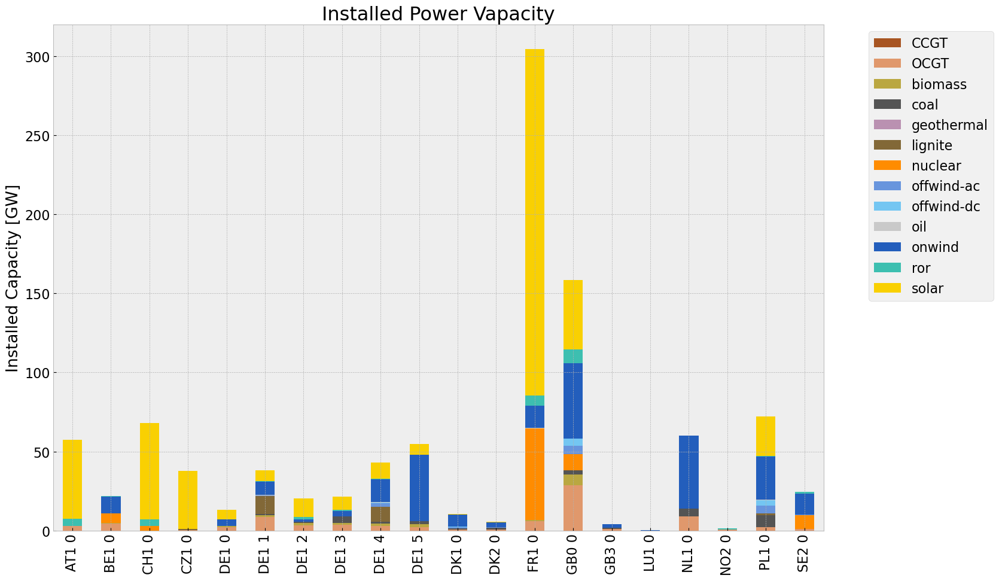

<Figure size 640x480 with 0 Axes>

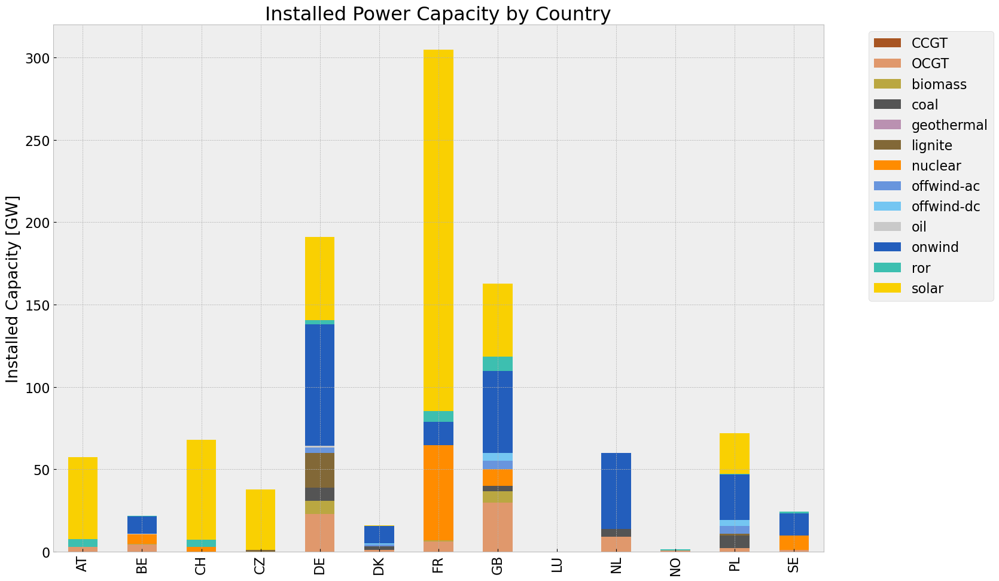

<Figure size 640x480 with 0 Axes>

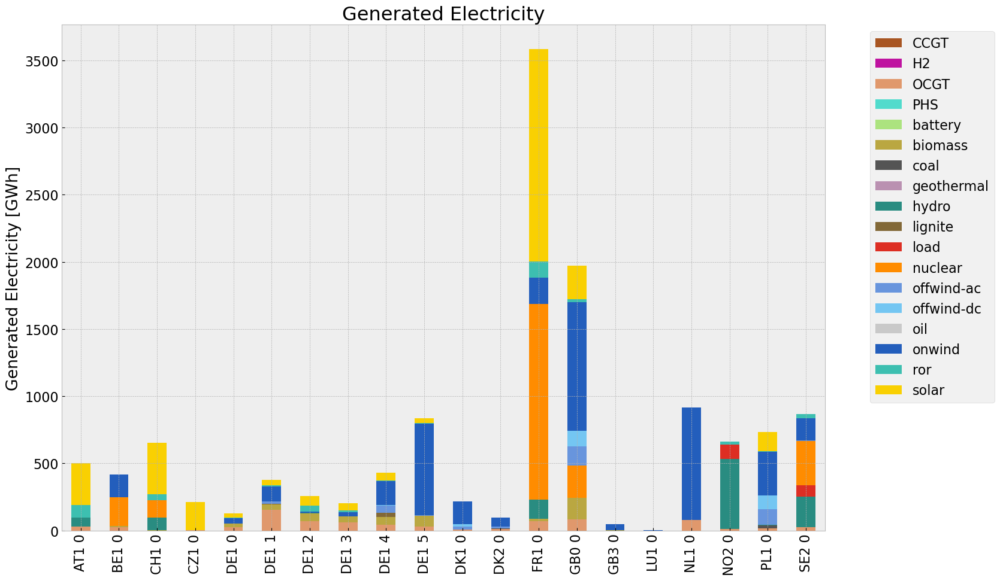

<Figure size 640x480 with 0 Axes>

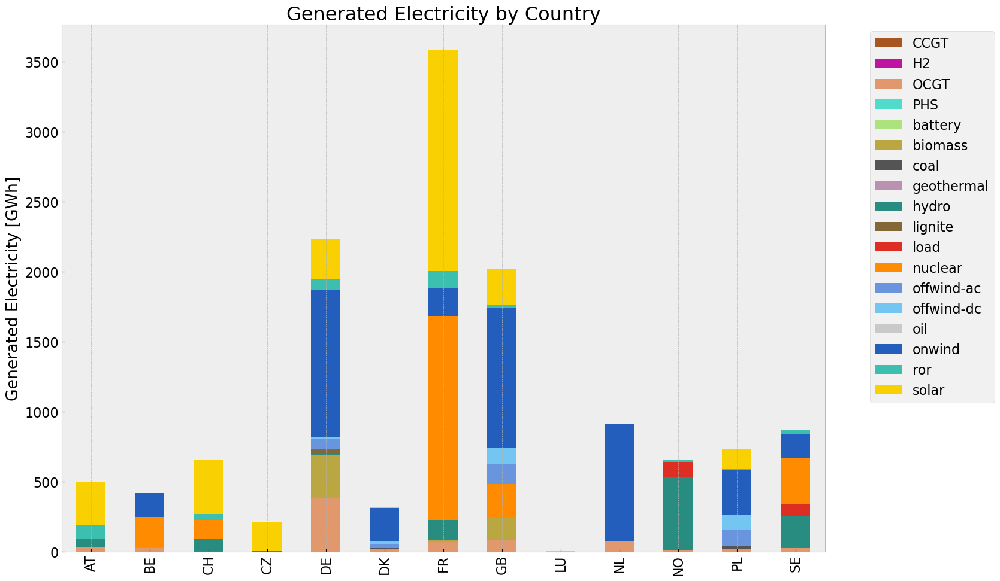

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,7.478167e+05,0.451621,0.1980,327858.442952
biomass,4.933131e+05,0.468000,0.0000,0.000000
coal,2.798843e+04,0.329908,0.3361,28513.740023
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,4.154496e+04,0.337285,0.4069,50119.806712
load,1.951938e+05,1.000000,0.0000,0.000000
nuclear,2.373266e+06,0.326600,0.0000,0.000000
offwind-ac,3.720971e+05,1.000000,0.0000,0.000000


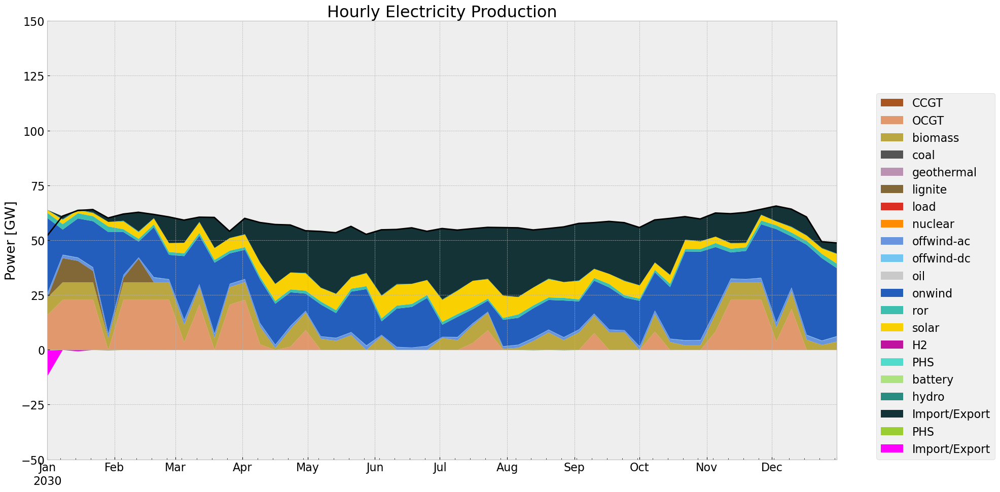

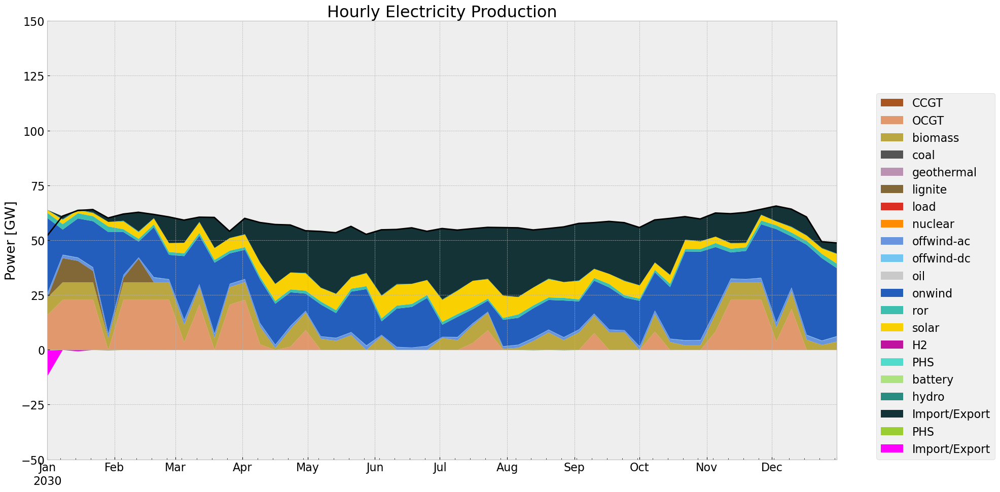

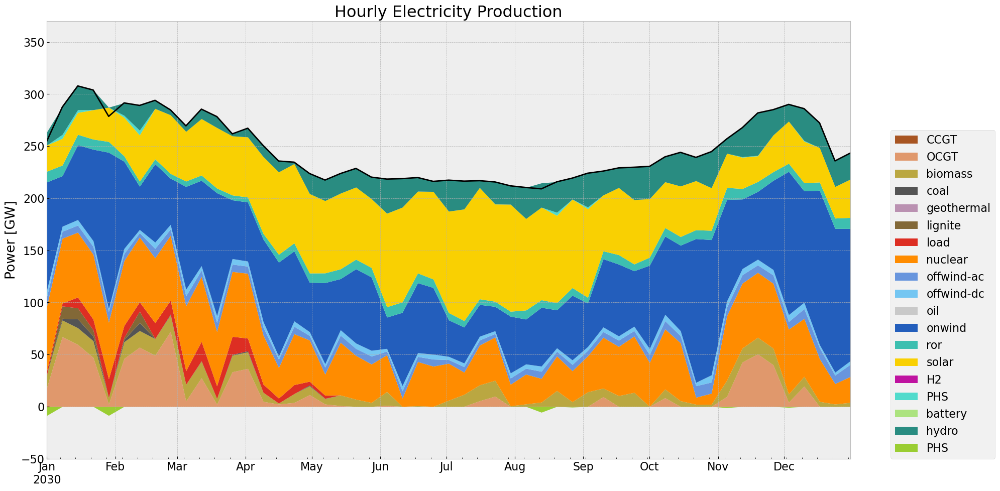

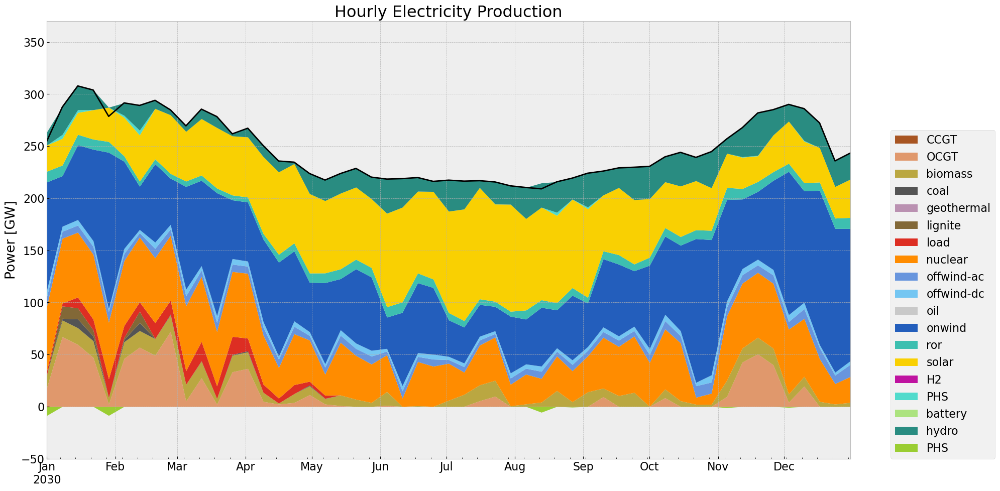

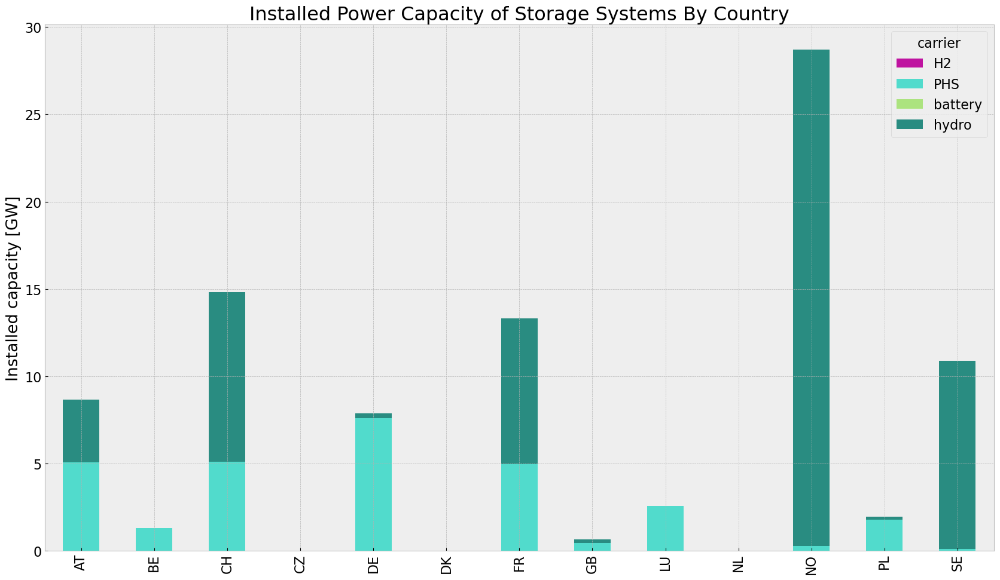

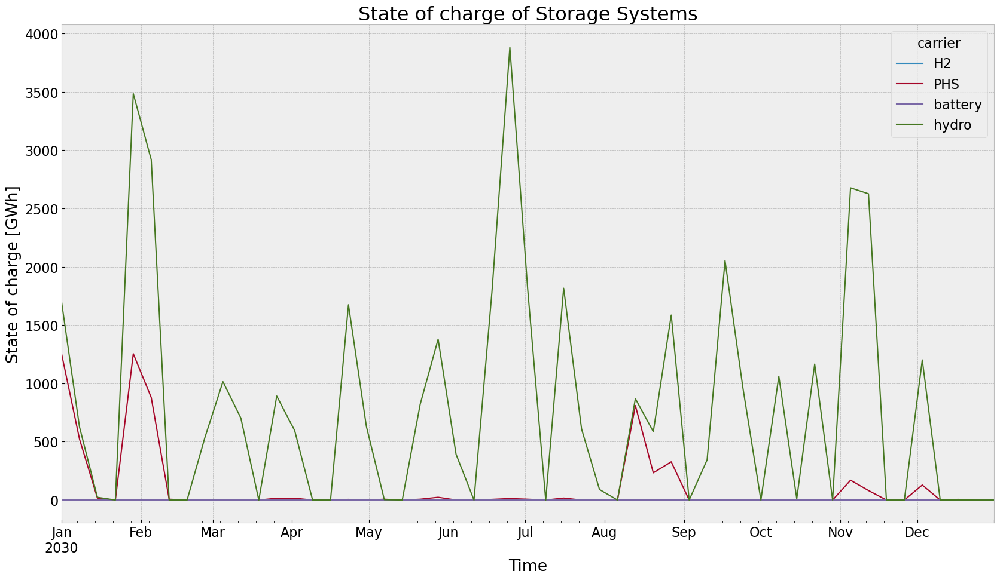

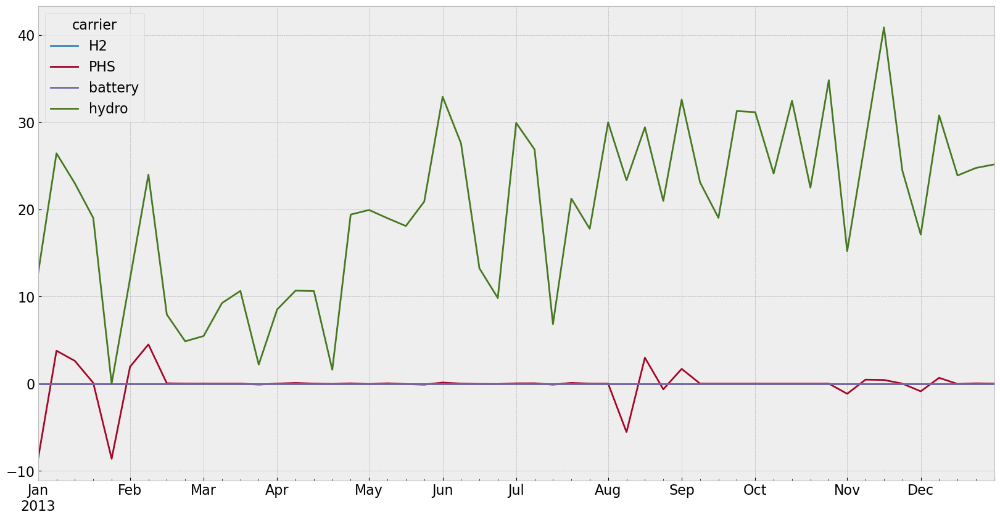

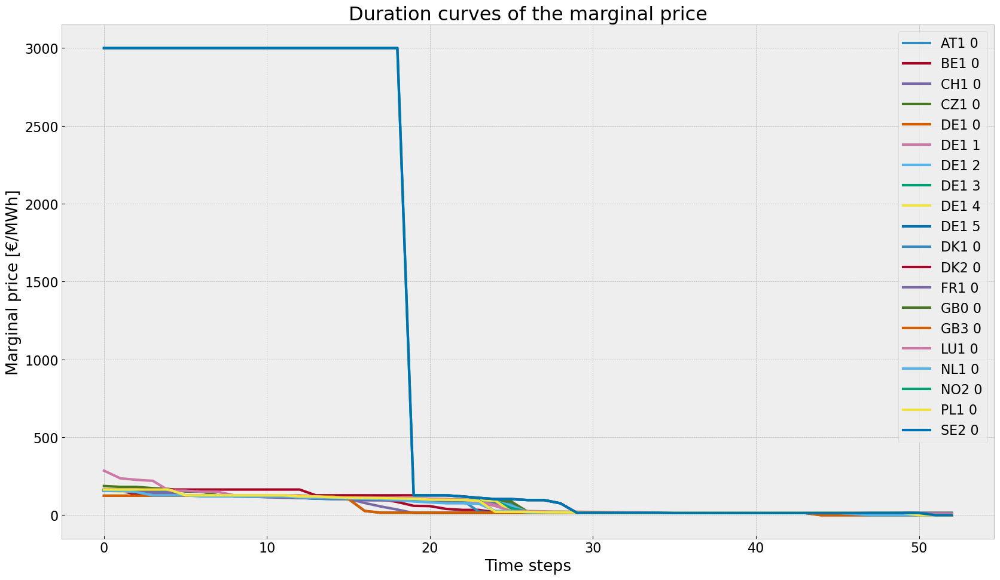

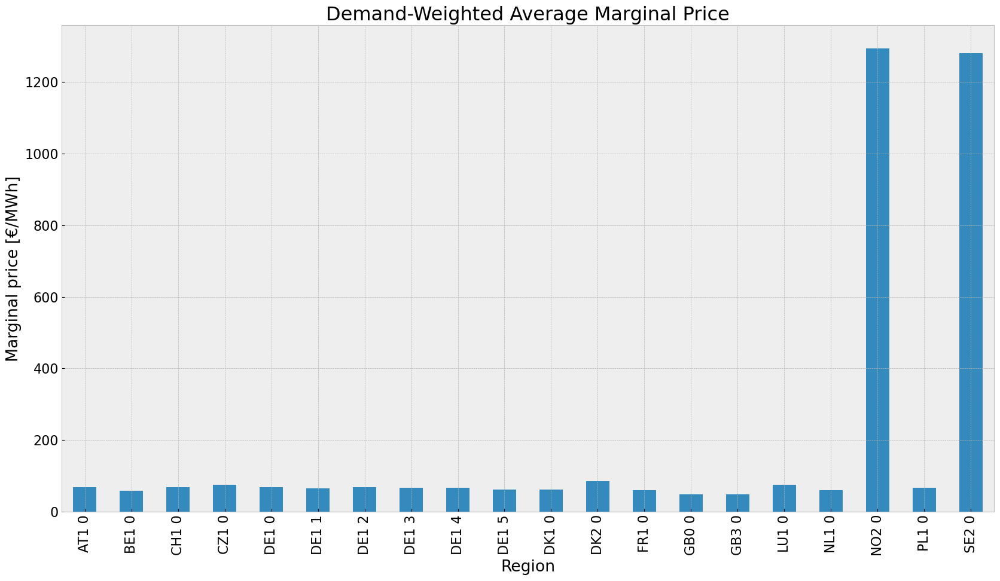

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


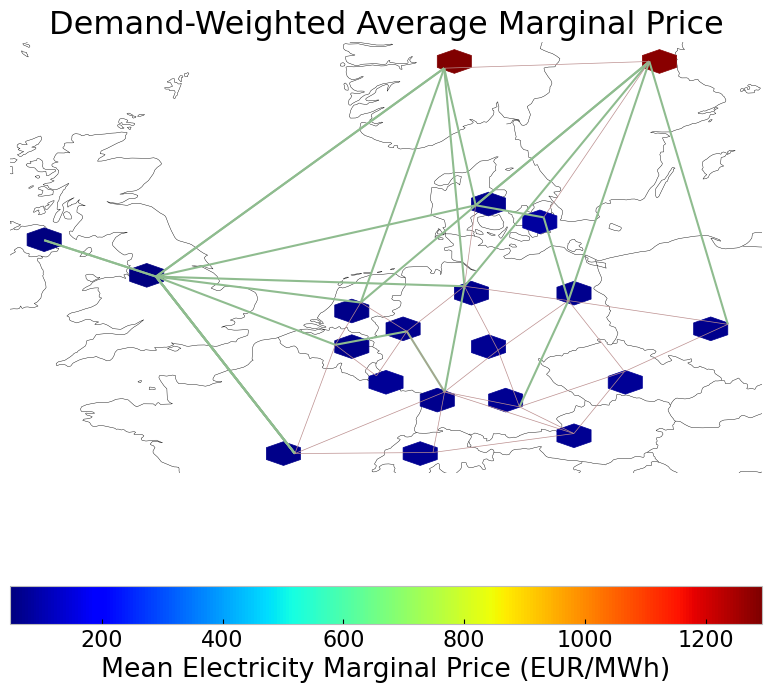

In [242]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [243]:
n4 = n1.copy()

horizon = 3

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b397if67.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b397if67.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6a9f7a0


INFO:gurobipy:Model fingerprint: 0xc6a9f7a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0908817e+08   7.727296e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0908817e+08   7.727296e+05   0.000000e+00      0s


     225    3.9146177e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.9146177e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.914617696e+09


INFO:gurobipy:Optimal objective  3.914617696e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qhuhnqng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qhuhnqng.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x222cdcb1


INFO:gurobipy:Model fingerprint: 0x222cdcb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7459291e+05   7.593433e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7459291e+05   7.593433e+05   0.000000e+00      0s


     206    3.3365962e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.3365962e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.336596202e+09


INFO:gurobipy:Optimal objective  3.336596202e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckldskv3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckldskv3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd5a18a0e


INFO:gurobipy:Model fingerprint: 0xd5a18a0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1442145e+09   7.441836e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1442145e+09   7.441836e+05   0.000000e+00      0s


     230    1.1127286e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.1127286e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.112728561e+10


INFO:gurobipy:Optimal objective  1.112728561e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7oylq29d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7oylq29d.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa6cabbc2


INFO:gurobipy:Model fingerprint: 0xa6cabbc2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 855 columns


INFO:gurobipy:Presolve removed 3187 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 708 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 167 rows, 708 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8013585e+08   7.279033e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8013585e+08   7.279033e+05   0.000000e+00      0s


     215    9.3370808e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    9.3370808e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.337080811e+09


INFO:gurobipy:Optimal objective  9.337080811e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8b8li_3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8b8li_3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62418aa1


INFO:gurobipy:Model fingerprint: 0x62418aa1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1547939e+07   7.795282e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1547939e+07   7.795282e+05   0.000000e+00      0s


     220    5.6066494e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    5.6066494e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.606649430e+09


INFO:gurobipy:Optimal objective  5.606649430e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcqfpmc3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcqfpmc3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9f5bc09f


INFO:gurobipy:Model fingerprint: 0x9f5bc09f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6149426e+04   7.843094e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6149426e+04   7.843094e+05   0.000000e+00      0s


     231    3.5828446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    3.5828446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.582844627e+08


INFO:gurobipy:Optimal objective  3.582844627e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fv24dt2u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fv24dt2u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8755642f


INFO:gurobipy:Model fingerprint: 0x8755642f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8515707e+04   7.875175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8515707e+04   7.875175e+05   0.000000e+00      0s


     225    2.9272354e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.9272354e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.927235406e+08


INFO:gurobipy:Optimal objective  2.927235406e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sd885pux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sd885pux.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8810e0da


INFO:gurobipy:Model fingerprint: 0x8810e0da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5754847e+07   7.873245e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5754847e+07   7.873245e+05   0.000000e+00      0s


     204    2.0234635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.0234635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.023463496e+08


INFO:gurobipy:Optimal objective  2.023463496e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fd9drino.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fd9drino.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9f9d5440


INFO:gurobipy:Model fingerprint: 0x9f9d5440


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6347870e+04   7.802394e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6347870e+04   7.802394e+05   0.000000e+00      0s


     244    2.2739694e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.2739694e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.273969390e+08


INFO:gurobipy:Optimal objective  2.273969390e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eaffqrk4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eaffqrk4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2662d992


INFO:gurobipy:Model fingerprint: 0x2662d992


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9014001e+04   7.716672e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9014001e+04   7.716672e+05   0.000000e+00      0s


     240    4.3718695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.3718695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.371869482e+08


INFO:gurobipy:Optimal objective  4.371869482e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-epdop1ym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-epdop1ym.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee65f28b


INFO:gurobipy:Model fingerprint: 0xee65f28b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2394662e+04   7.812597e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2394662e+04   7.812597e+05   0.000000e+00      0s


     228    1.3678664e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    1.3678664e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.367866444e+08


INFO:gurobipy:Optimal objective  1.367866444e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-07dvp61s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-07dvp61s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e8717bd


INFO:gurobipy:Model fingerprint: 0x3e8717bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6323687e+04   7.676727e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6323687e+04   7.676727e+05   0.000000e+00      0s


     236    2.9492519e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    2.9492519e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.949251932e+08


INFO:gurobipy:Optimal objective  2.949251932e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ikno9zxs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ikno9zxs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfa3de040


INFO:gurobipy:Model fingerprint: 0xfa3de040


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1826032e+05   7.605611e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1826032e+05   7.605611e+05   0.000000e+00      0s


     267    4.0230272e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    4.0230272e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.023027212e+08


INFO:gurobipy:Optimal objective  4.023027212e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2iqpes55.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2iqpes55.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x143f34cc


INFO:gurobipy:Model fingerprint: 0x143f34cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 727 columns, 1173 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1173 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5139552e+04   7.657021e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5139552e+04   7.657021e+05   0.000000e+00      0s


     227    3.7784705e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    3.7784705e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.778470453e+08


INFO:gurobipy:Optimal objective  3.778470453e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpkb_oql.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpkb_oql.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63a82501


INFO:gurobipy:Model fingerprint: 0x63a82501


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1642276e+05   7.644841e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1642276e+05   7.644841e+05   0.000000e+00      0s


     222    1.1110591e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.1110591e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.111059121e+08


INFO:gurobipy:Optimal objective  1.111059121e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70_9w5vu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70_9w5vu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9632a58


INFO:gurobipy:Model fingerprint: 0xa9632a58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7788181e+05   7.448121e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7788181e+05   7.448121e+05   0.000000e+00      0s


     253    2.9555930e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    2.9555930e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.955593034e+09


INFO:gurobipy:Optimal objective  2.955593034e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.96e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zakqnaah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zakqnaah.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7da6a89c


INFO:gurobipy:Model fingerprint: 0x7da6a89c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7158302e+05   7.455361e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7158302e+05   7.455361e+05   0.000000e+00      0s


     229    3.8358025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    3.8358025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.835802496e+08


INFO:gurobipy:Optimal objective  3.835802496e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_cgw4bk2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_cgw4bk2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xdbb5a9bd


INFO:gurobipy:Model fingerprint: 0xdbb5a9bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 579 columns


INFO:gurobipy:Presolve removed 2124 rows and 579 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 463 columns, 752 nonzeros


INFO:gurobipy:Presolved: 112 rows, 463 columns, 752 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6940936e+04   1.585968e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6940936e+04   1.585968e+05   0.000000e+00      0s


     111    3.8953891e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     111    3.8953891e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 111 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 111 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.895389091e+07


INFO:gurobipy:Optimal objective  3.895389091e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [244]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_drought.nc has loads, generators, carriers, lines, storage_units, buses, links


<xarray.Dataset> Size: 281kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      loads_i: 20,
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20,
                                                      generators_i: 261,
                                                      ...
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20,
                                                      links_i: 28,
                                                      links_t_p0_i: 16,
                                                      links_t_p1_i: 16)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * loads_i                                          (loads_i) object 160B 'A...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
  * generators_i                                     (generators_i) object 2kB ...
    ...                                               ...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 128B ...
  * links_t_p1_i                                     (links_t_p1_i) object 128B ...
Data variables: (12/97)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    links_marginal_cost                              (links_i) float64 224B 0...
    links_p_nom_opt                                  (links_i) float64 224B 1...
    links_reversed                                   (links_i) bool 28B False...
    links_p_nom_min                                  (links_i) float64 224B 0...
    links_t_p0                                       (snapshots, links_t_p0_i) float64 7kB ...
    links_t_p1                                       (snapshots, links_t_p1_i) float64 7kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_drought
    network_objective:       38953890.91011031
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [245]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

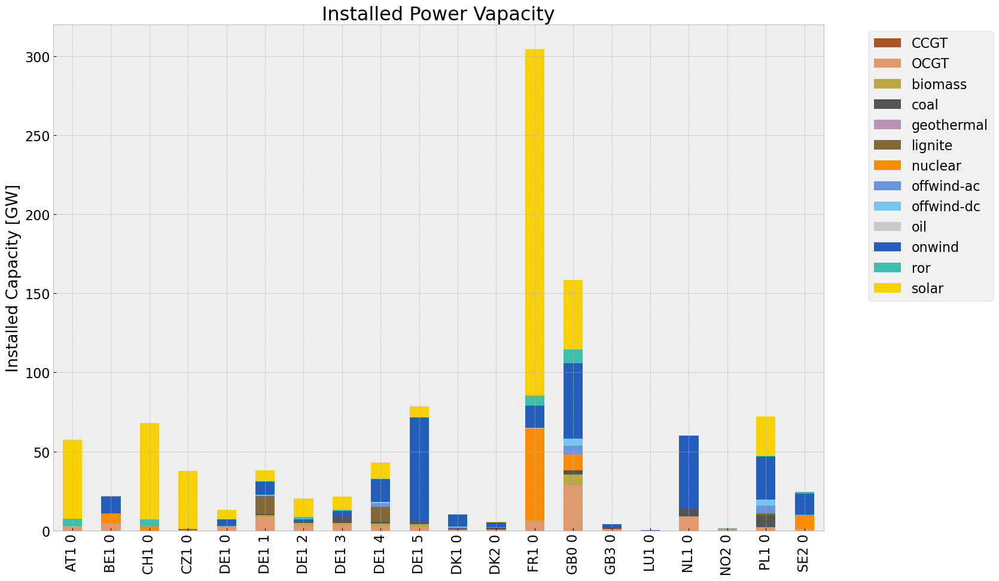

<Figure size 640x480 with 0 Axes>

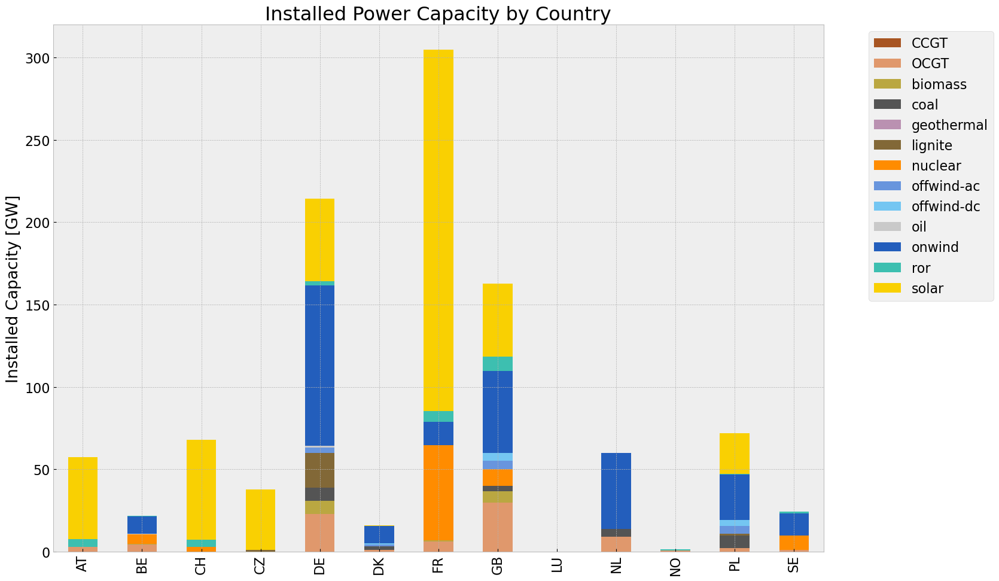

<Figure size 640x480 with 0 Axes>

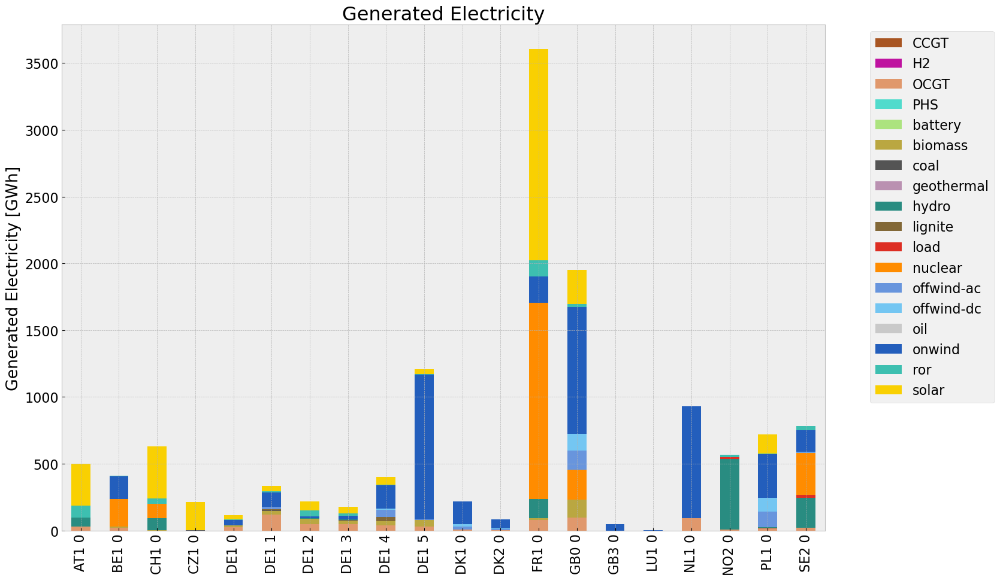

<Figure size 640x480 with 0 Axes>

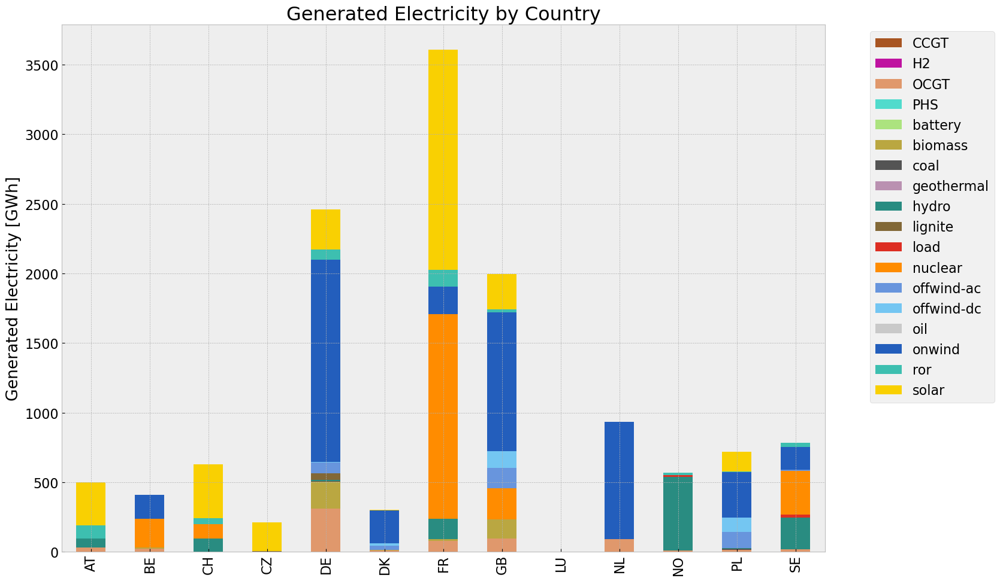

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.815148e+05,0.451621,0.1980,298790.312760
biomass,3.561246e+05,0.468000,0.0000,0.000000
coal,1.288867e+04,0.329908,0.3361,13130.569946
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,4.724895e+04,0.337285,0.4069,57001.085698
load,3.678490e+04,1.000000,0.0000,0.000000
nuclear,2.324879e+06,0.326600,0.0000,0.000000
offwind-ac,3.726011e+05,1.000000,0.0000,0.000000


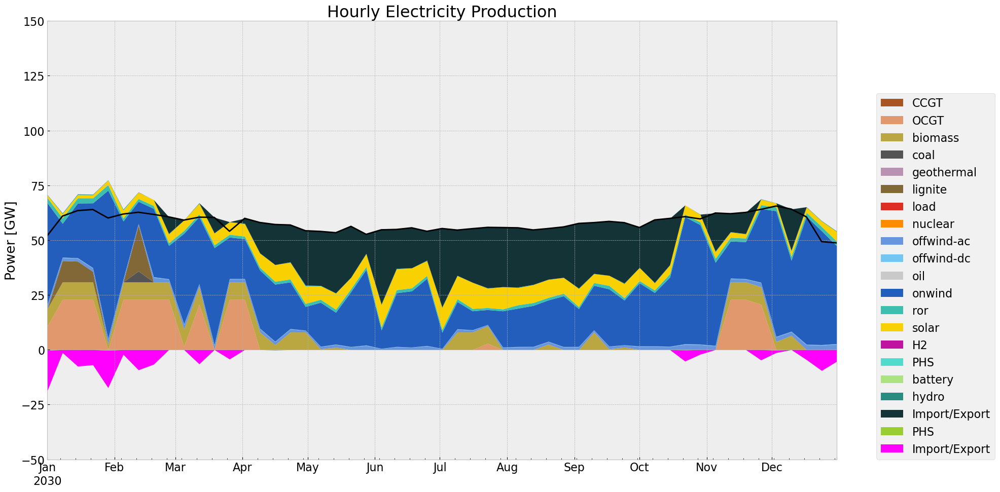

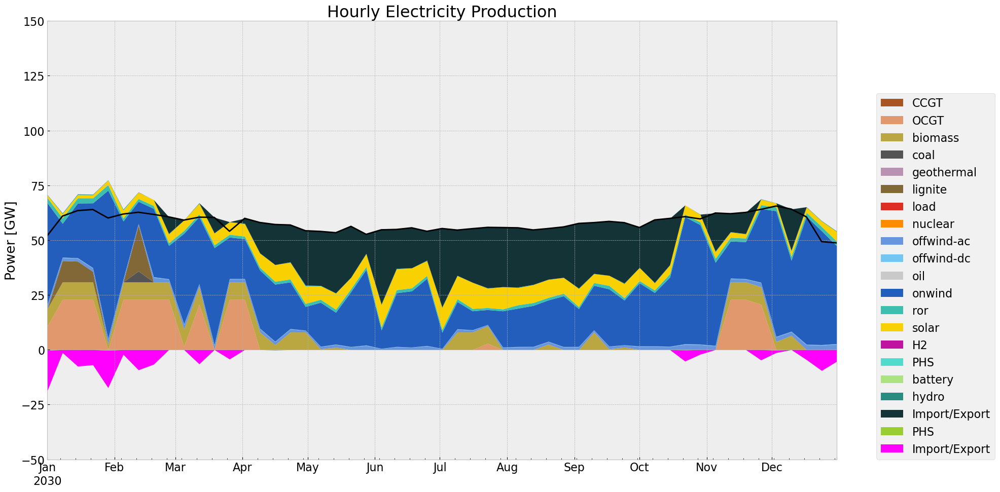

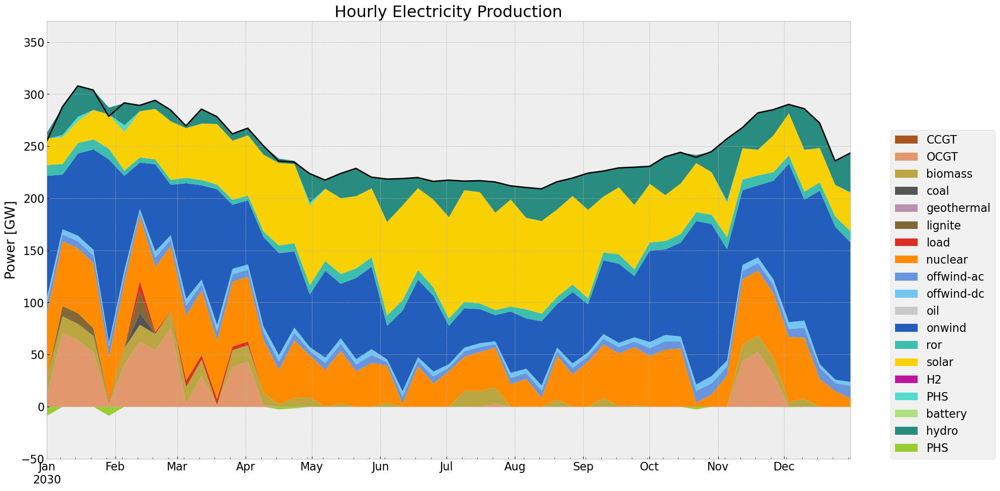

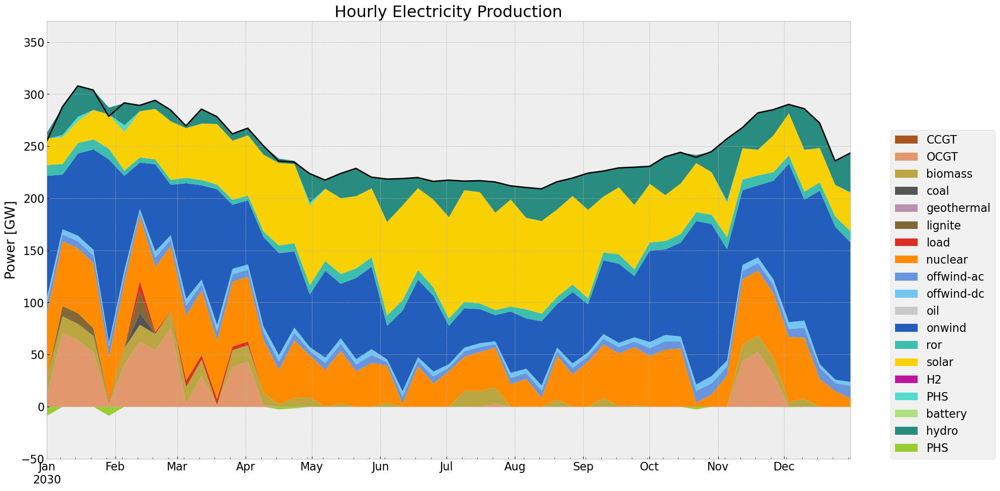

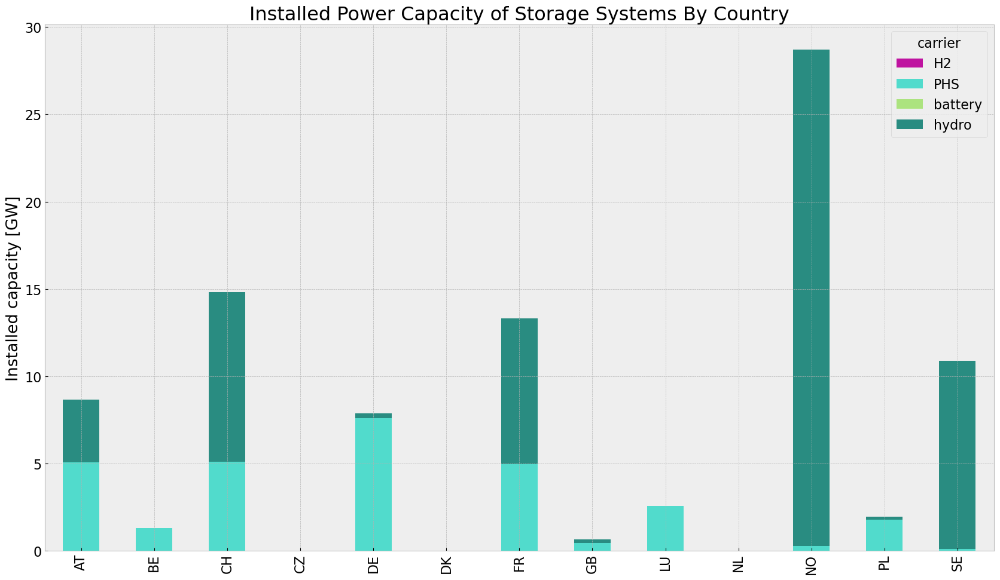

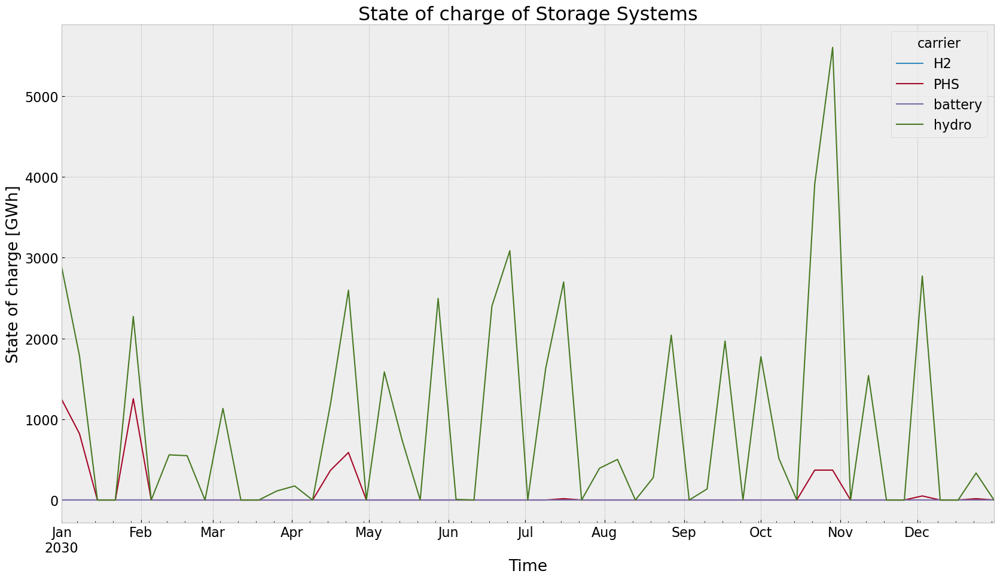

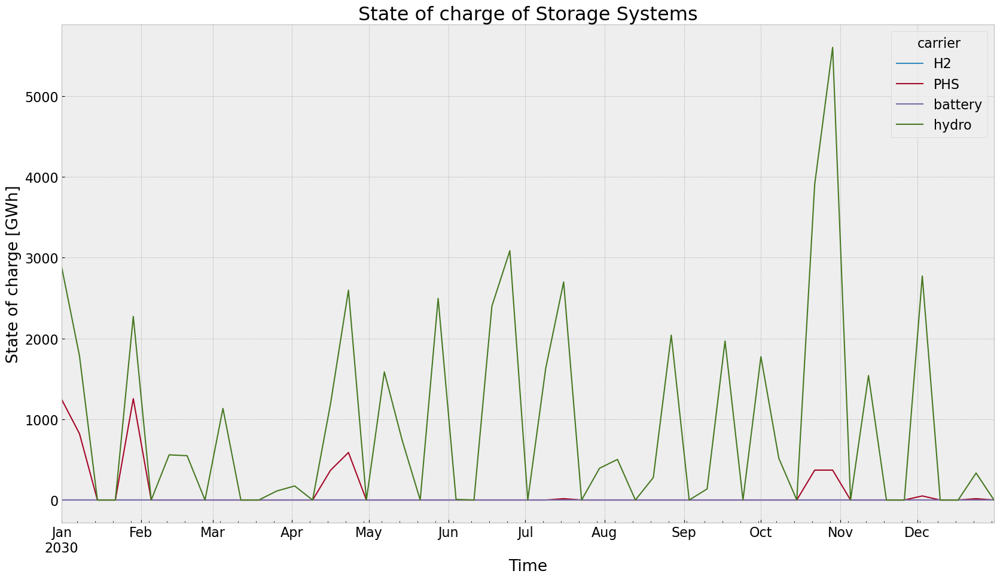

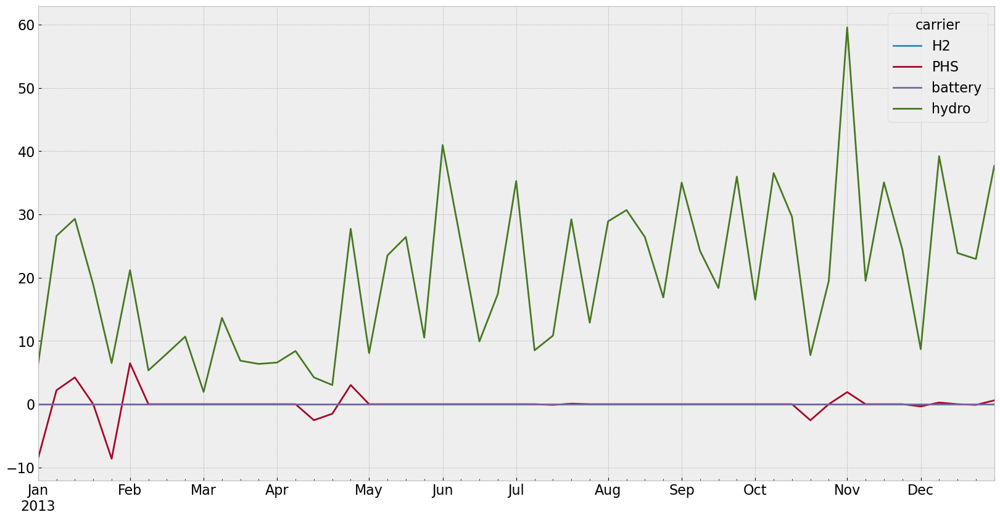

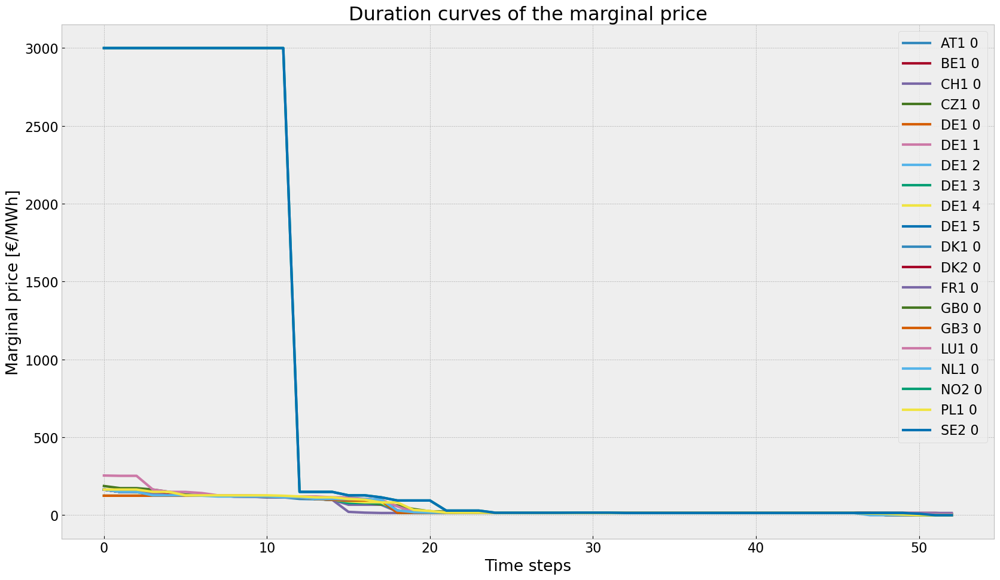

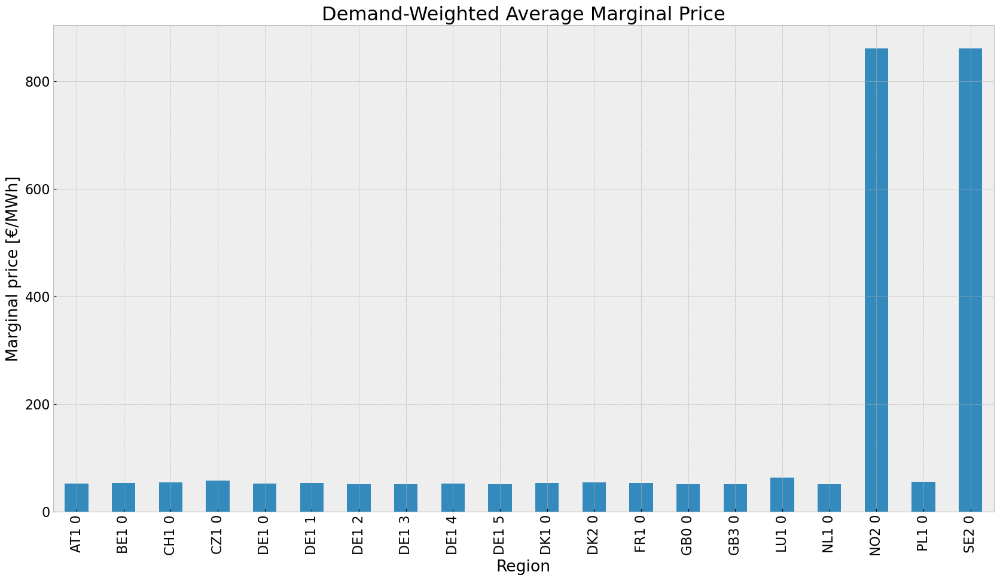

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


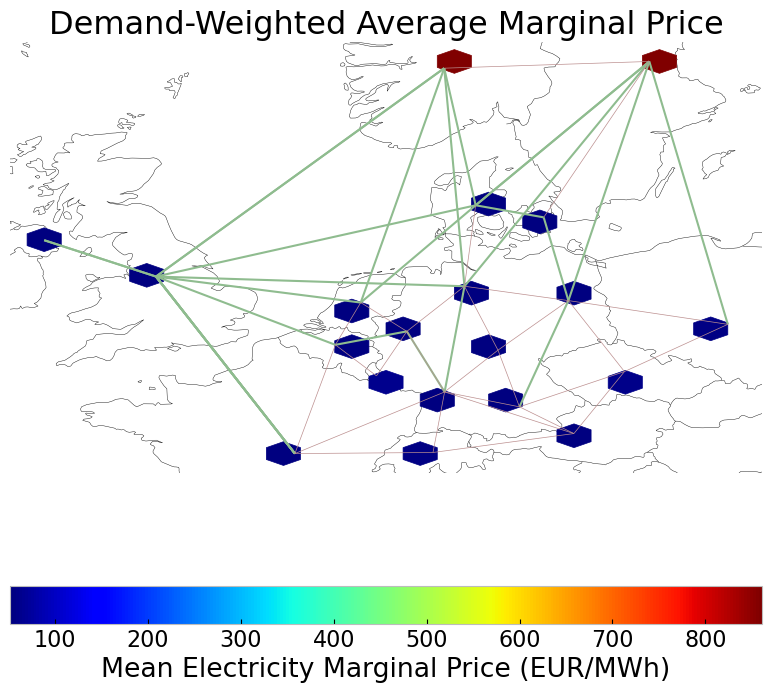

In [246]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [247]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

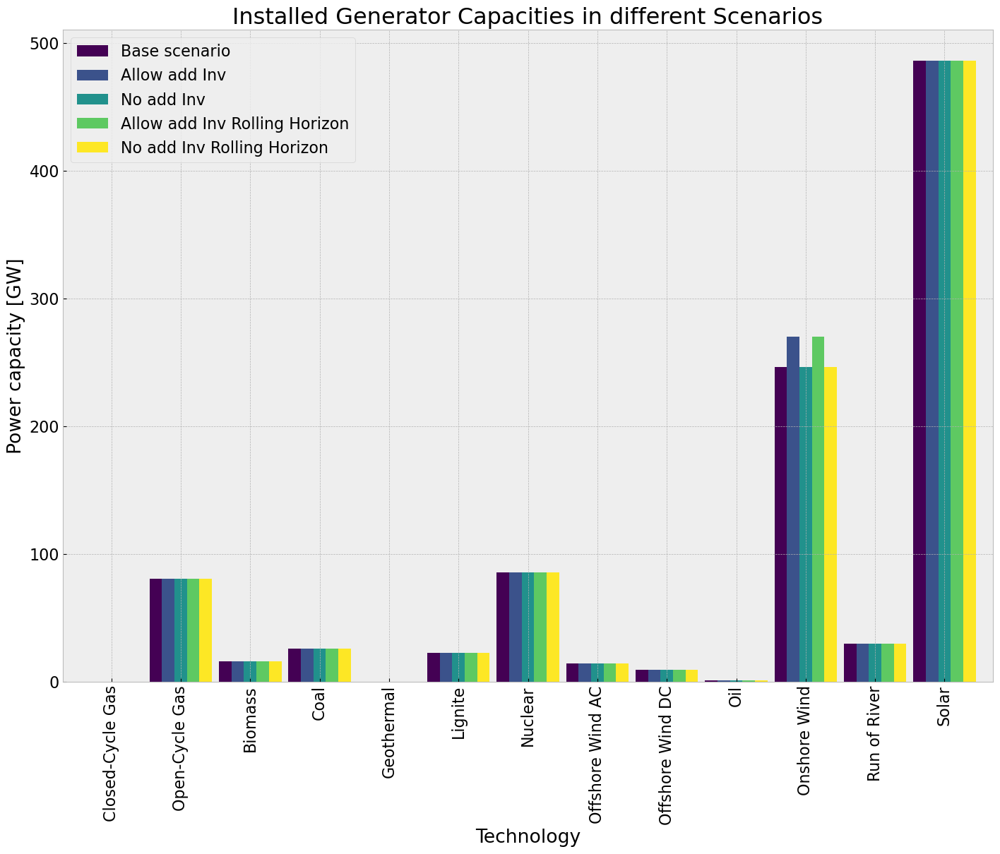

In [248]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'solar': '#f9d002', 'geothermal': '#ba91b1', 'coal': '#545454', 'offwind-ac': '#6895dd', 'onwind': '#235ebc', 'OCGT': '#e0986c', 'nuclear': '#ff8c00', 'lignite': '#826837', 'offwind-dc': '#74c6f2', 'biomass': '#baa741', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


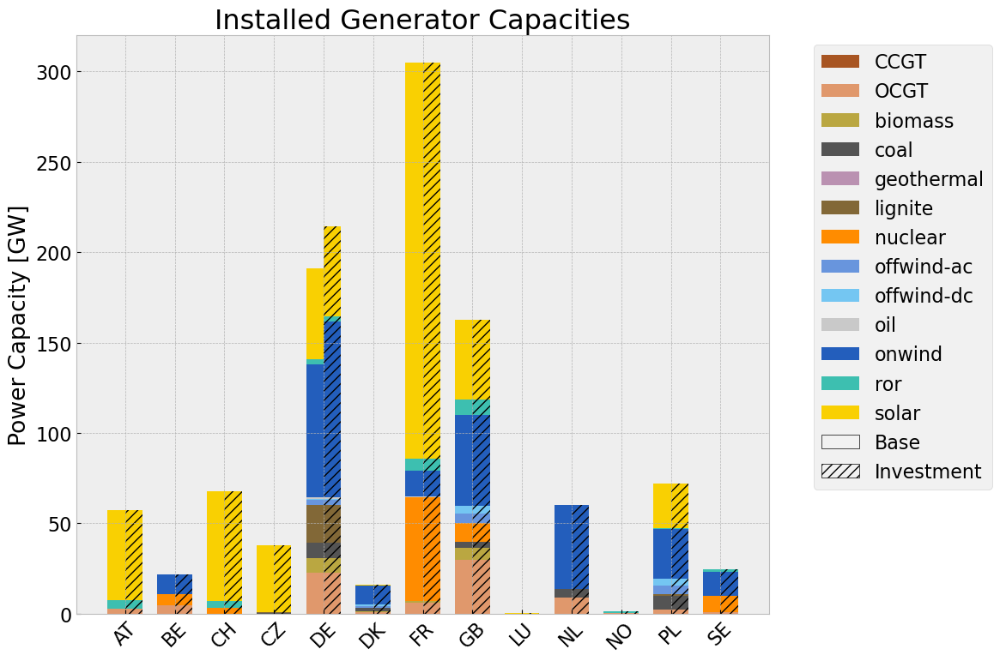

In [249]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2988850123.py:34: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  comp_gen_electr.fillna(0, inplace=True)


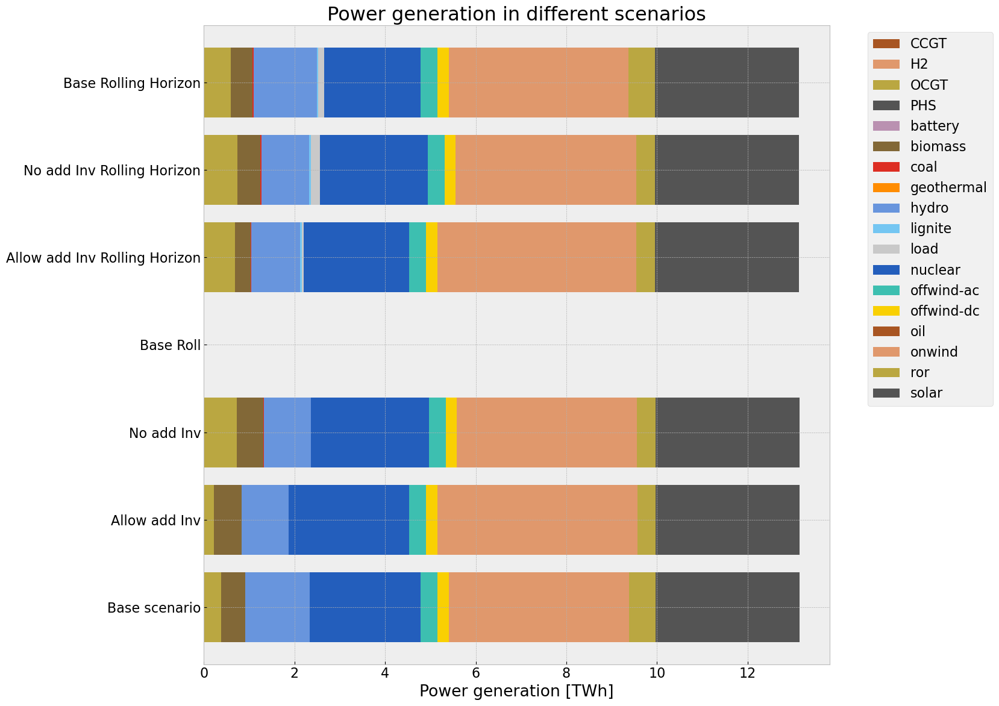

In [250]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Roll","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

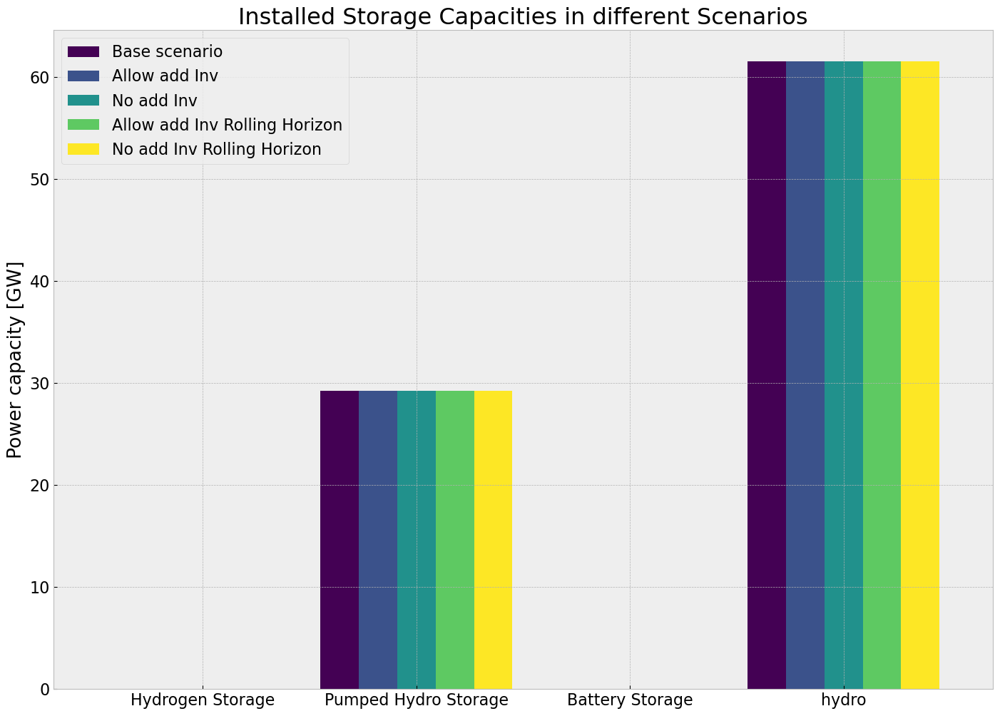

In [251]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

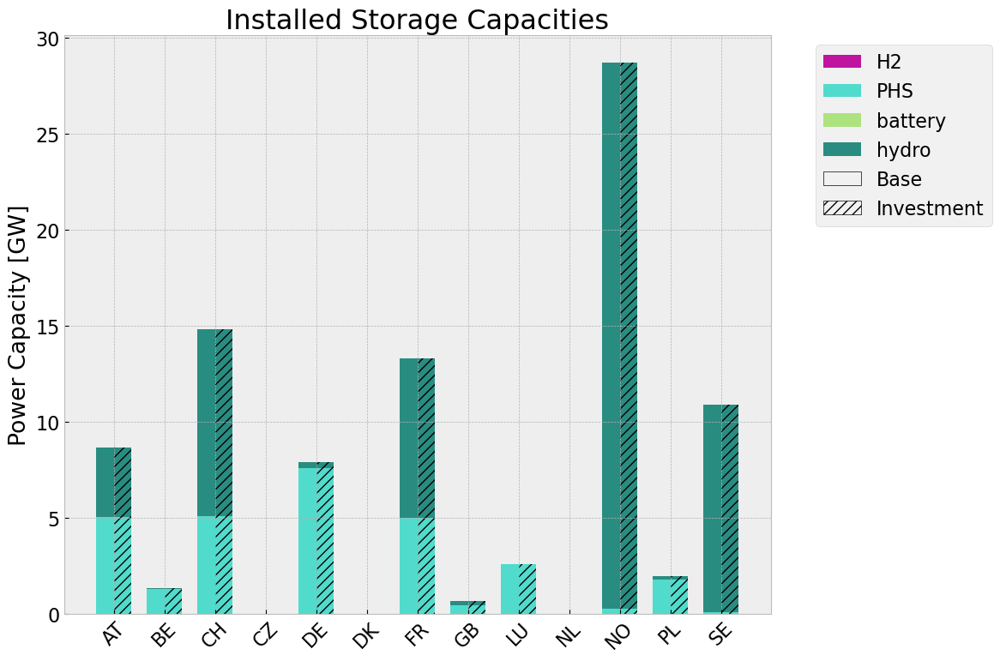

In [252]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [253]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


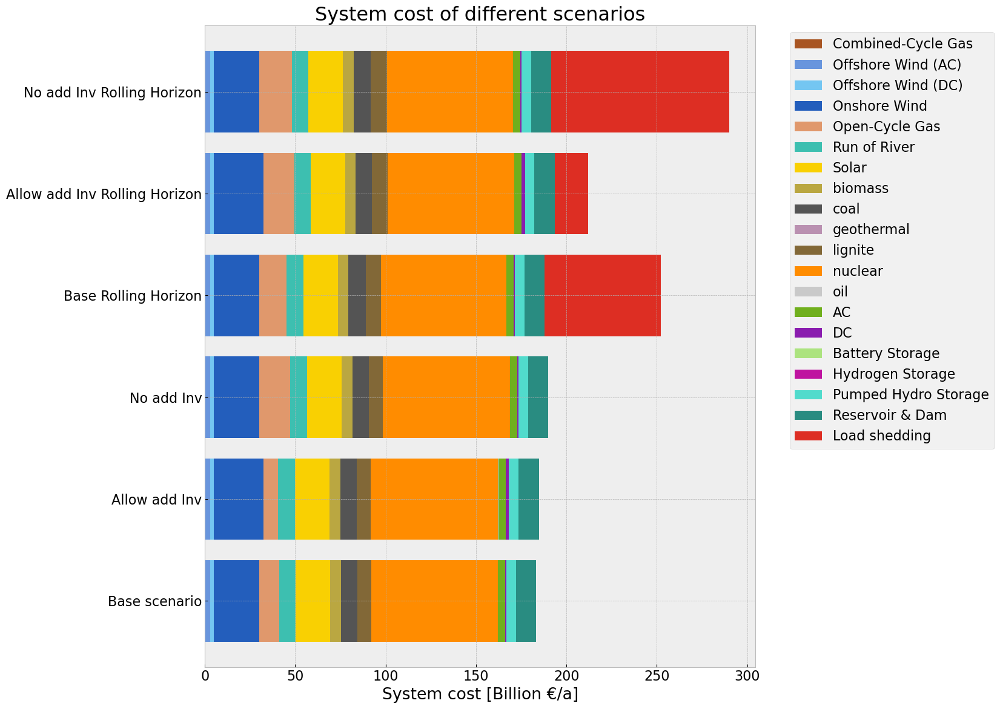

In [254]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [255]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [256]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


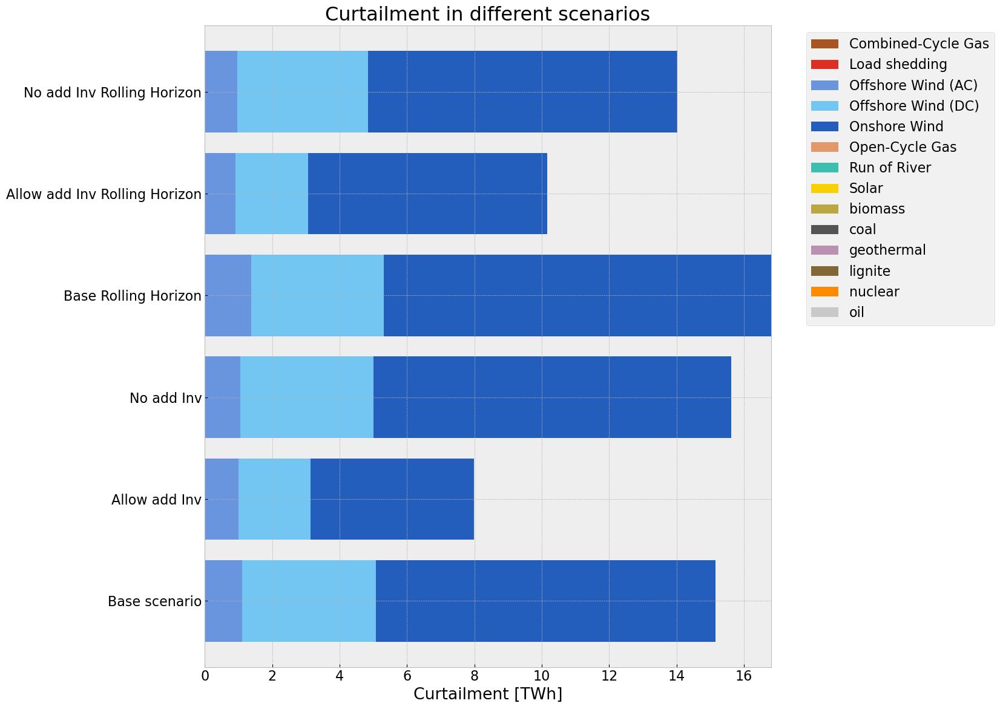

In [257]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


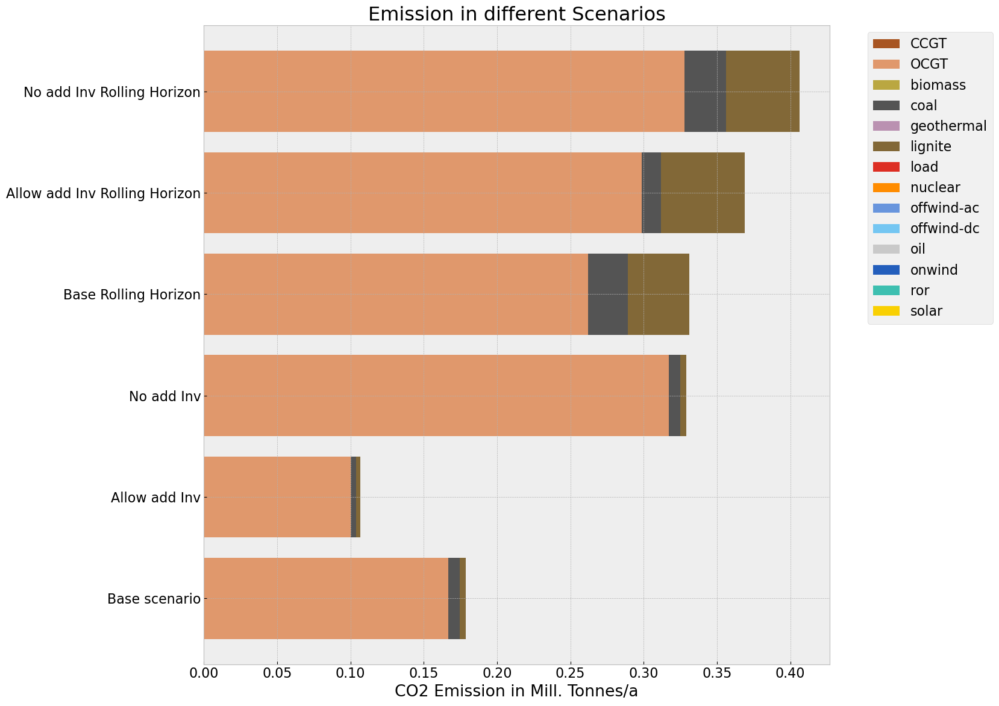

In [258]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [259]:
models = [n, n1, n2, n4]

In [260]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

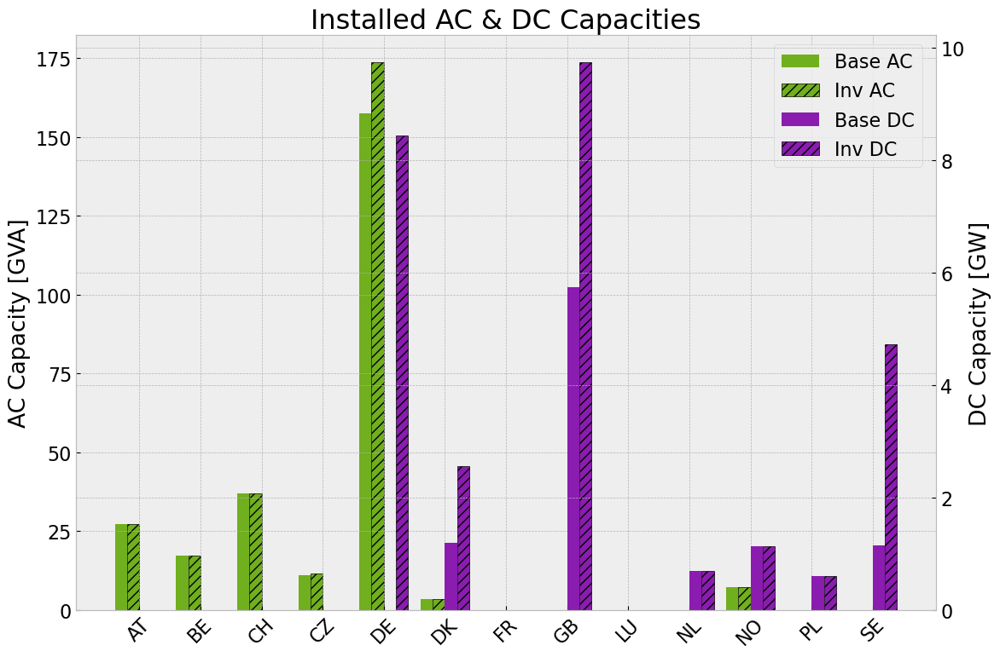

In [261]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_drought.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_drought.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_drought.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_drought.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_drought.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_drought.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [262]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 1,BE1 0: 14801, p_nom_opt: 0.0, 1880.7426693191164
DK2 0,DE1 4: 14824, p_nom_opt: 600.0, 1958.493205882241
SE2 0,DE1 5: 5601, p_nom_opt: 600.0, 2279.197908026511
DE1 5,NO2 0: 14848, p_nom_opt: 0.0, 6557.409232440502
DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
SE2 0,DE1 4: T16, p_nom_opt: 0.0, 1892.8502808738865
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0
GB0 0,DE1 5: T22, p_nom_opt: 0.0, 3989.9249449079057


In [263]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_max,build_year,marginal_cost,min_up_time,min_down_time,up_time_before,down_time_before,p_nom_opt,reversed,type,efficiency,lifetime,p_nom_mod,p_nom_extendable,p_nom_min,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 1,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",239.848593,0.0,,True,False,-1.0,0.000000,25854.398714,30000.0,0,0.009166,0,0,1,0,1880.742669,False,,1.0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",645.936772,1000.0,,False,False,-1.0,0.352490,51412.795403,31000.0,0,0.010527,0,0,1,0,1000.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",1013.198189,2000.0,,False,False,-1.0,0.049244,60275.254416,32000.0,0,0.009487,0,0,1,0,2000.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,600.0,,False,True,-1.0,0.134963,25432.524245,30600.0,0,0.009388,0,0,1,0,600.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
14824,DK2 0,DE1 4,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",432.140281,600.0,,False,False,-1.0,0.163988,36579.446436,30600.0,0,0.010145,0,0,1,0,1958.493206,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
5601,SE2 0,DE1 5,DC,"LINESTRING(12.9299984288384 55.0630403498842,1...",1257.572542,600.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32550"", ""...",False,False,-1.0,0.029686,70092.252666,30600.0,0,0.009191,0,0,1,0,2279.197908,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,SE
14823,PL1 0,SE2 0,DC,"LINESTRING(16.861267 54.533833,16.274872 55.09...",1362.362308,600.0,,False,False,-1.0,0.157706,81109.224571,30600.0,0,0.010771,0,0,1,0,600.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,PL
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",604.737909,0.0,,True,False,-1.0,0.426199,50794.620717,30000.0,0,0.010254,0,0,1,0,0.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1221.169700,700.0,,False,False,-1.0,0.446703,87427.969265,30700.0,0,0.010447,0,0,1,0,700.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL


# Sensitivity Analysis

In [264]:
sens_reductionto = [0.75, reductionto,0.25]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [265]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [266]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = droughtscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = droughtscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_75_90_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 74.53it/s]
INFO:linopy.io: Writing time: 0.95s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcbmn7jq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcbmn7jq.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x8189b704


INFO:gurobipy:Model fingerprint: 0x8189b704


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68111890e+13 -1.25597583e+14  7.62e+05 2.49e+05  3.37e+10     0s


INFO:gurobipy:   0   2.68111890e+13 -1.25597583e+14  7.62e+05 2.49e+05  3.37e+10     0s


   1   1.83171857e+13 -5.65231141e+13  4.81e+05 6.62e+04  1.73e+10     0s


INFO:gurobipy:   1   1.83171857e+13 -5.65231141e+13  4.81e+05 6.62e+04  1.73e+10     0s


   2   6.01802761e+12 -3.18910489e+13  1.12e+05 1.55e+04  4.51e+09     0s


INFO:gurobipy:   2   6.01802761e+12 -3.18910489e+13  1.12e+05 1.55e+04  4.51e+09     0s


   3   1.38697072e+12 -1.19348677e+13  9.66e+03 1.48e+03  6.46e+08     0s


INFO:gurobipy:   3   1.38697072e+12 -1.19348677e+13  9.66e+03 1.48e+03  6.46e+08     0s


   4   4.63501704e+11 -2.56397207e+12  1.18e+03 1.79e+02  1.10e+08     0s


INFO:gurobipy:   4   4.63501704e+11 -2.56397207e+12  1.18e+03 1.79e+02  1.10e+08     0s


   5   2.20610515e+11 -1.61901362e+12  2.82e+02 1.12e+02  6.04e+07     0s


INFO:gurobipy:   5   2.20610515e+11 -1.61901362e+12  2.82e+02 1.12e+02  6.04e+07     0s


   6   1.49792481e+11 -7.81729932e+11  1.22e+02 5.16e+01  2.99e+07     0s


INFO:gurobipy:   6   1.49792481e+11 -7.81729932e+11  1.22e+02 5.16e+01  2.99e+07     0s


   7   8.62605664e+10 -1.78527432e+11  2.99e+01 1.08e+01  8.32e+06     0s


INFO:gurobipy:   7   8.62605664e+10 -1.78527432e+11  2.99e+01 1.08e+01  8.32e+06     0s


   8   4.94488951e+10 -5.70966738e+10  8.48e+00 3.84e+00  3.32e+06     0s


INFO:gurobipy:   8   4.94488951e+10 -5.70966738e+10  8.48e+00 3.84e+00  3.32e+06     0s


   9   3.68788378e+10 -3.55651087e+10  4.48e+00 2.61e+00  2.25e+06     0s


INFO:gurobipy:   9   3.68788378e+10 -3.55651087e+10  4.48e+00 2.61e+00  2.25e+06     0s


  10   3.22966894e+10 -6.13767208e+09  3.28e+00 1.14e+00  1.19e+06     0s


INFO:gurobipy:  10   3.22966894e+10 -6.13767208e+09  3.28e+00 1.14e+00  1.19e+06     0s


  11   2.60957398e+10 -1.06747730e+09  1.90e+00 8.70e-01  8.43e+05     0s


INFO:gurobipy:  11   2.60957398e+10 -1.06747730e+09  1.90e+00 8.70e-01  8.43e+05     0s


  12   2.27690137e+10  4.73399114e+09  1.13e+00 5.98e-01  5.59e+05     0s


INFO:gurobipy:  12   2.27690137e+10  4.73399114e+09  1.13e+00 5.98e-01  5.59e+05     0s


  13   2.12883299e+10  1.03278358e+10  8.08e-01 3.22e-01  3.40e+05     0s


INFO:gurobipy:  13   2.12883299e+10  1.03278358e+10  8.08e-01 3.22e-01  3.40e+05     0s


  14   2.02531738e+10  1.35650884e+10  5.88e-01 1.65e-01  2.07e+05     0s


INFO:gurobipy:  14   2.02531738e+10  1.35650884e+10  5.88e-01 1.65e-01  2.07e+05     0s


  15   1.94747621e+10  1.47959926e+10  4.26e-01 1.09e-01  1.45e+05     0s


INFO:gurobipy:  15   1.94747621e+10  1.47959926e+10  4.26e-01 1.09e-01  1.45e+05     0s


  16   1.89103493e+10  1.57242696e+10  3.14e-01 6.39e-02  9.87e+04     0s


INFO:gurobipy:  16   1.89103493e+10  1.57242696e+10  3.14e-01 6.39e-02  9.87e+04     0s


  17   1.83729107e+10  1.65745315e+10  2.10e-01 2.73e-02  5.57e+04     0s


INFO:gurobipy:  17   1.83729107e+10  1.65745315e+10  2.10e-01 2.73e-02  5.57e+04     0s


  18   1.81418932e+10  1.68173813e+10  1.63e-01 1.76e-02  4.10e+04     1s


INFO:gurobipy:  18   1.81418932e+10  1.68173813e+10  1.63e-01 1.76e-02  4.10e+04     1s


  19   1.79779787e+10  1.68989107e+10  1.31e-01 1.44e-02  3.34e+04     1s


INFO:gurobipy:  19   1.79779787e+10  1.68989107e+10  1.31e-01 1.44e-02  3.34e+04     1s


  20   1.77219379e+10  1.70311696e+10  8.14e-02 9.36e-03  2.14e+04     1s


INFO:gurobipy:  20   1.77219379e+10  1.70311696e+10  8.14e-02 9.36e-03  2.14e+04     1s


  21   1.75755563e+10  1.71339590e+10  5.37e-02 5.60e-03  1.37e+04     1s


INFO:gurobipy:  21   1.75755563e+10  1.71339590e+10  5.37e-02 5.60e-03  1.37e+04     1s


  22   1.74712666e+10  1.71971997e+10  3.36e-02 3.18e-03  8.49e+03     1s


INFO:gurobipy:  22   1.74712666e+10  1.71971997e+10  3.36e-02 3.18e-03  8.49e+03     1s


  23   1.74145135e+10  1.72285592e+10  2.29e-02 1.91e-03  5.76e+03     1s


INFO:gurobipy:  23   1.74145135e+10  1.72285592e+10  2.29e-02 1.91e-03  5.76e+03     1s


  24   1.73676687e+10  1.72519572e+10  1.43e-02 1.12e-03  3.58e+03     1s


INFO:gurobipy:  24   1.73676687e+10  1.72519572e+10  1.43e-02 1.12e-03  3.58e+03     1s


  25   1.73358421e+10  1.72687872e+10  8.42e-03 5.71e-04  2.08e+03     1s


INFO:gurobipy:  25   1.73358421e+10  1.72687872e+10  8.42e-03 5.71e-04  2.08e+03     1s


  26   1.73108458e+10  1.72785100e+10  3.89e-03 2.69e-04  1.00e+03     1s


INFO:gurobipy:  26   1.73108458e+10  1.72785100e+10  3.89e-03 2.69e-04  1.00e+03     1s


  27   1.72935015e+10  1.72845761e+10  8.61e-04 8.76e-05  2.76e+02     1s


INFO:gurobipy:  27   1.72935015e+10  1.72845761e+10  8.61e-04 8.76e-05  2.76e+02     1s


  28   1.72898756e+10  1.72867705e+10  2.58e-04 3.32e-05  9.61e+01     1s


INFO:gurobipy:  28   1.72898756e+10  1.72867705e+10  2.58e-04 3.32e-05  9.61e+01     1s


  29   1.72886690e+10  1.72875416e+10  6.62e-05 1.44e-05  3.49e+01     1s


INFO:gurobipy:  29   1.72886690e+10  1.72875416e+10  6.62e-05 1.44e-05  3.49e+01     1s


  30   1.72883996e+10  1.72880379e+10  2.68e-05 3.37e-06  1.12e+01     1s


INFO:gurobipy:  30   1.72883996e+10  1.72880379e+10  2.68e-05 3.37e-06  1.12e+01     1s


  31   1.72882346e+10  1.72881794e+10  3.85e-05 4.56e-07  1.71e+00     1s


INFO:gurobipy:  31   1.72882346e+10  1.72881794e+10  3.85e-05 4.56e-07  1.71e+00     1s


  32   1.72882168e+10  1.72881989e+10  1.45e-05 1.16e-07  5.54e-01     1s


INFO:gurobipy:  32   1.72882168e+10  1.72881989e+10  1.45e-05 1.16e-07  5.54e-01     1s


  33   1.72882071e+10  1.72882057e+10  1.02e-06 6.83e-09  4.26e-02     1s


INFO:gurobipy:  33   1.72882071e+10  1.72882057e+10  1.02e-06 6.83e-09  4.26e-02     1s


  34   1.72882066e+10  1.72882066e+10  2.15e-07 8.85e-11  4.98e-04     1s


INFO:gurobipy:  34   1.72882066e+10  1.72882066e+10  2.15e-07 8.85e-11  4.98e-04     1s


  35   1.72882066e+10  1.72882066e+10  8.24e-08 8.73e-11  1.63e-06     1s


INFO:gurobipy:  35   1.72882066e+10  1.72882066e+10  8.24e-08 8.73e-11  1.63e-06     1s


  36   1.72882066e+10  1.72882066e+10  5.60e-09 8.73e-11  2.19e-08     1s


INFO:gurobipy:  36   1.72882066e+10  1.72882066e+10  5.60e-09 8.73e-11  2.19e-08     1s


  37   1.72882066e+10  1.72882066e+10  2.44e-10 8.73e-11  1.10e-10     1s


INFO:gurobipy:  37   1.72882066e+10  1.72882066e+10  2.44e-10 8.73e-11  1.10e-10     1s


INFO:gurobipy:


Barrier solved model in 37 iterations and 0.90 seconds (0.32 work units)


INFO:gurobipy:Barrier solved model in 37 iterations and 0.90 seconds (0.32 work units)


Optimal objective 1.72882066e+10


INFO:gurobipy:Optimal objective 1.72882066e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3217 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3217 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     172 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     172 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 7.5351747e-10      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 7.5351747e-10      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1884    1.7288207e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1884    1.7288207e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1884 iterations and 1.04 seconds (0.37 work units)


INFO:gurobipy:Solved in 1884 iterations and 1.04 seconds (0.37 work units)


Optimal objective  1.728820662e+10


INFO:gurobipy:Optimal objective  1.728820662e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.73e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_75_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_90_inv.nc has loads, generators, carriers, lines, storage_units, buses, links
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_75_90_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c84g00tw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c84g00tw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd21b88c4


INFO:gurobipy:Model fingerprint: 0xd21b88c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3975986e+08   7.285964e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3975986e+08   7.285964e+05   0.000000e+00      0s


     215    4.4811994e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    4.4811994e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.481199430e+09


INFO:gurobipy:Optimal objective  4.481199430e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-24gmfpin.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-24gmfpin.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb8251423


INFO:gurobipy:Model fingerprint: 0xb8251423


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 8e+03]


INFO:gurobipy:  Bounds range     [9e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9999784e+08   7.049162e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9999784e+08   7.049162e+05   0.000000e+00      0s


     218    5.5536239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    5.5536239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.553623944e+09


INFO:gurobipy:Optimal objective  5.553623944e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8mdlkrzz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8mdlkrzz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x81513093


INFO:gurobipy:Model fingerprint: 0x81513093


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 5e+03]


INFO:gurobipy:  Bounds range     [8e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9260611e+09   7.063852e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9260611e+09   7.063852e+05   0.000000e+00      0s


     239    1.1238197e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.1238197e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.123819705e+10


INFO:gurobipy:Optimal objective  1.123819705e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osrxjbak.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osrxjbak.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0eb49e30


INFO:gurobipy:Model fingerprint: 0x0eb49e30


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 4e+03]


INFO:gurobipy:  Bounds range     [7e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 855 columns


INFO:gurobipy:Presolve removed 3187 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 708 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 167 rows, 708 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4188115e+09   6.994768e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4188115e+09   6.994768e+05   0.000000e+00      0s


     215    9.5252521e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    9.5252521e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.525252102e+09


INFO:gurobipy:Optimal objective  9.525252102e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-okejbnz8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-okejbnz8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf03cf092


INFO:gurobipy:Model fingerprint: 0xf03cf092


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 848 columns


INFO:gurobipy:Presolve removed 3187 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 715 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 167 rows, 715 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.4206112e+08   7.316873e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.4206112e+08   7.316873e+05   0.000000e+00      0s


     207    6.2828460e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.2828460e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.282845950e+09


INFO:gurobipy:Optimal objective  6.282845950e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0hf4qdw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0hf4qdw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9f3f969b


INFO:gurobipy:Model fingerprint: 0x9f3f969b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 9e+03]


INFO:gurobipy:  Bounds range     [5e+00, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3188 rows and 846 columns


INFO:gurobipy:Presolve removed 3188 rows and 846 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 166 rows, 717 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 166 rows, 717 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7385002e+04   7.372036e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7385002e+04   7.372036e+05   0.000000e+00      0s


     273    3.4976214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    3.4976214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 273 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.497621382e+08


INFO:gurobipy:Optimal objective  3.497621382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8owrw12.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8owrw12.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34cd8291


INFO:gurobipy:Model fingerprint: 0x34cd8291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 859 columns


INFO:gurobipy:Presolve removed 3192 rows and 859 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 162 rows, 704 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 162 rows, 704 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8974074e+05   7.369166e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8974074e+05   7.369166e+05   0.000000e+00      0s


     221    1.3582365e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    1.3582365e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.11 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.11 seconds (0.00 work units)


Optimal objective  1.358236536e+08


INFO:gurobipy:Optimal objective  1.358236536e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rsy_7jjg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rsy_7jjg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x84ad0d46


INFO:gurobipy:Model fingerprint: 0x84ad0d46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 875 columns


INFO:gurobipy:Presolve removed 3202 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 688 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 152 rows, 688 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5906398e+07   7.348651e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5906398e+07   7.348651e+05   0.000000e+00      0s


     184    7.3614901e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    7.3614901e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.05 seconds (0.00 work units)


Optimal objective  7.361490084e+07


INFO:gurobipy:Optimal objective  7.361490084e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.36e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5f55wga_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5f55wga_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf68adc


INFO:gurobipy:Model fingerprint: 0xbaf68adc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 849 columns


INFO:gurobipy:Presolve removed 3192 rows and 849 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 162 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1442397e+05   7.384619e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1442397e+05   7.384619e+05   0.000000e+00      0s


     231    5.9494498e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    5.9494498e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.949449772e+07


INFO:gurobipy:Optimal objective  5.949449772e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6s_za5eu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6s_za5eu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3c0c0356


INFO:gurobipy:Model fingerprint: 0x3c0c0356


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 855 columns


INFO:gurobipy:Presolve removed 3192 rows and 855 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 708 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 162 rows, 708 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7124017e+07   7.329715e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7124017e+07   7.329715e+05   0.000000e+00      0s


     223    2.4121068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.4121068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.412106762e+08


INFO:gurobipy:Optimal objective  2.412106762e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bk61n3f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bk61n3f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0d36f8f


INFO:gurobipy:Model fingerprint: 0xc0d36f8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 850 columns


INFO:gurobipy:Presolve removed 3192 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 713 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 162 rows, 713 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8041587e+04   7.297656e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8041587e+04   7.297656e+05   0.000000e+00      0s


     224    1.2431570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.2431570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.243157009e+08


INFO:gurobipy:Optimal objective  1.243157009e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1pm_zgf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1pm_zgf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x804ab56b


INFO:gurobipy:Model fingerprint: 0x804ab56b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5777315e+07   7.280198e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5777315e+07   7.280198e+05   0.000000e+00      0s


     258    3.3811869e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    3.3811869e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.381186899e+08


INFO:gurobipy:Optimal objective  3.381186899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj_m1_er.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj_m1_er.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc37553eb


INFO:gurobipy:Model fingerprint: 0xc37553eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5117828e+05   7.197005e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5117828e+05   7.197005e+05   0.000000e+00      0s


     267    5.3695159e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    5.3695159e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.369515917e+08


INFO:gurobipy:Optimal objective  5.369515917e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vrmhrwcu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vrmhrwcu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa374ce94


INFO:gurobipy:Model fingerprint: 0xa374ce94


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 834 columns


INFO:gurobipy:Presolve removed 3186 rows and 834 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 729 columns, 1175 nonzeros


INFO:gurobipy:Presolved: 168 rows, 729 columns, 1175 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2087056e+05   7.246573e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2087056e+05   7.246573e+05   0.000000e+00      0s


     231    4.3582150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    4.3582150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.358214970e+08


INFO:gurobipy:Optimal objective  4.358214970e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-re93lxgr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-re93lxgr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdf221662


INFO:gurobipy:Model fingerprint: 0xdf221662


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6574070e+05   7.200022e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6574070e+05   7.200022e+05   0.000000e+00      0s


     219    1.8747950e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.8747950e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.874794980e+08


INFO:gurobipy:Optimal objective  1.874794980e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-157i0io8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-157i0io8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x900c7933


INFO:gurobipy:Model fingerprint: 0x900c7933


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 839 columns


INFO:gurobipy:Presolve removed 3186 rows and 839 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 724 columns, 1170 nonzeros


INFO:gurobipy:Presolved: 168 rows, 724 columns, 1170 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1836716e+07   7.020104e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1836716e+07   7.020104e+05   0.000000e+00      0s


     207    3.3351483e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3351483e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.335148280e+09


INFO:gurobipy:Optimal objective  3.335148280e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3z3541iz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3z3541iz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x12010f7e


INFO:gurobipy:Model fingerprint: 0x12010f7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6491133e+05   7.025856e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6491133e+05   7.025856e+05   0.000000e+00      0s


     194    6.9902067e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    6.9902067e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.990206711e+08


INFO:gurobipy:Optimal objective  6.990206711e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3d2yrb3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3d2yrb3c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xf9c89200


INFO:gurobipy:Model fingerprint: 0xf9c89200


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 576 columns


INFO:gurobipy:Presolve removed 2124 rows and 576 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 466 columns, 755 nonzeros


INFO:gurobipy:Presolved: 112 rows, 466 columns, 755 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4577229e+05   1.461971e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4577229e+05   1.461971e+05   0.000000e+00      0s


     142    5.0513200e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     142    5.0513200e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 142 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 142 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.051320039e+07


INFO:gurobipy:Optimal objective  5.051320039e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 5.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_90_inv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links


n_0_75_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 60.87it/s]
INFO:linopy.io: Writing time: 0.74s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_38qygky.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_38qygky.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x0d8ac8cf


INFO:gurobipy:Model fingerprint: 0x0d8ac8cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14789 columns


INFO:gurobipy:Presolve removed 56286 rows and 14789 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48355462e+13 -2.95846502e+13  4.24e+05 1.46e-11  6.53e+09     0s


INFO:gurobipy:   0   1.48355462e+13 -2.95846502e+13  4.24e+05 1.46e-11  6.53e+09     0s


   1   1.65667399e+12 -7.61402576e+12  4.07e+04 1.16e-10  7.64e+08     0s


INFO:gurobipy:   1   1.65667399e+12 -7.61402576e+12  4.07e+04 1.16e-10  7.64e+08     0s


   2   3.01396907e+11 -2.58750638e+12  3.90e+03 1.89e-09  1.41e+08     0s


INFO:gurobipy:   2   3.01396907e+11 -2.58750638e+12  3.90e+03 1.89e-09  1.41e+08     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.36 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.36 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4960    1.5510524e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4960    1.5510524e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4960 iterations and 0.44 seconds (0.13 work units)


INFO:gurobipy:Solved in 4960 iterations and 0.44 seconds (0.13 work units)


Optimal objective  1.551052379e+10


INFO:gurobipy:Optimal objective  1.551052379e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.55e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_90_noinv.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_75_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ok5rnxy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ok5rnxy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x722b9cfd


INFO:gurobipy:Model fingerprint: 0x722b9cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-avmxzt6b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-avmxzt6b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72b3d353


INFO:gurobipy:Model fingerprint: 0x72b3d353


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 8e+03]


INFO:gurobipy:  Bounds range     [9e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123405e+09   6.147812e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123405e+09   6.147812e+05   0.000000e+00      0s


     184    1.7036260e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.7036260e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.703625995e+10


INFO:gurobipy:Optimal objective  1.703625995e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ftrqj2yn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ftrqj2yn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x14efcbd0


INFO:gurobipy:Model fingerprint: 0x14efcbd0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 5e+03]


INFO:gurobipy:  Bounds range     [8e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 885 columns


INFO:gurobipy:Presolve removed 3188 rows and 885 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 166 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 166 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6886351e+09   6.046671e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6886351e+09   6.046671e+05   0.000000e+00      0s


     218    2.1736091e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.1736091e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.07 seconds (0.00 work units)


Optimal objective  2.173609131e+10


INFO:gurobipy:Optimal objective  2.173609131e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_zt4g1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_zt4g1f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf6b32d00


INFO:gurobipy:Model fingerprint: 0xf6b32d00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 4e+03]


INFO:gurobipy:  Bounds range     [7e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7360019e+09   6.166440e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7360019e+09   6.166440e+05   0.000000e+00      0s


     215    2.1082995e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    2.1082995e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.108299534e+10


INFO:gurobipy:Optimal objective  2.108299534e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.11e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lucny5mu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lucny5mu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2b34789


INFO:gurobipy:Model fingerprint: 0xb2b34789


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 874 columns


INFO:gurobipy:Presolve removed 3188 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 689 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 166 rows, 689 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7050439e+09   6.655681e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7050439e+09   6.655681e+05   0.000000e+00      0s


     218    1.7670768e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7670768e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.767076761e+10


INFO:gurobipy:Optimal objective  1.767076761e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.77e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wh_3uzs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wh_3uzs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8563aed4


INFO:gurobipy:Model fingerprint: 0x8563aed4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 9e+03]


INFO:gurobipy:  Bounds range     [5e+00, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3189 rows and 870 columns


INFO:gurobipy:Presolve removed 3189 rows and 870 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 165 rows, 693 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 165 rows, 693 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2519018e+09   6.368465e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2519018e+09   6.368465e+05   0.000000e+00      0s


     228    5.7309609e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.7309609e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.07 seconds (0.00 work units)


Optimal objective  5.730960856e+09


INFO:gurobipy:Optimal objective  5.730960856e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8l6jlxs7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8l6jlxs7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5983170


INFO:gurobipy:Model fingerprint: 0xc5983170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 877 columns


INFO:gurobipy:Presolve removed 3192 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 686 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 162 rows, 686 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554268e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554268e+05   0.000000e+00      0s


     225    1.4902710e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4902710e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.490270981e+08


INFO:gurobipy:Optimal objective  1.490270981e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94lk884a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94lk884a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15f6f86e


INFO:gurobipy:Model fingerprint: 0x15f6f86e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5994996e+07   6.541972e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5994996e+07   6.541972e+05   0.000000e+00      0s


     200    1.3244808e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3244808e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.324480758e+08


INFO:gurobipy:Optimal objective  1.324480758e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zey11tur.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zey11tur.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x40448e05


INFO:gurobipy:Model fingerprint: 0x40448e05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3198 rows and 890 columns


INFO:gurobipy:Presolve removed 3198 rows and 890 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 156 rows, 673 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 156 rows, 673 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4242344e+05   6.527205e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4242344e+05   6.527205e+05   0.000000e+00      0s


     209    8.7383489e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    8.7383489e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.07 seconds (0.00 work units)


Optimal objective  8.738348924e+07


INFO:gurobipy:Optimal objective  8.738348924e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06wjs66a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06wjs66a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b8b2b0e


INFO:gurobipy:Model fingerprint: 0x1b8b2b0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 868 columns


INFO:gurobipy:Presolve removed 3192 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201190e+07   6.530710e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201190e+07   6.530710e+05   0.000000e+00      0s


     250    2.8988879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.8988879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.898887907e+08


INFO:gurobipy:Optimal objective  2.898887907e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hv5fz7gs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hv5fz7gs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x20fcf31d


INFO:gurobipy:Model fingerprint: 0x20fcf31d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 865 columns


INFO:gurobipy:Presolve removed 3192 rows and 865 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2320056e+05   6.451939e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2320056e+05   6.451939e+05   0.000000e+00      0s


     228    1.2507981e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    1.2507981e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.250798061e+08


INFO:gurobipy:Optimal objective  1.250798061e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pmms6brr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pmms6brr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a93eea4


INFO:gurobipy:Model fingerprint: 0x6a93eea4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.454051e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.454051e+05   0.000000e+00      0s


     258    3.9336484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    3.9336484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.933648430e+08


INFO:gurobipy:Optimal objective  3.933648430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2k3nxp25.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2k3nxp25.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7a1b13c


INFO:gurobipy:Model fingerprint: 0xb7a1b13c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-blf0ro8j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-blf0ro8j.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34980b16


INFO:gurobipy:Model fingerprint: 0x34980b16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xj39p0nd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xj39p0nd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc7a0f9c


INFO:gurobipy:Model fingerprint: 0xcc7a0f9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xgdn2zrh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xgdn2zrh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c9a30b


INFO:gurobipy:Model fingerprint: 0xe8c9a30b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wzhlf2q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wzhlf2q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49356d4a


INFO:gurobipy:Model fingerprint: 0x49356d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cx_faai8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cx_faai8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x57cb9ea1


INFO:gurobipy:Model fingerprint: 0x57cb9ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_90_noinv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


n_0_75_180_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 97.55it/s]
INFO:linopy.io: Writing time: 0.9s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gbhozje.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gbhozje.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xe39e38f7


INFO:gurobipy:Model fingerprint: 0xe39e38f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68095666e+13 -1.25405005e+14  7.62e+05 2.49e+05  3.37e+10     0s


INFO:gurobipy:   0   2.68095666e+13 -1.25405005e+14  7.62e+05 2.49e+05  3.37e+10     0s


   1   1.83186666e+13 -5.63812490e+13  4.81e+05 6.62e+04  1.73e+10     0s


INFO:gurobipy:   1   1.83186666e+13 -5.63812490e+13  4.81e+05 6.62e+04  1.73e+10     0s


   2   6.02093611e+12 -3.17891410e+13  1.12e+05 1.55e+04  4.51e+09     0s


INFO:gurobipy:   2   6.02093611e+12 -3.17891410e+13  1.12e+05 1.55e+04  4.51e+09     0s


   3   1.38614021e+12 -1.19104952e+13  9.64e+03 1.49e+03  6.45e+08     0s


INFO:gurobipy:   3   1.38614021e+12 -1.19104952e+13  9.64e+03 1.49e+03  6.45e+08     0s


   4   4.63233574e+11 -2.55613870e+12  1.18e+03 1.79e+02  1.10e+08     1s


INFO:gurobipy:   4   4.63233574e+11 -2.55613870e+12  1.18e+03 1.79e+02  1.10e+08     1s


   5   2.20091301e+11 -1.61209884e+12  2.78e+02 1.12e+02  6.01e+07     1s


INFO:gurobipy:   5   2.20091301e+11 -1.61209884e+12  2.78e+02 1.12e+02  6.01e+07     1s


   6   1.49973154e+11 -7.76224904e+11  1.20e+02 5.16e+01  2.97e+07     1s


INFO:gurobipy:   6   1.49973154e+11 -7.76224904e+11  1.20e+02 5.16e+01  2.97e+07     1s


   7   8.71935114e+10 -1.88007412e+11  3.01e+01 1.16e+01  8.65e+06     1s


INFO:gurobipy:   7   8.71935114e+10 -1.88007412e+11  3.01e+01 1.16e+01  8.65e+06     1s


   8   4.79435411e+10 -5.60030326e+10  6.94e+00 3.98e+00  3.24e+06     1s


INFO:gurobipy:   8   4.79435411e+10 -5.60030326e+10  6.94e+00 3.98e+00  3.24e+06     1s


   9   3.66026001e+10 -3.41646527e+10  3.74e+00 2.70e+00  2.20e+06     1s


INFO:gurobipy:   9   3.66026001e+10 -3.41646527e+10  3.74e+00 2.70e+00  2.20e+06     1s


  10   3.21526587e+10 -6.45467892e+09  2.71e+00 1.25e+00  1.20e+06     1s


INFO:gurobipy:  10   3.21526587e+10 -6.45467892e+09  2.71e+00 1.25e+00  1.20e+06     1s


  11   2.66352160e+10  3.38445757e+09  1.60e+00 7.37e-01  7.21e+05     1s


INFO:gurobipy:  11   2.66352160e+10  3.38445757e+09  1.60e+00 7.37e-01  7.21e+05     1s


  12   2.52184404e+10  7.27195378e+09  1.32e+00 5.34e-01  5.57e+05     1s


INFO:gurobipy:  12   2.52184404e+10  7.27195378e+09  1.32e+00 5.34e-01  5.57e+05     1s


  13   2.41170465e+10  9.09978000e+09  1.11e+00 4.39e-01  4.66e+05     1s


INFO:gurobipy:  13   2.41170465e+10  9.09978000e+09  1.11e+00 4.39e-01  4.66e+05     1s


  14   2.04807748e+10  1.44246434e+10  4.00e-01 1.50e-01  1.88e+05     1s


INFO:gurobipy:  14   2.04807748e+10  1.44246434e+10  4.00e-01 1.50e-01  1.88e+05     1s


  15   1.97413182e+10  1.61417112e+10  2.77e-01 7.50e-02  1.12e+05     1s


INFO:gurobipy:  15   1.97413182e+10  1.61417112e+10  2.77e-01 7.50e-02  1.12e+05     1s


  16   1.89625555e+10  1.66940790e+10  1.55e-01 5.12e-02  7.03e+04     1s


INFO:gurobipy:  16   1.89625555e+10  1.66940790e+10  1.55e-01 5.12e-02  7.03e+04     1s


  17   1.88019389e+10  1.71761189e+10  1.30e-01 3.05e-02  5.04e+04     1s


INFO:gurobipy:  17   1.88019389e+10  1.71761189e+10  1.30e-01 3.05e-02  5.04e+04     1s


  18   1.83979563e+10  1.75455991e+10  6.82e-02 1.40e-02  2.64e+04     1s


INFO:gurobipy:  18   1.83979563e+10  1.75455991e+10  6.82e-02 1.40e-02  2.64e+04     1s


  19   1.82383649e+10  1.77407019e+10  4.51e-02 6.12e-03  1.54e+04     1s


INFO:gurobipy:  19   1.82383649e+10  1.77407019e+10  4.51e-02 6.12e-03  1.54e+04     1s


  20   1.80936105e+10  1.78349488e+10  2.41e-02 2.76e-03  8.01e+03     1s


INFO:gurobipy:  20   1.80936105e+10  1.78349488e+10  2.41e-02 2.76e-03  8.01e+03     1s


  21   1.79804213e+10  1.79003403e+10  8.07e-03 5.42e-04  2.48e+03     1s


INFO:gurobipy:  21   1.79804213e+10  1.79003403e+10  8.07e-03 5.42e-04  2.48e+03     1s


  22   1.79596155e+10  1.79088590e+10  5.35e-03 3.18e-04  1.57e+03     1s


INFO:gurobipy:  22   1.79596155e+10  1.79088590e+10  5.35e-03 3.18e-04  1.57e+03     1s


  23   1.79492149e+10  1.79142021e+10  3.88e-03 1.48e-04  1.08e+03     1s


INFO:gurobipy:  23   1.79492149e+10  1.79142021e+10  3.88e-03 1.48e-04  1.08e+03     1s


  24   1.79371324e+10  1.79163161e+10  2.21e-03 9.80e-05  6.44e+02     1s


INFO:gurobipy:  24   1.79371324e+10  1.79163161e+10  2.21e-03 9.80e-05  6.44e+02     1s


  25   1.79308061e+10  1.79188296e+10  1.35e-03 4.12e-05  3.71e+02     1s


INFO:gurobipy:  25   1.79308061e+10  1.79188296e+10  1.35e-03 4.12e-05  3.71e+02     1s


  26   1.79257580e+10  1.79196336e+10  6.46e-04 2.05e-05  1.90e+02     1s


INFO:gurobipy:  26   1.79257580e+10  1.79196336e+10  6.46e-04 2.05e-05  1.90e+02     1s


  27   1.79228761e+10  1.79205065e+10  2.58e-04 5.31e-06  7.34e+01     1s


INFO:gurobipy:  27   1.79228761e+10  1.79205065e+10  2.58e-04 5.31e-06  7.34e+01     1s


  28   1.79217493e+10  1.79207688e+10  1.13e-04 1.66e-06  3.04e+01     1s


INFO:gurobipy:  28   1.79217493e+10  1.79207688e+10  1.13e-04 1.66e-06  3.04e+01     1s


  29   1.79216024e+10  1.79207822e+10  9.36e-05 1.47e-06  2.54e+01     1s


INFO:gurobipy:  29   1.79216024e+10  1.79207822e+10  9.36e-05 1.47e-06  2.54e+01     1s


  30   1.79211826e+10  1.79208449e+10  3.80e-05 4.29e-07  1.05e+01     1s


INFO:gurobipy:  30   1.79211826e+10  1.79208449e+10  3.80e-05 4.29e-07  1.05e+01     1s


  31   1.79210635e+10  1.79208712e+10  2.43e-05 1.28e-07  5.95e+00     1s


INFO:gurobipy:  31   1.79210635e+10  1.79208712e+10  2.43e-05 1.28e-07  5.95e+00     1s


  32   1.79209013e+10  1.79208846e+10  1.53e-05 3.01e-09  5.16e-01     1s


INFO:gurobipy:  32   1.79209013e+10  1.79208846e+10  1.53e-05 3.01e-09  5.16e-01     1s


  33   1.79208906e+10  1.79208899e+10  9.63e-07 1.22e-10  2.36e-02     1s


INFO:gurobipy:  33   1.79208906e+10  1.79208899e+10  9.63e-07 1.22e-10  2.36e-02     1s


  34   1.79208902e+10  1.79208902e+10  2.77e-06 7.16e-11  1.62e-03     2s


INFO:gurobipy:  34   1.79208902e+10  1.79208902e+10  2.77e-06 7.16e-11  1.62e-03     2s


  35   1.79208902e+10  1.79208902e+10  1.69e-07 9.23e-11  9.25e-07     2s


INFO:gurobipy:  35   1.79208902e+10  1.79208902e+10  1.69e-07 9.23e-11  9.25e-07     2s


  36   1.79208902e+10  1.79208902e+10  2.81e-09 8.73e-11  9.26e-10     2s


INFO:gurobipy:  36   1.79208902e+10  1.79208902e+10  2.81e-09 8.73e-11  9.26e-10     2s


INFO:gurobipy:


Barrier solved model in 36 iterations and 1.55 seconds (0.31 work units)


INFO:gurobipy:Barrier solved model in 36 iterations and 1.55 seconds (0.31 work units)


Optimal objective 1.79208902e+10


INFO:gurobipy:Optimal objective 1.79208902e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3167 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3167 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     200 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     200 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.5069360e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.5069360e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    1.7920890e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1828    1.7920890e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1828 iterations and 1.74 seconds (0.36 work units)


INFO:gurobipy:Solved in 1828 iterations and 1.74 seconds (0.36 work units)


Optimal objective  1.792089020e+10


INFO:gurobipy:Optimal objective  1.792089020e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_75_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_180_inv.nc has loads, generators, carriers, lines, storage_units, buses, links
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_75_180_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwn2kpoq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwn2kpoq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff455404


INFO:gurobipy:Model fingerprint: 0xff455404


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2266469e+08   7.696093e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2266469e+08   7.696093e+05   0.000000e+00      0s


     229    4.3921915e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    4.3921915e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.392191530e+09


INFO:gurobipy:Optimal objective  4.392191530e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ope17m5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ope17m5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x92d12999


INFO:gurobipy:Model fingerprint: 0x92d12999


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 8e+03]


INFO:gurobipy:  Bounds range     [9e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8415426e+05   7.500390e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8415426e+05   7.500390e+05   0.000000e+00      0s


     222    3.4442237e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    3.4442237e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.444223716e+09


INFO:gurobipy:Optimal objective  3.444223716e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l36ncr3d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l36ncr3d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6473b8d2


INFO:gurobipy:Model fingerprint: 0x6473b8d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 5e+03]


INFO:gurobipy:  Bounds range     [8e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6746863e+08   7.474129e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6746863e+08   7.474129e+05   0.000000e+00      0s


     190    9.0735174e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    9.0735174e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.073517406e+09


INFO:gurobipy:Optimal objective  9.073517406e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h39yl7gy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h39yl7gy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8c7a7272


INFO:gurobipy:Model fingerprint: 0x8c7a7272


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 4e+03]


INFO:gurobipy:  Bounds range     [7e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 855 columns


INFO:gurobipy:Presolve removed 3187 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 708 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 167 rows, 708 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9436921e+08   7.195511e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9436921e+08   7.195511e+05   0.000000e+00      0s


     212    7.4771533e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    7.4771533e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.477153294e+09


INFO:gurobipy:Optimal objective  7.477153294e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ptmdii7x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ptmdii7x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6acae6a


INFO:gurobipy:Model fingerprint: 0xc6acae6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1558841e+07   7.726566e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1558841e+07   7.726566e+05   0.000000e+00      0s


     234    4.1441199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    4.1441199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.144119949e+09


INFO:gurobipy:Optimal objective  4.144119949e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_jret9a2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_jret9a2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x36402d17


INFO:gurobipy:Model fingerprint: 0x36402d17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 9e+03]


INFO:gurobipy:  Bounds range     [5e+00, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3188 rows and 844 columns


INFO:gurobipy:Presolve removed 3188 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 719 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 166 rows, 719 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2029941e+04   7.778385e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2029941e+04   7.778385e+05   0.000000e+00      0s


     250    3.1917910e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.1917910e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.191790985e+08


INFO:gurobipy:Optimal objective  3.191790985e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05e7y2a8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05e7y2a8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4472765b


INFO:gurobipy:Model fingerprint: 0x4472765b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1465153e+05   7.837302e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1465153e+05   7.837302e+05   0.000000e+00      0s


     237    2.2275333e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.2275333e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.227533312e+08


INFO:gurobipy:Optimal objective  2.227533312e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2d7qci8r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2d7qci8r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98363e5c


INFO:gurobipy:Model fingerprint: 0x98363e5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 854 columns


INFO:gurobipy:Presolve removed 3192 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 709 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 162 rows, 709 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5768503e+07   7.810143e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5768503e+07   7.810143e+05   0.000000e+00      0s


     206    1.3684757e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.3684757e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.368475731e+08


INFO:gurobipy:Optimal objective  1.368475731e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_tjimb0b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_tjimb0b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x806f9caf


INFO:gurobipy:Model fingerprint: 0x806f9caf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 723 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7487462e+04   7.778377e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7487462e+04   7.778377e+05   0.000000e+00      0s


     278    1.6161025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    1.6161025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.616102544e+08


INFO:gurobipy:Optimal objective  1.616102544e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhfh3j7h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhfh3j7h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x078bdb3e


INFO:gurobipy:Model fingerprint: 0x078bdb3e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8004701e+04   7.762571e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8004701e+04   7.762571e+05   0.000000e+00      0s


     238    3.1948649e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.1948649e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.194864920e+08


INFO:gurobipy:Optimal objective  3.194864920e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65k5ltlg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65k5ltlg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x851768b5


INFO:gurobipy:Model fingerprint: 0x851768b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8470983e+04   7.779127e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8470983e+04   7.779127e+05   0.000000e+00      0s


     240    1.4463254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.4463254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.446325450e+08


INFO:gurobipy:Optimal objective  1.446325450e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0dqv69u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0dqv69u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0685cc7


INFO:gurobipy:Model fingerprint: 0xe0685cc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1151107e+04   7.674557e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1151107e+04   7.674557e+05   0.000000e+00      0s


     252    3.3161708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    3.3161708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.316170833e+08


INFO:gurobipy:Optimal objective  3.316170833e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-beszdr5z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-beszdr5z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46de1611


INFO:gurobipy:Model fingerprint: 0x46de1611


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3285657e+05   7.601366e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3285657e+05   7.601366e+05   0.000000e+00      0s


     280    4.7270595e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    4.7270595e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 280 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.727059521e+08


INFO:gurobipy:Optimal objective  4.727059521e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s7x4c1dw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s7x4c1dw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc26d1899


INFO:gurobipy:Model fingerprint: 0xc26d1899


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 834 columns


INFO:gurobipy:Presolve removed 3186 rows and 834 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 729 columns, 1175 nonzeros


INFO:gurobipy:Presolved: 168 rows, 729 columns, 1175 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.5515494e+04   7.652968e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.5515494e+04   7.652968e+05   0.000000e+00      0s


     262    4.2670600e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    4.2670600e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.267059995e+08


INFO:gurobipy:Optimal objective  4.267059995e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2tvz5yvg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2tvz5yvg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc281f518


INFO:gurobipy:Model fingerprint: 0xc281f518


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4038564e+05   7.607010e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4038564e+05   7.607010e+05   0.000000e+00      0s


     248    1.7541897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    1.7541897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.754189661e+08


INFO:gurobipy:Optimal objective  1.754189661e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqbu_k_n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqbu_k_n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x843541b5


INFO:gurobipy:Model fingerprint: 0x843541b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6150552e+07   7.438803e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6150552e+07   7.438803e+05   0.000000e+00      0s


     332    3.2923728e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    3.2923728e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.292372815e+09


INFO:gurobipy:Optimal objective  3.292372815e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4btsq8g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4btsq8g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10649ea1


INFO:gurobipy:Model fingerprint: 0x10649ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1067908e+05   7.444277e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1067908e+05   7.444277e+05   0.000000e+00      0s


     206    6.2360052e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.2360052e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.236005218e+08


INFO:gurobipy:Optimal objective  6.236005218e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojc3qoe3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojc3qoe3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xaa9babcc


INFO:gurobipy:Model fingerprint: 0xaa9babcc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 574 columns


INFO:gurobipy:Presolve removed 2124 rows and 574 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 468 columns, 757 nonzeros


INFO:gurobipy:Presolved: 112 rows, 468 columns, 757 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0195054e+05   1.525763e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0195054e+05   1.525763e+05   0.000000e+00      0s


     126    4.4689017e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     126    4.4689017e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 126 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 126 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.468901742e+07


INFO:gurobipy:Optimal objective  4.468901742e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_180_inv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links


n_0_75_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.85it/s]
INFO:linopy.io: Writing time: 0.75s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6sbvjf46.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6sbvjf46.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x29edeb36


INFO:gurobipy:Model fingerprint: 0x29edeb36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14790 columns


INFO:gurobipy:Presolve removed 56286 rows and 14790 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2968 rows, 12823 columns, 20932 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12823 columns, 20932 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48456733e+13 -2.95353758e+13  4.24e+05 1.46e-11  6.53e+09     0s


INFO:gurobipy:   0   1.48456733e+13 -2.95353758e+13  4.24e+05 1.46e-11  6.53e+09     0s


   1   1.66192319e+12 -7.48758893e+12  4.07e+04 8.73e-11  7.59e+08     0s


INFO:gurobipy:   1   1.66192319e+12 -7.48758893e+12  4.07e+04 8.73e-11  7.59e+08     0s


   2   3.33357486e+11 -2.49360596e+12  4.69e+03 2.62e-10  1.45e+08     0s


INFO:gurobipy:   2   3.33357486e+11 -2.49360596e+12  4.69e+03 2.62e-10  1.45e+08     0s


   3   8.42516105e+10 -4.56763233e+11  2.68e+02 1.66e-09  2.21e+07     0s


INFO:gurobipy:   3   8.42516105e+10 -4.56763233e+11  2.68e+02 1.66e-09  2.21e+07     0s


   4   4.45149064e+10 -6.74442483e+10  3.04e+01 3.00e-10  4.40e+06     0s


INFO:gurobipy:   4   4.45149064e+10 -6.74442483e+10  3.04e+01 3.00e-10  4.40e+06     0s


   5   3.41106185e+10 -1.34353480e+10  1.42e+01 9.96e-11  1.86e+06     0s


INFO:gurobipy:   5   3.41106185e+10 -1.34353480e+10  1.42e+01 9.96e-11  1.86e+06     0s


   6   2.79134344e+10  2.44742348e+09  8.33e+00 4.56e-11  9.96e+05     0s


INFO:gurobipy:   6   2.79134344e+10  2.44742348e+09  8.33e+00 4.56e-11  9.96e+05     0s


   7   2.18911262e+10  1.00209874e+10  3.22e+00 5.82e-11  4.64e+05     0s


INFO:gurobipy:   7   2.18911262e+10  1.00209874e+10  3.22e+00 5.82e-11  4.64e+05     0s


   8   1.96895189e+10  1.40591661e+10  1.51e+00 5.82e-11  2.20e+05     0s


INFO:gurobipy:   8   1.96895189e+10  1.40591661e+10  1.51e+00 5.82e-11  2.20e+05     0s


   9   1.83921035e+10  1.61534034e+10  6.01e-01 5.82e-11  8.73e+04     0s


INFO:gurobipy:   9   1.83921035e+10  1.61534034e+10  6.01e-01 5.82e-11  8.73e+04     0s


  10   1.79335604e+10  1.68697332e+10  2.92e-01 5.82e-11  4.15e+04     0s


INFO:gurobipy:  10   1.79335604e+10  1.68697332e+10  2.92e-01 5.82e-11  4.15e+04     0s


  11   1.76688621e+10  1.71515440e+10  1.26e-01 5.82e-11  2.02e+04     0s


INFO:gurobipy:  11   1.76688621e+10  1.71515440e+10  1.26e-01 5.82e-11  2.02e+04     0s


  12   1.76101605e+10  1.72566749e+10  9.22e-02 5.82e-11  1.38e+04     0s


INFO:gurobipy:  12   1.76101605e+10  1.72566749e+10  9.22e-02 5.82e-11  1.38e+04     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.48 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.48 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4695    1.7446960e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4695    1.7446960e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4695 iterations and 0.54 seconds (0.12 work units)


INFO:gurobipy:Solved in 4695 iterations and 0.54 seconds (0.12 work units)


Optimal objective  1.744696017e+10


INFO:gurobipy:Optimal objective  1.744696017e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_180_noinv.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_75_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jtw5rss9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jtw5rss9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x722b9cfd


INFO:gurobipy:Model fingerprint: 0x722b9cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9q6pjtob.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9q6pjtob.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72b3d353


INFO:gurobipy:Model fingerprint: 0x72b3d353


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 8e+03]


INFO:gurobipy:  Bounds range     [9e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123405e+09   6.147812e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123405e+09   6.147812e+05   0.000000e+00      0s


     184    1.7036260e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.7036260e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.703625995e+10


INFO:gurobipy:Optimal objective  1.703625995e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsjpaixh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsjpaixh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x14efcbd0


INFO:gurobipy:Model fingerprint: 0x14efcbd0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 5e+03]


INFO:gurobipy:  Bounds range     [8e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 885 columns


INFO:gurobipy:Presolve removed 3188 rows and 885 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 166 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6886351e+09   6.046671e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6886351e+09   6.046671e+05   0.000000e+00      0s


     218    2.1736091e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.1736091e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.173609131e+10


INFO:gurobipy:Optimal objective  2.173609131e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77sijhm6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77sijhm6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf6b32d00


INFO:gurobipy:Model fingerprint: 0xf6b32d00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 4e+03]


INFO:gurobipy:  Bounds range     [7e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7360019e+09   6.166440e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7360019e+09   6.166440e+05   0.000000e+00      0s


     215    2.1082995e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    2.1082995e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.108299534e+10


INFO:gurobipy:Optimal objective  2.108299534e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.11e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tjonxvcg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tjonxvcg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2b34789


INFO:gurobipy:Model fingerprint: 0xb2b34789


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 874 columns


INFO:gurobipy:Presolve removed 3188 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 689 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 166 rows, 689 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7050439e+09   6.655681e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7050439e+09   6.655681e+05   0.000000e+00      0s


     218    1.7670768e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7670768e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.767076761e+10


INFO:gurobipy:Optimal objective  1.767076761e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.77e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_w5rt9cu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_w5rt9cu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8563aed4


INFO:gurobipy:Model fingerprint: 0x8563aed4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 9e+03]


INFO:gurobipy:  Bounds range     [5e+00, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3189 rows and 870 columns


INFO:gurobipy:Presolve removed 3189 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 693 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 165 rows, 693 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2519018e+09   6.368465e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2519018e+09   6.368465e+05   0.000000e+00      0s


     228    5.7309609e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.7309609e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.730960856e+09


INFO:gurobipy:Optimal objective  5.730960856e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vko6nnbk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vko6nnbk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5682bf0


INFO:gurobipy:Model fingerprint: 0xf5682bf0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5908618e+07   6.627152e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5908618e+07   6.627152e+05   0.000000e+00      0s


     249    2.7241349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.7241349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.724134899e+08


INFO:gurobipy:Optimal objective  2.724134899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j4rt_lgl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j4rt_lgl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd60b291a


INFO:gurobipy:Model fingerprint: 0xd60b291a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 873 columns


INFO:gurobipy:Presolve removed 3192 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 690 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 162 rows, 690 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1598183e+07   6.579048e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1598183e+07   6.579048e+05   0.000000e+00      0s


     246    1.7510535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    1.7510535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.751053526e+08


INFO:gurobipy:Optimal objective  1.751053526e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gc__llo9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gc__llo9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xefdb9b5b


INFO:gurobipy:Model fingerprint: 0xefdb9b5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0234614e+05   6.546093e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0234614e+05   6.546093e+05   0.000000e+00      0s


     235    1.6725075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.6725075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.672507467e+08


INFO:gurobipy:Optimal objective  1.672507467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtoo_uua.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtoo_uua.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x81744120


INFO:gurobipy:Model fingerprint: 0x81744120


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7197027e+07   6.569523e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7197027e+07   6.569523e+05   0.000000e+00      0s


     233    3.6926064e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    3.6926064e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.692606365e+08


INFO:gurobipy:Optimal objective  3.692606365e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o6at4vjw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o6at4vjw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x720c7fa2


INFO:gurobipy:Model fingerprint: 0x720c7fa2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2195166e+05   6.524653e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2195166e+05   6.524653e+05   0.000000e+00      0s


     254    1.4930532e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    1.4930532e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.493053241e+08


INFO:gurobipy:Optimal objective  1.493053241e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-arkt8hzv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-arkt8hzv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd809ffd3


INFO:gurobipy:Model fingerprint: 0xd809ffd3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.435736e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.435736e+05   0.000000e+00      0s


     259    3.9637491e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    3.9637491e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.963749076e+08


INFO:gurobipy:Optimal objective  3.963749076e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2056370w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2056370w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7a1b13c


INFO:gurobipy:Model fingerprint: 0xb7a1b13c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dhx4zeb7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dhx4zeb7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34980b16


INFO:gurobipy:Model fingerprint: 0x34980b16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7c34ikq0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7c34ikq0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc7a0f9c


INFO:gurobipy:Model fingerprint: 0xcc7a0f9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52nwl0by.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52nwl0by.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c9a30b


INFO:gurobipy:Model fingerprint: 0xe8c9a30b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gd9ssarp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gd9ssarp.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49356d4a


INFO:gurobipy:Model fingerprint: 0x49356d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6jzym4ta.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6jzym4ta.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x57cb9ea1


INFO:gurobipy:Model fingerprint: 0x57cb9ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_180_noinv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


n_0_75_270_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 98.35it/s]
INFO:linopy.io: Writing time: 0.9s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v3np11wh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v3np11wh.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x82863951


INFO:gurobipy:Model fingerprint: 0x82863951


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.06s


INFO:gurobipy:Ordering time: 0.06s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68067462e+13 -1.25283343e+14  7.62e+05 2.49e+05  3.36e+10     0s


INFO:gurobipy:   0   2.68067462e+13 -1.25283343e+14  7.62e+05 2.49e+05  3.36e+10     0s


   1   1.83184991e+13 -5.62837780e+13  4.80e+05 6.62e+04  1.73e+10     0s


INFO:gurobipy:   1   1.83184991e+13 -5.62837780e+13  4.80e+05 6.62e+04  1.73e+10     0s


   2   6.02284473e+12 -3.17126917e+13  1.12e+05 1.55e+04  4.50e+09     0s


INFO:gurobipy:   2   6.02284473e+12 -3.17126917e+13  1.12e+05 1.55e+04  4.50e+09     0s


   3   1.38539414e+12 -1.18852794e+13  9.63e+03 1.50e+03  6.45e+08     0s


INFO:gurobipy:   3   1.38539414e+12 -1.18852794e+13  9.63e+03 1.50e+03  6.45e+08     0s


   4   4.63421836e+11 -2.55166946e+12  1.18e+03 1.80e+02  1.10e+08     0s


INFO:gurobipy:   4   4.63421836e+11 -2.55166946e+12  1.18e+03 1.80e+02  1.10e+08     0s


   5   2.20556579e+11 -1.60438316e+12  2.78e+02 1.12e+02  5.99e+07     0s


INFO:gurobipy:   5   2.20556579e+11 -1.60438316e+12  2.78e+02 1.12e+02  5.99e+07     0s


   6   1.51163022e+11 -7.69745843e+11  1.22e+02 5.16e+01  2.95e+07     0s


INFO:gurobipy:   6   1.51163022e+11 -7.69745843e+11  1.22e+02 5.16e+01  2.95e+07     0s


   7   8.55531853e+10 -2.13657592e+11  2.74e+01 1.35e+01  9.39e+06     0s


INFO:gurobipy:   7   8.55531853e+10 -2.13657592e+11  2.74e+01 1.35e+01  9.39e+06     0s


   8   4.74274572e+10 -6.80595933e+10  5.53e+00 4.95e+00  3.59e+06     0s


INFO:gurobipy:   8   4.74274572e+10 -6.80595933e+10  5.53e+00 4.95e+00  3.59e+06     0s


   9   3.54891157e+10 -3.38503367e+10  2.73e+00 2.89e+00  2.15e+06     1s


INFO:gurobipy:   9   3.54891157e+10 -3.38503367e+10  2.73e+00 2.89e+00  2.15e+06     1s


  10   2.95359554e+10 -5.17776038e+09  1.60e+00 1.30e+00  1.08e+06     1s


INFO:gurobipy:  10   2.95359554e+10 -5.17776038e+09  1.60e+00 1.30e+00  1.08e+06     1s


  11   2.63499341e+10  6.20843346e+09  1.09e+00 6.70e-01  6.25e+05     1s


INFO:gurobipy:  11   2.63499341e+10  6.20843346e+09  1.09e+00 6.70e-01  6.25e+05     1s


  12   2.46838808e+10  8.94659452e+09  8.39e-01 5.08e-01  4.88e+05     1s


INFO:gurobipy:  12   2.46838808e+10  8.94659452e+09  8.39e-01 5.08e-01  4.88e+05     1s


  13   2.28820676e+10  1.32153137e+10  5.80e-01 2.75e-01  3.00e+05     1s


INFO:gurobipy:  13   2.28820676e+10  1.32153137e+10  5.80e-01 2.75e-01  3.00e+05     1s


  14   2.09772180e+10  1.63577444e+10  3.12e-01 1.01e-01  1.43e+05     1s


INFO:gurobipy:  14   2.09772180e+10  1.63577444e+10  3.12e-01 1.01e-01  1.43e+05     1s


  15   1.98750326e+10  1.73723927e+10  1.67e-01 5.45e-02  7.75e+04     1s


INFO:gurobipy:  15   1.98750326e+10  1.73723927e+10  1.67e-01 5.45e-02  7.75e+04     1s


  16   1.95198118e+10  1.74850642e+10  1.23e-01 4.87e-02  6.30e+04     1s


INFO:gurobipy:  16   1.95198118e+10  1.74850642e+10  1.23e-01 4.87e-02  6.30e+04     1s


  17   1.92215585e+10  1.79618329e+10  8.56e-02 2.53e-02  3.90e+04     1s


INFO:gurobipy:  17   1.92215585e+10  1.79618329e+10  8.56e-02 2.53e-02  3.90e+04     1s


  18   1.88732627e+10  1.82748338e+10  4.26e-02 1.00e-02  1.85e+04     1s


INFO:gurobipy:  18   1.88732627e+10  1.82748338e+10  4.26e-02 1.00e-02  1.85e+04     1s


  19   1.86861075e+10  1.83845894e+10  2.03e-02 5.12e-03  9.34e+03     1s


INFO:gurobipy:  19   1.86861075e+10  1.83845894e+10  2.03e-02 5.12e-03  9.34e+03     1s


  20   1.85847781e+10  1.84522016e+10  8.37e-03 2.24e-03  4.11e+03     1s


INFO:gurobipy:  20   1.85847781e+10  1.84522016e+10  8.37e-03 2.24e-03  4.11e+03     1s


  21   1.85465696e+10  1.84784417e+10  4.07e-03 1.16e-03  2.11e+03     1s


INFO:gurobipy:  21   1.85465696e+10  1.84784417e+10  4.07e-03 1.16e-03  2.11e+03     1s


  22   1.85234196e+10  1.84992660e+10  1.47e-03 3.31e-04  7.48e+02     1s


INFO:gurobipy:  22   1.85234196e+10  1.84992660e+10  1.47e-03 3.31e-04  7.48e+02     1s


  23   1.85157897e+10  1.85045170e+10  6.73e-04 1.41e-04  3.49e+02     1s


INFO:gurobipy:  23   1.85157897e+10  1.85045170e+10  6.73e-04 1.41e-04  3.49e+02     1s


  24   1.85139807e+10  1.85059460e+10  4.91e-04 9.46e-05  2.49e+02     1s


INFO:gurobipy:  24   1.85139807e+10  1.85059460e+10  4.91e-04 9.46e-05  2.49e+02     1s


  25   1.85109855e+10  1.85079762e+10  1.94e-04 2.55e-05  9.32e+01     1s


INFO:gurobipy:  25   1.85109855e+10  1.85079762e+10  1.94e-04 2.55e-05  9.32e+01     1s


  26   1.85091775e+10  1.85087124e+10  2.19e-05 3.17e-06  1.44e+01     1s


INFO:gurobipy:  26   1.85091775e+10  1.85087124e+10  2.19e-05 3.17e-06  1.44e+01     1s


  27   1.85089068e+10  1.85088624e+10  4.95e-06 2.96e-07  1.38e+00     1s


INFO:gurobipy:  27   1.85089068e+10  1.85088624e+10  4.95e-06 2.96e-07  1.38e+00     1s


  28   1.85088877e+10  1.85088806e+10  6.84e-07 5.97e-08  2.20e-01     1s


INFO:gurobipy:  28   1.85088877e+10  1.85088806e+10  6.84e-07 5.97e-08  2.20e-01     1s


  29   1.85088863e+10  1.85088854e+10  5.55e-08 6.43e-09  2.82e-02     1s


INFO:gurobipy:  29   1.85088863e+10  1.85088854e+10  5.55e-08 6.43e-09  2.82e-02     1s


  30   1.85088862e+10  1.85088861e+10  2.11e-06 6.51e-11  6.76e-04     1s


INFO:gurobipy:  30   1.85088862e+10  1.85088861e+10  2.11e-06 6.51e-11  6.76e-04     1s


  31   1.85088861e+10  1.85088861e+10  1.02e-07 1.00e-10  1.05e-06     1s


INFO:gurobipy:  31   1.85088861e+10  1.85088861e+10  1.02e-07 1.00e-10  1.05e-06     1s


  32   1.85088861e+10  1.85088861e+10  1.15e-09 8.75e-11  5.44e-09     2s


INFO:gurobipy:  32   1.85088861e+10  1.85088861e+10  1.15e-09 8.75e-11  5.44e-09     2s


INFO:gurobipy:


Barrier solved model in 32 iterations and 1.52 seconds (0.29 work units)


INFO:gurobipy:Barrier solved model in 32 iterations and 1.52 seconds (0.29 work units)


Optimal objective 1.85088861e+10


INFO:gurobipy:Optimal objective 1.85088861e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3162 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3162 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


     195 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     195 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 6.5270471e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 6.5270471e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1800    1.8508886e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1800    1.8508886e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1800 iterations and 1.64 seconds (0.33 work units)


INFO:gurobipy:Solved in 1800 iterations and 1.64 seconds (0.33 work units)


Optimal objective  1.850888613e+10


INFO:gurobipy:Optimal objective  1.850888613e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.85e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_75_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_270_inv.nc has loads, generators, carriers, lines, storage_units, buses, links
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_75_270_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0mxrdo5a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0mxrdo5a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d205a92


INFO:gurobipy:Model fingerprint: 0x9d205a92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1178960e+08   7.370547e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1178960e+08   7.370547e+05   0.000000e+00      0s


     222    4.1365926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.1365926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.136592618e+09


INFO:gurobipy:Optimal objective  4.136592618e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s17txt1o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s17txt1o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaec16ff


INFO:gurobipy:Model fingerprint: 0xbaec16ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 8e+03]


INFO:gurobipy:  Bounds range     [9e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8016067e+05   7.145363e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8016067e+05   7.145363e+05   0.000000e+00      0s


     220    2.7972803e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.7972803e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.797280282e+09


INFO:gurobipy:Optimal objective  2.797280282e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dss5vtls.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dss5vtls.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0a2cb87


INFO:gurobipy:Model fingerprint: 0xc0a2cb87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 5e+03]


INFO:gurobipy:  Bounds range     [8e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7818248e+08   7.132447e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7818248e+08   7.132447e+05   0.000000e+00      0s


     214    8.4345670e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    8.4345670e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.434567046e+09


INFO:gurobipy:Optimal objective  8.434567046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rykur7l6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rykur7l6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ae555d9


INFO:gurobipy:Model fingerprint: 0x4ae555d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 4e+03]


INFO:gurobipy:  Bounds range     [7e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6002747e+07   7.328578e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6002747e+07   7.328578e+05   0.000000e+00      0s


     194    6.5573200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    6.5573200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.557319991e+09


INFO:gurobipy:Optimal objective  6.557319991e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sy7hrhlz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sy7hrhlz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e74cfd7


INFO:gurobipy:Model fingerprint: 0x2e74cfd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1557066e+07   7.372702e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1557066e+07   7.372702e+05   0.000000e+00      0s


     232    3.4998298e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.4998298e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.499829838e+09


INFO:gurobipy:Optimal objective  3.499829838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vypw08iq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vypw08iq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0d4eca5c


INFO:gurobipy:Model fingerprint: 0x0d4eca5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 9e+03]


INFO:gurobipy:  Bounds range     [5e+00, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3188 rows and 844 columns


INFO:gurobipy:Presolve removed 3188 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 719 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 166 rows, 719 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7981370e+04   7.437696e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7981370e+04   7.437696e+05   0.000000e+00      0s


     274    2.9881629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    2.9881629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 274 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.988162908e+08


INFO:gurobipy:Optimal objective  2.988162908e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0kx0sbbd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0kx0sbbd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3f6bdd56


INFO:gurobipy:Model fingerprint: 0x3f6bdd56


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1065794e+05   7.501453e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1065794e+05   7.501453e+05   0.000000e+00      0s


     238    2.0601667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    2.0601667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.060166660e+08


INFO:gurobipy:Optimal objective  2.060166660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hs8jl9vw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hs8jl9vw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9734fd5


INFO:gurobipy:Model fingerprint: 0xe9734fd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 854 columns


INFO:gurobipy:Presolve removed 3192 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 709 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 162 rows, 709 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5766728e+07   7.468368e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5766728e+07   7.468368e+05   0.000000e+00      0s


     205    1.2471184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    1.2471184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.247118352e+08


INFO:gurobipy:Optimal objective  1.247118352e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yn18amtq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yn18amtq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbff8d041


INFO:gurobipy:Model fingerprint: 0xbff8d041


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 723 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5712453e+04   7.436822e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5712453e+04   7.436822e+05   0.000000e+00      0s


     250    1.4249391e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    1.4249391e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.424939091e+08


INFO:gurobipy:Optimal objective  1.424939091e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkvpnj90.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkvpnj90.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcb80b5d6


INFO:gurobipy:Model fingerprint: 0xcb80b5d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6229692e+04   7.421120e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6229692e+04   7.421120e+05   0.000000e+00      0s


     225    3.1057041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.1057041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.105704102e+08


INFO:gurobipy:Optimal objective  3.105704102e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tciai96o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tciai96o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3edfb64


INFO:gurobipy:Model fingerprint: 0xc3edfb64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4742471e+04   7.414357e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4742471e+04   7.414357e+05   0.000000e+00      0s


     220    1.7173413e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.7173413e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.717341339e+08


INFO:gurobipy:Optimal objective  1.717341339e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_jcl2mc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_jcl2mc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x814a0981


INFO:gurobipy:Model fingerprint: 0x814a0981


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7457366e+04   7.412124e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7457366e+04   7.412124e+05   0.000000e+00      0s


     226    4.0891522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.0891522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.089152190e+08


INFO:gurobipy:Optimal objective  4.089152190e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njva5ftd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njva5ftd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0d3ab48a


INFO:gurobipy:Model fingerprint: 0x0d3ab48a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1932565e+05   7.311514e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1932565e+05   7.311514e+05   0.000000e+00      0s


     227    5.8472344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    5.8472344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.847234355e+08


INFO:gurobipy:Optimal objective  5.847234355e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-azrm40wc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-azrm40wc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0aee4b9b


INFO:gurobipy:Model fingerprint: 0x0aee4b9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7110950e+04   7.390956e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7110950e+04   7.390956e+05   0.000000e+00      0s


     224    4.6861475e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    4.6861475e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.686147461e+08


INFO:gurobipy:Optimal objective  4.686147461e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahi4_s41.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahi4_s41.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89da4b7d


INFO:gurobipy:Model fingerprint: 0x89da4b7d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3306804e+05   7.245259e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3306804e+05   7.245259e+05   0.000000e+00      0s


     256    1.8524493e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    1.8524493e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.852449294e+08


INFO:gurobipy:Optimal objective  1.852449294e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_rbbx0t3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_rbbx0t3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88eb6693


INFO:gurobipy:Model fingerprint: 0x88eb6693


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6148777e+07   7.082947e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6148777e+07   7.082947e+05   0.000000e+00      0s


     226    3.1173502e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.1173502e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.117350167e+09


INFO:gurobipy:Optimal objective  3.117350167e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-migtutu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-migtutu3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xae0da269


INFO:gurobipy:Model fingerprint: 0xae0da269


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0446692e+05   7.090146e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0446692e+05   7.090146e+05   0.000000e+00      0s


     224    4.2674714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    4.2674714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.267471421e+08


INFO:gurobipy:Optimal objective  4.267471421e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2onox4m4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2onox4m4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6e7169ae


INFO:gurobipy:Model fingerprint: 0x6e7169ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 579 columns


INFO:gurobipy:Presolve removed 2124 rows and 579 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 463 columns, 752 nonzeros


INFO:gurobipy:Presolved: 112 rows, 463 columns, 752 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8738829e+04   1.535083e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8738829e+04   1.535083e+05   0.000000e+00      0s


     117    4.2369787e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     117    4.2369787e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 117 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 117 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.236978655e+07


INFO:gurobipy:Optimal objective  4.236978655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_270_inv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links


n_0_75_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.37it/s]
INFO:linopy.io: Writing time: 0.75s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irx3rhzp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irx3rhzp.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xdf4e3092


INFO:gurobipy:Model fingerprint: 0xdf4e3092


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14791 columns


INFO:gurobipy:Presolve removed 56286 rows and 14791 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12822 columns, 20931 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12822 columns, 20931 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48519203e+13 -2.95004121e+13  4.24e+05 1.46e-11  6.53e+09     1s


INFO:gurobipy:   0   1.48519203e+13 -2.95004121e+13  4.24e+05 1.46e-11  6.53e+09     1s


   1   1.66628271e+12 -7.46497346e+12  4.07e+04 1.16e-10  7.59e+08     1s


INFO:gurobipy:   1   1.66628271e+12 -7.46497346e+12  4.07e+04 1.16e-10  7.59e+08     1s


   2   3.78670581e+11 -2.45644582e+12  5.67e+03 8.73e-10  1.52e+08     1s


INFO:gurobipy:   2   3.78670581e+11 -2.45644582e+12  5.67e+03 8.73e-10  1.52e+08     1s


INFO:gurobipy:


Barrier performed 2 iterations in 0.60 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.60 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4850    1.9252876e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4850    1.9252876e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4850 iterations and 0.63 seconds (0.12 work units)


INFO:gurobipy:Solved in 4850 iterations and 0.63 seconds (0.12 work units)


Optimal objective  1.925287605e+10


INFO:gurobipy:Optimal objective  1.925287605e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.93e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_270_noinv.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_75_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nt0ymgh3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nt0ymgh3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x722b9cfd


INFO:gurobipy:Model fingerprint: 0x722b9cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xi8glkq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xi8glkq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72b3d353


INFO:gurobipy:Model fingerprint: 0x72b3d353


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 8e+03]


INFO:gurobipy:  Bounds range     [9e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123405e+09   6.147812e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123405e+09   6.147812e+05   0.000000e+00      0s


     184    1.7036260e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.7036260e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.703625995e+10


INFO:gurobipy:Optimal objective  1.703625995e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t4jlgdb0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t4jlgdb0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x14efcbd0


INFO:gurobipy:Model fingerprint: 0x14efcbd0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 5e+03]


INFO:gurobipy:  Bounds range     [8e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 885 columns


INFO:gurobipy:Presolve removed 3188 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 166 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6886351e+09   6.046671e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6886351e+09   6.046671e+05   0.000000e+00      0s


     218    2.1736091e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.1736091e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.173609131e+10


INFO:gurobipy:Optimal objective  2.173609131e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3xrfcfbr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3xrfcfbr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf6b32d00


INFO:gurobipy:Model fingerprint: 0xf6b32d00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 4e+03]


INFO:gurobipy:  Bounds range     [7e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7360019e+09   6.166440e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7360019e+09   6.166440e+05   0.000000e+00      0s


     215    2.1082995e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    2.1082995e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.108299534e+10


INFO:gurobipy:Optimal objective  2.108299534e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.11e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ww3mqxm7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ww3mqxm7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2b34789


INFO:gurobipy:Model fingerprint: 0xb2b34789


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 874 columns


INFO:gurobipy:Presolve removed 3188 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 689 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 166 rows, 689 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7050439e+09   6.655681e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7050439e+09   6.655681e+05   0.000000e+00      0s


     218    1.7670768e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7670768e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.767076761e+10


INFO:gurobipy:Optimal objective  1.767076761e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.77e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xemzr44_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xemzr44_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8563aed4


INFO:gurobipy:Model fingerprint: 0x8563aed4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 9e+03]


INFO:gurobipy:  Bounds range     [5e+00, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3189 rows and 870 columns


INFO:gurobipy:Presolve removed 3189 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 693 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 165 rows, 693 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2519018e+09   6.368465e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2519018e+09   6.368465e+05   0.000000e+00      0s


     228    5.7309609e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.7309609e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.730960856e+09


INFO:gurobipy:Optimal objective  5.730960856e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gk6he4q0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gk6he4q0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5682bf0


INFO:gurobipy:Model fingerprint: 0xf5682bf0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5908618e+07   6.627152e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5908618e+07   6.627152e+05   0.000000e+00      0s


     249    2.7241349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.7241349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.724134899e+08


INFO:gurobipy:Optimal objective  2.724134899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xxuey2v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xxuey2v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd60b291a


INFO:gurobipy:Model fingerprint: 0xd60b291a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 873 columns


INFO:gurobipy:Presolve removed 3192 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 690 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 162 rows, 690 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1598183e+07   6.579048e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1598183e+07   6.579048e+05   0.000000e+00      0s


     246    1.7510535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    1.7510535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.751053526e+08


INFO:gurobipy:Optimal objective  1.751053526e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21hr0s1r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21hr0s1r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xefdb9b5b


INFO:gurobipy:Model fingerprint: 0xefdb9b5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0234614e+05   6.546093e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0234614e+05   6.546093e+05   0.000000e+00      0s


     235    1.6725075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.6725075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.672507467e+08


INFO:gurobipy:Optimal objective  1.672507467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5ou2qmf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5ou2qmf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x81744120


INFO:gurobipy:Model fingerprint: 0x81744120


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7197027e+07   6.569523e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7197027e+07   6.569523e+05   0.000000e+00      0s


     233    3.6926064e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    3.6926064e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.692606365e+08


INFO:gurobipy:Optimal objective  3.692606365e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5b68m6tz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5b68m6tz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0c8f3c0


INFO:gurobipy:Model fingerprint: 0xe0c8f3c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1999815e+05   6.525510e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1999815e+05   6.525510e+05   0.000000e+00      0s


     261    1.9240109e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    1.9240109e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.924010935e+08


INFO:gurobipy:Optimal objective  1.924010935e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9xp9r02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9xp9r02.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbeaec935


INFO:gurobipy:Model fingerprint: 0xbeaec935


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1519766e+07   6.537576e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1519766e+07   6.537576e+05   0.000000e+00      0s


     251    5.5782833e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    5.5782833e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.09 seconds (0.00 work units)


Optimal objective  5.578283273e+08


INFO:gurobipy:Optimal objective  5.578283273e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1c1r95ce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1c1r95ce.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5e62ae3


INFO:gurobipy:Model fingerprint: 0xb5e62ae3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961486e+07   6.420655e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961486e+07   6.420655e+05   0.000000e+00      0s


     254    9.4910821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    9.4910821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.491082069e+08


INFO:gurobipy:Optimal objective  9.491082069e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqj76qas.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqj76qas.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe988c639


INFO:gurobipy:Model fingerprint: 0xe988c639


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7384518e+05   6.475941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7384518e+05   6.475941e+05   0.000000e+00      0s


     212    7.1630431e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    7.1630431e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.163043081e+08


INFO:gurobipy:Optimal objective  7.163043081e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wui2wndj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wui2wndj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8c6d135f


INFO:gurobipy:Model fingerprint: 0x8c6d135f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7679152e+05   6.404609e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7679152e+05   6.404609e+05   0.000000e+00      0s


     231    2.5884127e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.5884127e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.588412721e+08


INFO:gurobipy:Optimal objective  2.588412721e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m51wyjfm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m51wyjfm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c9a30b


INFO:gurobipy:Model fingerprint: 0xe8c9a30b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ena60dzo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ena60dzo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49356d4a


INFO:gurobipy:Model fingerprint: 0x49356d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yurpyjc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yurpyjc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x57cb9ea1


INFO:gurobipy:Model fingerprint: 0x57cb9ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_75_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_75_270_noinv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


n_0_5_90_inv


INFO:pypsa.io:Imported network n_0_5_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_90_inv_roll


INFO:pypsa.io:Imported network n_0_5_90_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_90_noinv


INFO:pypsa.io:Imported network n_0_5_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv_roll


INFO:pypsa.io:Imported network n_0_5_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv


INFO:pypsa.io:Imported network n_0_5_270_inv.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_270_inv_roll


INFO:pypsa.io:Imported network n_0_5_270_inv_roll.nc has buses, carriers, generators, lines, links, loads, storage_units


n_0_5_270_noinv


INFO:pypsa.io:Imported network n_0_5_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv_roll


INFO:pypsa.io:Imported network n_0_5_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 0.89s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v1l8bmxi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v1l8bmxi.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x949fa47e


INFO:gurobipy:Model fingerprint: 0x949fa47e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68107573e+13 -1.25407481e+14  7.62e+05 2.49e+05  3.37e+10     0s


INFO:gurobipy:   0   2.68107573e+13 -1.25407481e+14  7.62e+05 2.49e+05  3.37e+10     0s


   1   1.83204976e+13 -5.63300675e+13  4.81e+05 6.62e+04  1.73e+10     1s


INFO:gurobipy:   1   1.83204976e+13 -5.63300675e+13  4.81e+05 6.62e+04  1.73e+10     1s


   2   6.02460642e+12 -3.17127640e+13  1.12e+05 1.55e+04  4.51e+09     1s


INFO:gurobipy:   2   6.02460642e+12 -3.17127640e+13  1.12e+05 1.55e+04  4.51e+09     1s


   3   1.38524308e+12 -1.18594769e+13  9.64e+03 1.49e+03  6.44e+08     1s


INFO:gurobipy:   3   1.38524308e+12 -1.18594769e+13  9.64e+03 1.49e+03  6.44e+08     1s


   4   4.64251429e+11 -2.55601251e+12  1.19e+03 1.81e+02  1.10e+08     1s


INFO:gurobipy:   4   4.64251429e+11 -2.55601251e+12  1.19e+03 1.81e+02  1.10e+08     1s


   5   2.21876805e+11 -1.60289092e+12  2.83e+02 1.13e+02  6.00e+07     1s


INFO:gurobipy:   5   2.21876805e+11 -1.60289092e+12  2.83e+02 1.13e+02  6.00e+07     1s


   6   1.52545953e+11 -7.68486141e+11  1.26e+02 5.16e+01  2.96e+07     1s


INFO:gurobipy:   6   1.52545953e+11 -7.68486141e+11  1.26e+02 5.16e+01  2.96e+07     1s


   7   8.73881010e+10 -1.70328786e+11  3.09e+01 1.05e+01  8.10e+06     1s


INFO:gurobipy:   7   8.73881010e+10 -1.70328786e+11  3.09e+01 1.05e+01  8.10e+06     1s


   8   4.70598866e+10 -5.53958182e+10  7.07e+00 3.72e+00  3.19e+06     1s


INFO:gurobipy:   8   4.70598866e+10 -5.53958182e+10  7.07e+00 3.72e+00  3.19e+06     1s


   9   3.65494810e+10 -3.11449829e+10  4.03e+00 2.40e+00  2.10e+06     1s


INFO:gurobipy:   9   3.65494810e+10 -3.11449829e+10  4.03e+00 2.40e+00  2.10e+06     1s


  10   3.04512234e+10 -4.50135133e+09  2.48e+00 1.10e+00  1.08e+06     1s


INFO:gurobipy:  10   3.04512234e+10 -4.50135133e+09  2.48e+00 1.10e+00  1.08e+06     1s


  11   2.62587839e+10  4.45743029e+09  1.53e+00 6.87e-01  6.76e+05     1s


INFO:gurobipy:  11   2.62587839e+10  4.45743029e+09  1.53e+00 6.87e-01  6.76e+05     1s


  12   2.45296820e+10  8.38892513e+09  1.16e+00 4.92e-01  5.01e+05     1s


INFO:gurobipy:  12   2.45296820e+10  8.38892513e+09  1.16e+00 4.92e-01  5.01e+05     1s


  13   2.19458547e+10  1.27190466e+10  6.15e-01 2.79e-01  2.86e+05     1s


INFO:gurobipy:  13   2.19458547e+10  1.27190466e+10  6.15e-01 2.79e-01  2.86e+05     1s


  14   2.04864407e+10  1.58183810e+10  3.14e-01 1.29e-01  1.45e+05     1s


INFO:gurobipy:  14   2.04864407e+10  1.58183810e+10  3.14e-01 1.29e-01  1.45e+05     1s


  15   1.98641793e+10  1.65645309e+10  2.01e-01 9.49e-02  1.02e+05     1s


INFO:gurobipy:  15   1.98641793e+10  1.65645309e+10  2.01e-01 9.49e-02  1.02e+05     1s


  16   1.94453288e+10  1.70515943e+10  1.25e-01 7.24e-02  7.42e+04     1s


INFO:gurobipy:  16   1.94453288e+10  1.70515943e+10  1.25e-01 7.24e-02  7.42e+04     1s


  17   1.93956847e+10  1.76871705e+10  1.17e-01 4.33e-02  5.29e+04     1s


INFO:gurobipy:  17   1.93956847e+10  1.76871705e+10  1.17e-01 4.33e-02  5.29e+04     1s


  18   1.91558673e+10  1.79643592e+10  7.54e-02 3.09e-02  3.69e+04     1s


INFO:gurobipy:  18   1.91558673e+10  1.79643592e+10  7.54e-02 3.09e-02  3.69e+04     1s


  19   1.89475917e+10  1.82486843e+10  4.16e-02 1.80e-02  2.17e+04     1s


INFO:gurobipy:  19   1.89475917e+10  1.82486843e+10  4.16e-02 1.80e-02  2.17e+04     1s


  20   1.88713354e+10  1.84908243e+10  2.98e-02 6.87e-03  1.18e+04     1s


INFO:gurobipy:  20   1.88713354e+10  1.84908243e+10  2.98e-02 6.87e-03  1.18e+04     1s


  21   1.87923269e+10  1.85858220e+10  1.79e-02 3.04e-03  6.40e+03     1s


INFO:gurobipy:  21   1.87923269e+10  1.85858220e+10  1.79e-02 3.04e-03  6.40e+03     1s


  22   1.87054817e+10  1.86338894e+10  5.37e-03 1.09e-03  2.22e+03     1s


INFO:gurobipy:  22   1.87054817e+10  1.86338894e+10  5.37e-03 1.09e-03  2.22e+03     1s


  23   1.86844313e+10  1.86475408e+10  2.42e-03 6.29e-04  1.14e+03     1s


INFO:gurobipy:  23   1.86844313e+10  1.86475408e+10  2.42e-03 6.29e-04  1.14e+03     1s


  24   1.86722622e+10  1.86598379e+10  7.66e-04 1.94e-04  3.85e+02     1s


INFO:gurobipy:  24   1.86722622e+10  1.86598379e+10  7.66e-04 1.94e-04  3.85e+02     1s


  25   1.86681586e+10  1.86644549e+10  2.51e-04 3.88e-05  1.15e+02     1s


INFO:gurobipy:  25   1.86681586e+10  1.86644549e+10  2.51e-04 3.88e-05  1.15e+02     1s


  26   1.86667292e+10  1.86654492e+10  8.08e-05 1.25e-05  3.96e+01     1s


INFO:gurobipy:  26   1.86667292e+10  1.86654492e+10  8.08e-05 1.25e-05  3.96e+01     1s


  27   1.86662411e+10  1.86657511e+10  2.66e-05 5.37e-06  1.52e+01     1s


INFO:gurobipy:  27   1.86662411e+10  1.86657511e+10  2.66e-05 5.37e-06  1.52e+01     1s


  28   1.86660611e+10  1.86659215e+10  1.67e-05 1.32e-06  4.32e+00     1s


INFO:gurobipy:  28   1.86660611e+10  1.86659215e+10  1.67e-05 1.32e-06  4.32e+00     1s


  29   1.86659970e+10  1.86659784e+10  7.22e-06 1.66e-07  5.77e-01     1s


INFO:gurobipy:  29   1.86659970e+10  1.86659784e+10  7.22e-06 1.66e-07  5.77e-01     1s


  30   1.86659898e+10  1.86659883e+10  5.52e-07 8.43e-09  4.66e-02     1s


INFO:gurobipy:  30   1.86659898e+10  1.86659883e+10  5.52e-07 8.43e-09  4.66e-02     1s


  31   1.86659890e+10  1.86659889e+10  1.68e-05 1.42e-10  2.92e-03     2s


INFO:gurobipy:  31   1.86659890e+10  1.86659889e+10  1.68e-05 1.42e-10  2.92e-03     2s


  32   1.86659890e+10  1.86659890e+10  1.22e-06 1.29e-10  9.96e-06     2s


INFO:gurobipy:  32   1.86659890e+10  1.86659890e+10  1.22e-06 1.29e-10  9.96e-06     2s


  33   1.86659890e+10  1.86659890e+10  1.60e-08 8.96e-11  3.17e-08     2s


INFO:gurobipy:  33   1.86659890e+10  1.86659890e+10  1.60e-08 8.96e-11  3.17e-08     2s


  34   1.86659890e+10  1.86659890e+10  2.22e-10 9.39e-11  1.63e-09     2s


INFO:gurobipy:  34   1.86659890e+10  1.86659890e+10  2.22e-10 9.39e-11  1.63e-09     2s


INFO:gurobipy:


Barrier solved model in 34 iterations and 1.59 seconds (0.30 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 1.59 seconds (0.30 work units)


Optimal objective 1.86659890e+10


INFO:gurobipy:Optimal objective 1.86659890e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3165 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3165 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     211 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     211 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.1142430e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.1142430e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1855    1.8665989e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1855    1.8665989e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1855 iterations and 1.70 seconds (0.33 work units)


INFO:gurobipy:Solved in 1855 iterations and 1.70 seconds (0.33 work units)


Optimal objective  1.866598898e+10


INFO:gurobipy:Optimal objective  1.866598898e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 1.87e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv.nc has loads, generators, carriers, lines, storage_units, buses, links
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_90_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-enibjroo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-enibjroo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x528a6283


INFO:gurobipy:Model fingerprint: 0x528a6283


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4776866e+08   7.505564e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4776866e+08   7.505564e+05   0.000000e+00      0s


     228    4.3125083e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    4.3125083e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.312508264e+09


INFO:gurobipy:Optimal objective  4.312508264e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.31e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m8xmn9d6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m8xmn9d6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2be125b2


INFO:gurobipy:Model fingerprint: 0x2be125b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8981774e+05   7.312589e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8981774e+05   7.312589e+05   0.000000e+00      0s


     226    5.8705551e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.8705551e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.870555117e+09


INFO:gurobipy:Optimal objective  5.870555117e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z571l7wo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z571l7wo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8039d212


INFO:gurobipy:Model fingerprint: 0x8039d212


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 871 columns


INFO:gurobipy:Presolve removed 3188 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 692 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 166 rows, 692 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2941940e+09   6.824656e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2941940e+09   6.824656e+05   0.000000e+00      0s


     199    1.6430967e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.6430967e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.643096739e+10


INFO:gurobipy:Optimal objective  1.643096739e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.64e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbs0n0lu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbs0n0lu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa32a9bc2


INFO:gurobipy:Model fingerprint: 0xa32a9bc2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 874 columns


INFO:gurobipy:Presolve removed 3189 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 689 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 165 rows, 689 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2489027e+09   5.881299e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2489027e+09   5.881299e+05   0.000000e+00      0s


     218    1.3897217e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.3897217e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.389721686e+10


INFO:gurobipy:Optimal objective  1.389721686e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.39e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-emit4zmy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-emit4zmy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7d7b6cc


INFO:gurobipy:Model fingerprint: 0xf7d7b6cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 861 columns


INFO:gurobipy:Presolve removed 3188 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 702 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 166 rows, 702 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0716569e+09   7.533168e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0716569e+09   7.533168e+05   0.000000e+00      0s


     205    9.6100387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    9.6100387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.610038652e+09


INFO:gurobipy:Optimal objective  9.610038652e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9m2fgbg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9m2fgbg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9516c783


INFO:gurobipy:Model fingerprint: 0x9516c783


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1461869e+04   7.606351e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1461869e+04   7.606351e+05   0.000000e+00      0s


     243    8.7285492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.7285492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.728549181e+08


INFO:gurobipy:Optimal objective  8.728549181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6lnb03pf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6lnb03pf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdec8e05c


INFO:gurobipy:Model fingerprint: 0xdec8e05c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 858 columns


INFO:gurobipy:Presolve removed 3192 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 705 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 162 rows, 705 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7748517e+05   7.591047e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7748517e+05   7.591047e+05   0.000000e+00      0s


     221    1.2446515e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    1.2446515e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.244651532e+08


INFO:gurobipy:Optimal objective  1.244651532e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwdz6guj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwdz6guj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf2277f78


INFO:gurobipy:Model fingerprint: 0xf2277f78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 871 columns


INFO:gurobipy:Presolve removed 3201 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 692 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 153 rows, 692 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5893262e+07   7.570755e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5893262e+07   7.570755e+05   0.000000e+00      0s


     221    6.0547678e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    6.0547678e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.054767769e+07


INFO:gurobipy:Optimal objective  6.054767769e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jp20yikc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jp20yikc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4e0144f5


INFO:gurobipy:Model fingerprint: 0x4e0144f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 849 columns


INFO:gurobipy:Presolve removed 3192 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 162 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0051626e+05   7.609275e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0051626e+05   7.609275e+05   0.000000e+00      0s


     251    4.6324909e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.6324909e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.632490873e+07


INFO:gurobipy:Optimal objective  4.632490873e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6b6uijex.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6b6uijex.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa3f7f271


INFO:gurobipy:Model fingerprint: 0xa3f7f271


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7110110e+07   7.553299e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7110110e+07   7.553299e+05   0.000000e+00      0s


     241    2.3560987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    2.3560987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.356098681e+08


INFO:gurobipy:Optimal objective  2.356098681e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0bjssrgf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0bjssrgf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa8360ca9


INFO:gurobipy:Model fingerprint: 0xa8360ca9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4133880e+04   7.598833e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4133880e+04   7.598833e+05   0.000000e+00      0s


     243    1.1420365e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    1.1420365e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.142036465e+08


INFO:gurobipy:Optimal objective  1.142036465e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4f3gfp0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4f3gfp0n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc1c7b45


INFO:gurobipy:Model fingerprint: 0xbc1c7b45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5763408e+07   7.481152e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5763408e+07   7.481152e+05   0.000000e+00      0s


     265    3.2384082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    3.2384082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.238408205e+08


INFO:gurobipy:Optimal objective  3.238408205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zfxmnjzr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zfxmnjzr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xad629972


INFO:gurobipy:Model fingerprint: 0xad629972


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1539106e+05   7.393317e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1539106e+05   7.393317e+05   0.000000e+00      0s


     252    4.7445196e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    4.7445196e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.744519571e+08


INFO:gurobipy:Optimal objective  4.744519571e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6a80v3k5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6a80v3k5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9bdf5ce


INFO:gurobipy:Model fingerprint: 0xe9bdf5ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1174 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1174 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1026712e+05   7.465009e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1026712e+05   7.465009e+05   0.000000e+00      0s


     291    4.1540386e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    4.1540386e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.154038583e+08


INFO:gurobipy:Optimal objective  4.154038583e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q53qu_50.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q53qu_50.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d6ddfdc


INFO:gurobipy:Model fingerprint: 0x4d6ddfdc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5513726e+05   7.424133e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5513726e+05   7.424133e+05   0.000000e+00      0s


     247    1.6084495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.6084495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.608449454e+08


INFO:gurobipy:Optimal objective  1.608449454e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uqarvzvf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uqarvzvf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8fcd3ec


INFO:gurobipy:Model fingerprint: 0xc8fcd3ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 839 columns


INFO:gurobipy:Presolve removed 3186 rows and 839 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 724 columns, 1170 nonzeros


INFO:gurobipy:Presolved: 168 rows, 724 columns, 1170 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1822808e+07   7.239587e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1822808e+07   7.239587e+05   0.000000e+00      0s


     235    3.2217942e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    3.2217942e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.221794239e+09


INFO:gurobipy:Optimal objective  3.221794239e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-baohi3q3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-baohi3q3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8a26a957


INFO:gurobipy:Model fingerprint: 0x8a26a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0139001e+05   7.230677e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0139001e+05   7.230677e+05   0.000000e+00      0s


     250    5.7118480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    5.7118480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.711848021e+08


INFO:gurobipy:Optimal objective  5.711848021e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nhg26b1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nhg26b1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xa98770f2


INFO:gurobipy:Model fingerprint: 0xa98770f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 576 columns


INFO:gurobipy:Presolve removed 2124 rows and 576 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 466 columns, 755 nonzeros


INFO:gurobipy:Presolved: 112 rows, 466 columns, 755 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4236227e+05   1.513875e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4236227e+05   1.513875e+05   0.000000e+00      0s


     115    4.4992504e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     115    4.4992504e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 115 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 115 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.499250355e+07


INFO:gurobipy:Optimal objective  4.499250355e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links


n_0_25_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.85it/s]
INFO:linopy.io: Writing time: 0.75s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lvmub_r6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lvmub_r6.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x99bc6be1


INFO:gurobipy:Model fingerprint: 0x99bc6be1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14793 columns


INFO:gurobipy:Presolve removed 56286 rows and 14793 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12820 columns, 20929 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12820 columns, 20929 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50705063e+13 -2.95367930e+13  4.31e+05 1.46e-11  6.62e+09     0s


INFO:gurobipy:   0   1.50705063e+13 -2.95367930e+13  4.31e+05 1.46e-11  6.62e+09     0s


   1   1.74311920e+12 -7.82420577e+12  4.29e+04 8.73e-11  8.00e+08     0s


INFO:gurobipy:   1   1.74311920e+12 -7.82420577e+12  4.29e+04 8.73e-11  8.00e+08     0s


   2   3.39417083e+11 -2.74230165e+12  4.58e+03 1.22e-09  1.55e+08     0s


INFO:gurobipy:   2   3.39417083e+11 -2.74230165e+12  4.58e+03 1.22e-09  1.55e+08     0s


   3   9.27775431e+10 -5.08289358e+11  3.94e+02 1.22e-09  2.50e+07     0s


INFO:gurobipy:   3   9.27775431e+10 -5.08289358e+11  3.94e+02 1.22e-09  2.50e+07     0s


   4   4.67736192e+10 -7.25078847e+10  4.07e+01 1.96e-10  4.71e+06     0s


INFO:gurobipy:   4   4.67736192e+10 -7.25078847e+10  4.07e+01 1.96e-10  4.71e+06     0s


   5   3.53351333e+10 -2.06540410e+10  1.80e+01 8.73e-11  2.20e+06     0s


INFO:gurobipy:   5   3.53351333e+10 -2.06540410e+10  1.80e+01 8.73e-11  2.20e+06     0s


   6   2.78305572e+10 -2.58961736e+09  9.01e+00 5.82e-11  1.19e+06     0s


INFO:gurobipy:   6   2.78305572e+10 -2.58961736e+09  9.01e+00 5.82e-11  1.19e+06     0s


   7   2.26950492e+10  9.53072889e+09  3.71e+00 5.82e-11  5.14e+05     0s


INFO:gurobipy:   7   2.26950492e+10  9.53072889e+09  3.71e+00 5.82e-11  5.14e+05     0s


   8   2.04517062e+10  1.43290292e+10  1.72e+00 5.82e-11  2.39e+05     0s


INFO:gurobipy:   8   2.04517062e+10  1.43290292e+10  1.72e+00 5.82e-11  2.39e+05     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.33 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.33 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4787    1.8153567e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4787    1.8153567e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4787 iterations and 0.38 seconds (0.12 work units)


INFO:gurobipy:Solved in 4787 iterations and 0.38 seconds (0.12 work units)


Optimal objective  1.815356709e+10


INFO:gurobipy:Optimal objective  1.815356709e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.82e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9z819lh9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9z819lh9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x722b9cfd


INFO:gurobipy:Model fingerprint: 0x722b9cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-383yfwy7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-383yfwy7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ae36efe


INFO:gurobipy:Model fingerprint: 0x3ae36efe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 880 columns


INFO:gurobipy:Presolve removed 3187 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 683 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 167 rows, 683 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123369e+09   6.150600e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123369e+09   6.150600e+05   0.000000e+00      0s


     187    2.0255993e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.0255993e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.025599341e+10


INFO:gurobipy:Optimal objective  2.025599341e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ngjuqfi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ngjuqfi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8a475cbc


INFO:gurobipy:Model fingerprint: 0x8a475cbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3190 rows and 909 columns


INFO:gurobipy:Presolve removed 3190 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 654 columns, 1062 nonzeros


INFO:gurobipy:Presolved: 164 rows, 654 columns, 1062 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6745212e+10   6.104430e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6745212e+10   6.104430e+05   0.000000e+00      0s


     202    3.0502454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.0502454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.050245365e+10


INFO:gurobipy:Optimal objective  3.050245365e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.05e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e5tyyik1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e5tyyik1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd904e750


INFO:gurobipy:Model fingerprint: 0xd904e750


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 889 columns


INFO:gurobipy:Presolve removed 3189 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 674 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 165 rows, 674 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2064170e+10   5.815303e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2064170e+10   5.815303e+05   0.000000e+00      0s


     221    2.8305184e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.8305184e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.830518396e+10


INFO:gurobipy:Optimal objective  2.830518396e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2br7vhml.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2br7vhml.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x11bdbcaa


INFO:gurobipy:Model fingerprint: 0x11bdbcaa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 887 columns


INFO:gurobipy:Presolve removed 3189 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 676 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 165 rows, 676 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.3413081e+09   6.635021e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.3413081e+09   6.635021e+05   0.000000e+00      0s


     177    2.3876788e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    2.3876788e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.387678810e+10


INFO:gurobipy:Optimal objective  2.387678810e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.39e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksb9j571.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksb9j571.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x676b954a


INFO:gurobipy:Model fingerprint: 0x676b954a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3189 rows and 888 columns


INFO:gurobipy:Presolve removed 3189 rows and 888 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 675 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 165 rows, 675 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9073305e+09   6.458183e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9073305e+09   6.458183e+05   0.000000e+00      0s


     213    1.2707875e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.2707875e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.270787508e+10


INFO:gurobipy:Optimal objective  1.270787508e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50_f19of.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50_f19of.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x75558ec6


INFO:gurobipy:Model fingerprint: 0x75558ec6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554268e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554268e+05   0.000000e+00      0s


     225    1.4902710e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4902710e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.490270981e+08


INFO:gurobipy:Optimal objective  1.490270981e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xknm3lma.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xknm3lma.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x99683c0b


INFO:gurobipy:Model fingerprint: 0x99683c0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-93yq1ix2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-93yq1ix2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x40448e05


INFO:gurobipy:Model fingerprint: 0x40448e05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3198 rows and 890 columns


INFO:gurobipy:Presolve removed 3198 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 673 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 156 rows, 673 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4242344e+05   6.527205e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4242344e+05   6.527205e+05   0.000000e+00      0s


     209    8.7383489e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    8.7383489e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.738348924e+07


INFO:gurobipy:Optimal objective  8.738348924e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2vw1m_6q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2vw1m_6q.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b8b2b0e


INFO:gurobipy:Model fingerprint: 0x1b8b2b0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 868 columns


INFO:gurobipy:Presolve removed 3192 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201190e+07   6.530710e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201190e+07   6.530710e+05   0.000000e+00      0s


     250    2.8988879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.8988879e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.898887907e+08


INFO:gurobipy:Optimal objective  2.898887907e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l9csugls.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l9csugls.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x20fcf31d


INFO:gurobipy:Model fingerprint: 0x20fcf31d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 865 columns


INFO:gurobipy:Presolve removed 3192 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2320056e+05   6.451939e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2320056e+05   6.451939e+05   0.000000e+00      0s


     228    1.2507981e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    1.2507981e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.250798061e+08


INFO:gurobipy:Optimal objective  1.250798061e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q987rx9o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q987rx9o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a93eea4


INFO:gurobipy:Model fingerprint: 0x6a93eea4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.454051e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.454051e+05   0.000000e+00      0s


     258    3.9336484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    3.9336484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.933648430e+08


INFO:gurobipy:Optimal objective  3.933648430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nn2tigog.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nn2tigog.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7a1b13c


INFO:gurobipy:Model fingerprint: 0xb7a1b13c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cnjmdgfh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cnjmdgfh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34980b16


INFO:gurobipy:Model fingerprint: 0x34980b16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezc58lpk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezc58lpk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc7a0f9c


INFO:gurobipy:Model fingerprint: 0xcc7a0f9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r37urr3g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r37urr3g.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c9a30b


INFO:gurobipy:Model fingerprint: 0xe8c9a30b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fuaiepb6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fuaiepb6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49356d4a


INFO:gurobipy:Model fingerprint: 0x49356d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ldr5ibun.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ldr5ibun.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x57cb9ea1


INFO:gurobipy:Model fingerprint: 0x57cb9ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


n_0_25_180_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 0.93s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hk69hv0j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hk69hv0j.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0xca3d06be


INFO:gurobipy:Model fingerprint: 0xca3d06be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e-01, 1e+10]


INFO:gurobipy:  Bounds range     [7e-01, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.68058783e+13 -1.24829827e+14  7.61e+05 2.49e+05  3.36e+10     0s


INFO:gurobipy:   0   2.68058783e+13 -1.24829827e+14  7.61e+05 2.49e+05  3.36e+10     0s


   1   1.83258248e+13 -5.58483702e+13  4.80e+05 6.62e+04  1.73e+10     0s


INFO:gurobipy:   1   1.83258248e+13 -5.58483702e+13  4.80e+05 6.62e+04  1.73e+10     0s


   2   6.03652268e+12 -3.13247672e+13  1.12e+05 1.55e+04  4.49e+09     0s


INFO:gurobipy:   2   6.03652268e+12 -3.13247672e+13  1.12e+05 1.55e+04  4.49e+09     0s


   3   1.38186666e+12 -1.17545030e+13  9.61e+03 1.52e+03  6.42e+08     0s


INFO:gurobipy:   3   1.38186666e+12 -1.17545030e+13  9.61e+03 1.52e+03  6.42e+08     0s


   4   4.63913427e+11 -2.53237263e+12  1.18e+03 1.85e+02  1.10e+08     1s


INFO:gurobipy:   4   4.63913427e+11 -2.53237263e+12  1.18e+03 1.85e+02  1.10e+08     1s


   5   2.21196016e+11 -1.57609613e+12  2.73e+02 1.14e+02  5.91e+07     1s


INFO:gurobipy:   5   2.21196016e+11 -1.57609613e+12  2.73e+02 1.14e+02  5.91e+07     1s


   6   1.54812906e+11 -7.66114440e+11  1.25e+02 5.33e+01  2.96e+07     1s


INFO:gurobipy:   6   1.54812906e+11 -7.66114440e+11  1.25e+02 5.33e+01  2.96e+07     1s


   7   9.95518596e+10 -1.89614181e+11  4.62e+01 1.30e+01  9.14e+06     1s


INFO:gurobipy:   7   9.95518596e+10 -1.89614181e+11  4.62e+01 1.30e+01  9.14e+06     1s


   8   5.57977469e+10 -5.56355372e+10  1.21e+01 4.26e+00  3.48e+06     1s


INFO:gurobipy:   8   5.57977469e+10 -5.56355372e+10  1.21e+01 4.26e+00  3.48e+06     1s


   9   4.20444639e+10 -3.11688185e+10  6.43e+00 2.80e+00  2.28e+06     1s


INFO:gurobipy:   9   4.20444639e+10 -3.11688185e+10  6.43e+00 2.80e+00  2.28e+06     1s


  10   3.38430340e+10 -2.78127603e+09  3.52e+00 1.19e+00  1.14e+06     1s


INFO:gurobipy:  10   3.38430340e+10 -2.78127603e+09  3.52e+00 1.19e+00  1.14e+06     1s


  11   2.87709841e+10  8.49105869e+09  1.99e+00 6.31e-01  6.29e+05     1s


INFO:gurobipy:  11   2.87709841e+10  8.49105869e+09  1.99e+00 6.31e-01  6.29e+05     1s


  12   2.55609856e+10  1.39877348e+10  1.05e+00 3.59e-01  3.59e+05     1s


INFO:gurobipy:  12   2.55609856e+10  1.39877348e+10  1.05e+00 3.59e-01  3.59e+05     1s


  13   2.35138720e+10  1.76769501e+10  4.89e-01 1.78e-01  1.81e+05     1s


INFO:gurobipy:  13   2.35138720e+10  1.76769501e+10  4.89e-01 1.78e-01  1.81e+05     1s


  14   2.23681774e+10  2.00636993e+10  2.12e-01 5.71e-02  7.14e+04     1s


INFO:gurobipy:  14   2.23681774e+10  2.00636993e+10  2.12e-01 5.71e-02  7.14e+04     1s


  15   2.19935495e+10  2.07589533e+10  1.30e-01 2.55e-02  3.83e+04     1s


INFO:gurobipy:  15   2.19935495e+10  2.07589533e+10  1.30e-01 2.55e-02  3.83e+04     1s


  16   2.16638951e+10  2.10494429e+10  6.10e-02 1.29e-02  1.90e+04     1s


INFO:gurobipy:  16   2.16638951e+10  2.10494429e+10  6.10e-02 1.29e-02  1.90e+04     1s


  17   2.15568914e+10  2.11523195e+10  3.88e-02 8.41e-03  1.25e+04     1s


INFO:gurobipy:  17   2.15568914e+10  2.11523195e+10  3.88e-02 8.41e-03  1.25e+04     1s


  18   2.14912871e+10  2.12403495e+10  2.51e-02 4.70e-03  7.77e+03     1s


INFO:gurobipy:  18   2.14912871e+10  2.12403495e+10  2.51e-02 4.70e-03  7.77e+03     1s


  19   2.14172375e+10  2.12896528e+10  1.06e-02 2.75e-03  3.95e+03     1s


INFO:gurobipy:  19   2.14172375e+10  2.12896528e+10  1.06e-02 2.75e-03  3.95e+03     1s


  20   2.13815776e+10  2.13235716e+10  3.86e-03 1.37e-03  1.80e+03     1s


INFO:gurobipy:  20   2.13815776e+10  2.13235716e+10  3.86e-03 1.37e-03  1.80e+03     1s


  21   2.13681940e+10  2.13495093e+10  1.47e-03 3.32e-04  5.79e+02     1s


INFO:gurobipy:  21   2.13681940e+10  2.13495093e+10  1.47e-03 3.32e-04  5.79e+02     1s


  22   2.13631307e+10  2.13547802e+10  6.23e-04 1.49e-04  2.59e+02     1s


INFO:gurobipy:  22   2.13631307e+10  2.13547802e+10  6.23e-04 1.49e-04  2.59e+02     1s


  23   2.13608620e+10  2.13572528e+10  2.53e-04 6.25e-05  1.12e+02     1s


INFO:gurobipy:  23   2.13608620e+10  2.13572528e+10  2.53e-04 6.25e-05  1.12e+02     1s


  24   2.13601120e+10  2.13585270e+10  1.39e-04 1.89e-05  4.91e+01     1s


INFO:gurobipy:  24   2.13601120e+10  2.13585270e+10  1.39e-04 1.89e-05  4.91e+01     1s


  25   2.13594606e+10  2.13588389e+10  3.99e-05 9.40e-06  1.93e+01     1s


INFO:gurobipy:  25   2.13594606e+10  2.13588389e+10  3.99e-05 9.40e-06  1.93e+01     1s


  26   2.13592178e+10  2.13591007e+10  8.27e-06 1.64e-06  3.62e+00     1s


INFO:gurobipy:  26   2.13592178e+10  2.13591007e+10  8.27e-06 1.64e-06  3.62e+00     1s


  27   2.13591822e+10  2.13591648e+10  8.23e-06 1.29e-07  5.39e-01     1s


INFO:gurobipy:  27   2.13591822e+10  2.13591648e+10  8.23e-06 1.29e-07  5.39e-01     1s


  28   2.13591738e+10  2.13591709e+10  1.41e-06 2.13e-08  8.93e-02     1s


INFO:gurobipy:  28   2.13591738e+10  2.13591709e+10  1.41e-06 2.13e-08  8.93e-02     1s


  29   2.13591725e+10  2.13591721e+10  1.32e-07 2.85e-09  1.09e-02     1s


INFO:gurobipy:  29   2.13591725e+10  2.13591721e+10  1.32e-07 2.85e-09  1.09e-02     1s


  30   2.13591723e+10  2.13591723e+10  1.31e-07 8.24e-11  8.70e-05     2s


INFO:gurobipy:  30   2.13591723e+10  2.13591723e+10  1.31e-07 8.24e-11  8.70e-05     2s


  31   2.13591723e+10  2.13591723e+10  7.93e-10 1.05e-10  8.70e-08     2s


INFO:gurobipy:  31   2.13591723e+10  2.13591723e+10  7.93e-10 1.05e-10  8.70e-08     2s


  32   2.13591723e+10  2.13591723e+10  2.44e-10 9.36e-11  5.06e-09     2s


INFO:gurobipy:  32   2.13591723e+10  2.13591723e+10  2.44e-10 9.36e-11  5.06e-09     2s


INFO:gurobipy:


Barrier solved model in 32 iterations and 1.72 seconds (0.29 work units)


INFO:gurobipy:Barrier solved model in 32 iterations and 1.72 seconds (0.29 work units)


Optimal objective 2.13591723e+10


INFO:gurobipy:Optimal objective 2.13591723e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3033 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3033 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     125 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     125 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2035723e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2035723e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1677    2.1359172e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    1677    2.1359172e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 1677 iterations and 1.88 seconds (0.34 work units)


INFO:gurobipy:Solved in 1677 iterations and 1.88 seconds (0.34 work units)


Optimal objective  2.135917231e+10


INFO:gurobipy:Optimal objective  2.135917231e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 2.14e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_180_inv.nc has loads, generators, carriers, lines, storage_units, buses, links
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_180_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yrwwx5kb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yrwwx5kb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x220541b4


INFO:gurobipy:Model fingerprint: 0x220541b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0562635e+08   7.685623e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0562635e+08   7.685623e+05   0.000000e+00      0s


     220    3.6745179e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    3.6745179e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.674517884e+09


INFO:gurobipy:Optimal objective  3.674517884e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcs7xlk1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcs7xlk1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5b17af05


INFO:gurobipy:Model fingerprint: 0x5b17af05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6519240e+05   7.463512e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6519240e+05   7.463512e+05   0.000000e+00      0s


     216    2.4168895e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    2.4168895e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.416889517e+09


INFO:gurobipy:Optimal objective  2.416889517e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4qut8h8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4qut8h8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4cbf7ae8


INFO:gurobipy:Model fingerprint: 0x4cbf7ae8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 858 columns


INFO:gurobipy:Presolve removed 3187 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 705 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 167 rows, 705 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3000173e+09   7.407610e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3000173e+09   7.407610e+05   0.000000e+00      0s


     208    1.2080761e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    1.2080761e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.208076092e+10


INFO:gurobipy:Optimal objective  1.208076092e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.21e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d1tvseka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d1tvseka.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe6397f5a


INFO:gurobipy:Model fingerprint: 0xe6397f5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 862 columns


INFO:gurobipy:Presolve removed 3188 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 701 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 166 rows, 701 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4266352e+08   6.222143e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4266352e+08   6.222143e+05   0.000000e+00      0s


     217    9.4560474e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    9.4560474e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.456047439e+09


INFO:gurobipy:Optimal objective  9.456047439e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xyoyvtwc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xyoyvtwc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0ee7072


INFO:gurobipy:Model fingerprint: 0xb0ee7072


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 725 columns, 1174 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1174 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1535136e+07   7.790446e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1535136e+07   7.790446e+05   0.000000e+00      0s


     214    5.1651332e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    5.1651332e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.165133175e+09


INFO:gurobipy:Optimal objective  5.165133175e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ca8zcn8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ca8zcn8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1498a020


INFO:gurobipy:Model fingerprint: 0x1498a020


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 723 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0730665e+04   7.772237e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0730665e+04   7.772237e+05   0.000000e+00      0s


     240    3.6723990e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    3.6723990e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.672398995e+08


INFO:gurobipy:Optimal objective  3.672398995e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xkdftdgm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xkdftdgm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49beee5d


INFO:gurobipy:Model fingerprint: 0x49beee5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2540720e+04   7.804403e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2540720e+04   7.804403e+05   0.000000e+00      0s


     220    3.5174425e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    3.5174425e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.517442483e+08


INFO:gurobipy:Optimal objective  3.517442483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qgqvzv1d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qgqvzv1d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaaee6b43


INFO:gurobipy:Model fingerprint: 0xaaee6b43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5739289e+07   7.733917e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5739289e+07   7.733917e+05   0.000000e+00      0s


     204    2.6570794e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.6570794e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.657079351e+08


INFO:gurobipy:Optimal objective  2.657079351e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j41kguq4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j41kguq4.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9fd664d6


INFO:gurobipy:Model fingerprint: 0x9fd664d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8776863e+04   7.759313e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8776863e+04   7.759313e+05   0.000000e+00      0s


     223    2.7120278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.7120278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.712027751e+08


INFO:gurobipy:Optimal objective  2.712027751e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n6fyup9x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n6fyup9x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa2fec85


INFO:gurobipy:Model fingerprint: 0xaa2fec85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.8121386e+04   7.784128e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.8121386e+04   7.784128e+05   0.000000e+00      0s


     255    4.4831334e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    4.4831334e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.483133404e+08


INFO:gurobipy:Optimal objective  4.483133404e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ji92y_g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ji92y_g.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x810a7c2a


INFO:gurobipy:Model fingerprint: 0x810a7c2a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 726 columns, 1175 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1175 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4416426e+04   7.665132e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4416426e+04   7.665132e+05   0.000000e+00      0s


     214    1.0137832e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.0137832e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.013783183e+08


INFO:gurobipy:Optimal objective  1.013783183e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlrmkh87.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlrmkh87.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6f0cf500


INFO:gurobipy:Model fingerprint: 0x6f0cf500


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1170 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1170 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9594350e+04   7.634848e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9594350e+04   7.634848e+05   0.000000e+00      0s


     230    2.3805473e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.3805473e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.380547312e+08


INFO:gurobipy:Optimal objective  2.380547312e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sammm_la.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sammm_la.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x18e0d58a


INFO:gurobipy:Model fingerprint: 0x18e0d58a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1153099e+05   7.563733e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1153099e+05   7.563733e+05   0.000000e+00      0s


     241    3.6086076e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    3.6086076e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.608607551e+08


INFO:gurobipy:Optimal objective  3.608607551e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w9jk4u_j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w9jk4u_j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26f82a9d


INFO:gurobipy:Model fingerprint: 0x26f82a9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 832 columns


INFO:gurobipy:Presolve removed 3186 rows and 832 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 731 columns, 1180 nonzeros


INFO:gurobipy:Presolved: 168 rows, 731 columns, 1180 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8540741e+04   7.617996e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8540741e+04   7.617996e+05   0.000000e+00      0s


     217    3.3737146e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    3.3737146e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.373714579e+08


INFO:gurobipy:Optimal objective  3.373714579e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_gbzo68.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_gbzo68.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x02e0bde6


INFO:gurobipy:Model fingerprint: 0x02e0bde6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0827039e+05   7.570334e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0827039e+05   7.570334e+05   0.000000e+00      0s


     268    8.0518465e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    8.0518465e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.051846487e+07


INFO:gurobipy:Optimal objective  8.051846487e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7chiyset.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7chiyset.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc481e107


INFO:gurobipy:Model fingerprint: 0xc481e107


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 728 columns, 1177 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1177 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7115247e+05   7.406242e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7115247e+05   7.406242e+05   0.000000e+00      0s


     254    2.7377652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    2.7377652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.737765230e+09


INFO:gurobipy:Optimal objective  2.737765230e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8f7upe7w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8f7upe7w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9f499c27


INFO:gurobipy:Model fingerprint: 0x9f499c27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6343066e+05   7.413893e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6343066e+05   7.413893e+05   0.000000e+00      0s


     216    3.6121796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6121796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.612179647e+08


INFO:gurobipy:Optimal objective  3.612179647e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w1ezmwwo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w1ezmwwo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x4645f1e4


INFO:gurobipy:Model fingerprint: 0x4645f1e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 577 columns


INFO:gurobipy:Presolve removed 2124 rows and 577 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 465 columns, 756 nonzeros


INFO:gurobipy:Presolved: 112 rows, 465 columns, 756 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.3564220e+04   1.577078e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.3564220e+04   1.577078e+05   0.000000e+00      0s


     109    3.8949271e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     109    3.8949271e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 109 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 109 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.894927124e+07


INFO:gurobipy:Optimal objective  3.894927124e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_180_inv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links


n_0_25_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 60.34it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qoy7pe3j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qoy7pe3j.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x6e28154a


INFO:gurobipy:Model fingerprint: 0x6e28154a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14793 columns


INFO:gurobipy:Presolve removed 56286 rows and 14793 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12820 columns, 20929 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12820 columns, 20929 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51016468e+13 -2.93896049e+13  4.30e+05 1.46e-11  6.61e+09     0s


INFO:gurobipy:   0   1.51016468e+13 -2.93896049e+13  4.30e+05 1.46e-11  6.61e+09     0s


   1   1.76173854e+12 -7.54396221e+12  4.29e+04 1.02e-10  7.91e+08     0s


INFO:gurobipy:   1   1.76173854e+12 -7.54396221e+12  4.29e+04 1.02e-10  7.91e+08     0s


   2   4.71320090e+11 -2.57454643e+12  7.41e+03 1.21e-09  1.75e+08     0s


INFO:gurobipy:   2   4.71320090e+11 -2.57454643e+12  7.41e+03 1.21e-09  1.75e+08     0s


   3   1.07782172e+11 -4.07920060e+11  4.72e+02 1.34e-09  2.21e+07     0s


INFO:gurobipy:   3   1.07782172e+11 -4.07920060e+11  4.72e+02 1.34e-09  2.21e+07     0s


   4   5.27276423e+10 -5.89184353e+10  5.46e+01 3.06e-10  4.45e+06     0s


INFO:gurobipy:   4   5.27276423e+10 -5.89184353e+10  5.46e+01 3.06e-10  4.45e+06     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4672    2.5663217e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4672    2.5663217e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4672 iterations and 0.33 seconds (0.11 work units)


INFO:gurobipy:Solved in 4672 iterations and 0.33 seconds (0.11 work units)


Optimal objective  2.566321704e+10


INFO:gurobipy:Optimal objective  2.566321704e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.57e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_180_noinv.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89gfibv3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89gfibv3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x722b9cfd


INFO:gurobipy:Model fingerprint: 0x722b9cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nz_dkfx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nz_dkfx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ae36efe


INFO:gurobipy:Model fingerprint: 0x3ae36efe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 880 columns


INFO:gurobipy:Presolve removed 3187 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 683 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 167 rows, 683 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123369e+09   6.150600e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123369e+09   6.150600e+05   0.000000e+00      0s


     187    2.0255993e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.0255993e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.025599341e+10


INFO:gurobipy:Optimal objective  2.025599341e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ifvxkjf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ifvxkjf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8a475cbc


INFO:gurobipy:Model fingerprint: 0x8a475cbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3190 rows and 909 columns


INFO:gurobipy:Presolve removed 3190 rows and 909 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 654 columns, 1062 nonzeros


INFO:gurobipy:Presolved: 164 rows, 654 columns, 1062 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6745212e+10   6.104430e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6745212e+10   6.104430e+05   0.000000e+00      0s


     202    3.0502454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.0502454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.050245365e+10


INFO:gurobipy:Optimal objective  3.050245365e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.05e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-446w0v7k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-446w0v7k.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd904e750


INFO:gurobipy:Model fingerprint: 0xd904e750


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 889 columns


INFO:gurobipy:Presolve removed 3189 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 674 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 165 rows, 674 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2064170e+10   5.815303e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2064170e+10   5.815303e+05   0.000000e+00      0s


     221    2.8305184e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.8305184e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.830518396e+10


INFO:gurobipy:Optimal objective  2.830518396e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1vsyzqo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1vsyzqo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x11bdbcaa


INFO:gurobipy:Model fingerprint: 0x11bdbcaa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 887 columns


INFO:gurobipy:Presolve removed 3189 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 676 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 165 rows, 676 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.3413081e+09   6.635021e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.3413081e+09   6.635021e+05   0.000000e+00      0s


     177    2.3876788e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    2.3876788e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.387678810e+10


INFO:gurobipy:Optimal objective  2.387678810e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.39e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryy4r9_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryy4r9_v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x676b954a


INFO:gurobipy:Model fingerprint: 0x676b954a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3189 rows and 888 columns


INFO:gurobipy:Presolve removed 3189 rows and 888 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 165 rows, 675 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 165 rows, 675 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9073305e+09   6.458183e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9073305e+09   6.458183e+05   0.000000e+00      0s


     213    1.2707875e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.2707875e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.08 seconds (0.00 work units)


Optimal objective  1.270787508e+10


INFO:gurobipy:Optimal objective  1.270787508e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bpqmj_fi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bpqmj_fi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaeeef273


INFO:gurobipy:Model fingerprint: 0xaeeef273


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6402152e+09   6.366179e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6402152e+09   6.366179e+05   0.000000e+00      0s


     225    5.6198504e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.6198504e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.619850436e+09


INFO:gurobipy:Optimal objective  5.619850436e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9tl1q7dh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9tl1q7dh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a7120bf


INFO:gurobipy:Model fingerprint: 0x6a7120bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1580525e+07   6.523079e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1580525e+07   6.523079e+05   0.000000e+00      0s


     206    6.2045480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.2045480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.204547978e+08


INFO:gurobipy:Optimal objective  6.204547978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ay7lr8us.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ay7lr8us.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x73783c68


INFO:gurobipy:Model fingerprint: 0x73783c68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8930686e+05   6.541895e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8930686e+05   6.541895e+05   0.000000e+00      0s


     237    5.9974675e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    5.9974675e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.997467524e+08


INFO:gurobipy:Optimal objective  5.997467524e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ts26nfkc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ts26nfkc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d3a1bad


INFO:gurobipy:Model fingerprint: 0x1d3a1bad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7205901e+07   6.533392e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7205901e+07   6.533392e+05   0.000000e+00      0s


     232    1.1067614e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.1067614e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.106761375e+09


INFO:gurobipy:Optimal objective  1.106761375e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-obxb8rl1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-obxb8rl1.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c4c3638


INFO:gurobipy:Model fingerprint: 0x2c4c3638


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 2e+04]


INFO:gurobipy:  Bounds range     [7e-01, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1945386e+05   6.454767e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1945386e+05   6.454767e+05   0.000000e+00      0s


     224    2.3512068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.3512068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.351206789e+08


INFO:gurobipy:Optimal objective  2.351206789e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7_7gsruv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7_7gsruv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd809ffd3


INFO:gurobipy:Model fingerprint: 0xd809ffd3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.435736e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.435736e+05   0.000000e+00      0s


     259    3.9637491e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    3.9637491e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.963749076e+08


INFO:gurobipy:Optimal objective  3.963749076e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jnr_tvg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jnr_tvg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7a1b13c


INFO:gurobipy:Model fingerprint: 0xb7a1b13c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7r_hgzjx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7r_hgzjx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34980b16


INFO:gurobipy:Model fingerprint: 0x34980b16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7trs_8ts.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7trs_8ts.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc7a0f9c


INFO:gurobipy:Model fingerprint: 0xcc7a0f9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ho3llz3m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ho3llz3m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c9a30b


INFO:gurobipy:Model fingerprint: 0xe8c9a30b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4rjjyfiu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4rjjyfiu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49356d4a


INFO:gurobipy:Model fingerprint: 0x49356d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vofhvzw0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vofhvzw0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x57cb9ea1


INFO:gurobipy:Model fingerprint: 0x57cb9ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_180_noinv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


n_0_25_270_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 94.48it/s]
INFO:linopy.io: Writing time: 0.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8n4nvgq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8n4nvgq.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59362 rows, 27677 columns, 103246 nonzeros


INFO:gurobipy:obj: 59362 rows, 27677 columns, 103246 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


INFO:gurobipy:Optimize a model with 59362 rows, 27677 columns and 103246 nonzeros


Model fingerprint: 0x417cd586


INFO:gurobipy:Model fingerprint: 0x417cd586


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [4e-01, 1e+10]


INFO:gurobipy:  Bounds range     [4e-01, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50246 rows and 12360 columns


INFO:gurobipy:Presolve removed 50246 rows and 12360 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:Presolved: 9116 rows, 15317 columns, 38046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.641e+04


INFO:gurobipy: AA' NZ     : 6.641e+04


 Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+05 (roughly 13 MB of memory)


 Factor Ops : 3.629e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.629e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.67973951e+13 -1.24464886e+14  7.61e+05 2.49e+05  3.36e+10     0s


INFO:gurobipy:   0   2.67973951e+13 -1.24464886e+14  7.61e+05 2.49e+05  3.36e+10     0s


   1   1.83259249e+13 -5.55201250e+13  4.80e+05 6.62e+04  1.73e+10     0s


INFO:gurobipy:   1   1.83259249e+13 -5.55201250e+13  4.80e+05 6.62e+04  1.73e+10     0s


   2   6.04494704e+12 -3.10334525e+13  1.11e+05 1.55e+04  4.48e+09     0s


INFO:gurobipy:   2   6.04494704e+12 -3.10334525e+13  1.11e+05 1.55e+04  4.48e+09     0s


   3   1.37947039e+12 -1.16524839e+13  9.58e+03 1.54e+03  6.40e+08     1s


INFO:gurobipy:   3   1.37947039e+12 -1.16524839e+13  9.58e+03 1.54e+03  6.40e+08     1s


   4   4.62789364e+11 -2.51663968e+12  1.18e+03 1.91e+02  1.09e+08     1s


INFO:gurobipy:   4   4.62789364e+11 -2.51663968e+12  1.18e+03 1.91e+02  1.09e+08     1s


   5   2.22685235e+11 -1.56478699e+12  2.74e+02 1.16e+02  5.89e+07     1s


INFO:gurobipy:   5   2.22685235e+11 -1.56478699e+12  2.74e+02 1.16e+02  5.89e+07     1s


   6   1.63877549e+11 -8.21434147e+11  1.43e+02 6.06e+01  3.18e+07     1s


INFO:gurobipy:   6   1.63877549e+11 -8.21434147e+11  1.43e+02 6.06e+01  3.18e+07     1s


   7   9.11243736e+10 -2.14099839e+11  2.62e+01 1.48e+01  9.60e+06     1s


INFO:gurobipy:   7   9.11243736e+10 -2.14099839e+11  2.62e+01 1.48e+01  9.60e+06     1s


   8   5.43004870e+10 -5.65556227e+10  5.47e+00 4.98e+00  3.45e+06     1s


INFO:gurobipy:   8   5.43004870e+10 -5.65556227e+10  5.47e+00 4.98e+00  3.45e+06     1s


   9   4.22022818e+10 -2.86680903e+10  2.72e+00 3.16e+00  2.20e+06     1s


INFO:gurobipy:   9   4.22022818e+10 -2.86680903e+10  2.72e+00 3.16e+00  2.20e+06     1s


  10   3.59548540e+10  1.48724141e+09  1.54e+00 1.38e+00  1.07e+06     1s


INFO:gurobipy:  10   3.59548540e+10  1.48724141e+09  1.54e+00 1.38e+00  1.07e+06     1s


  11   3.19775616e+10  1.20825521e+10  9.03e-01 7.68e-01  6.17e+05     1s


INFO:gurobipy:  11   3.19775616e+10  1.20825521e+10  9.03e-01 7.68e-01  6.17e+05     1s


  12   2.93558266e+10  1.72538553e+10  5.15e-01 4.57e-01  3.75e+05     1s


INFO:gurobipy:  12   2.93558266e+10  1.72538553e+10  5.15e-01 4.57e-01  3.75e+05     1s


  13   2.77272084e+10  2.01895753e+10  2.82e-01 2.85e-01  2.34e+05     1s


INFO:gurobipy:  13   2.77272084e+10  2.01895753e+10  2.82e-01 2.85e-01  2.34e+05     1s


  14   2.64483837e+10  2.43133016e+10  1.09e-01 5.43e-02  6.62e+04     1s


INFO:gurobipy:  14   2.64483837e+10  2.43133016e+10  1.09e-01 5.43e-02  6.62e+04     1s


  15   2.58410832e+10  2.49850257e+10  4.30e-02 2.02e-02  2.65e+04     1s


INFO:gurobipy:  15   2.58410832e+10  2.49850257e+10  4.30e-02 2.02e-02  2.65e+04     1s


  16   2.56463759e+10  2.52204841e+10  2.34e-02 8.05e-03  1.32e+04     1s


INFO:gurobipy:  16   2.56463759e+10  2.52204841e+10  2.34e-02 8.05e-03  1.32e+04     1s


  17   2.54957906e+10  2.52786050e+10  8.66e-03 5.39e-03  6.73e+03     1s


INFO:gurobipy:  17   2.54957906e+10  2.52786050e+10  8.66e-03 5.39e-03  6.73e+03     1s


  18   2.54379376e+10  2.53665115e+10  3.14e-03 1.49e-03  2.21e+03     1s


INFO:gurobipy:  18   2.54379376e+10  2.53665115e+10  3.14e-03 1.49e-03  2.21e+03     1s


  19   2.54166210e+10  2.53862860e+10  1.23e-03 6.39e-04  9.40e+02     1s


INFO:gurobipy:  19   2.54166210e+10  2.53862860e+10  1.23e-03 6.39e-04  9.40e+02     1s


  20   2.54056845e+10  2.53974722e+10  2.66e-04 1.49e-04  2.54e+02     1s


INFO:gurobipy:  20   2.54056845e+10  2.53974722e+10  2.66e-04 1.49e-04  2.54e+02     1s


  21   2.54020493e+10  2.54012331e+10  9.78e-06 1.53e-05  2.53e+01     1s


INFO:gurobipy:  21   2.54020493e+10  2.54012331e+10  9.78e-06 1.53e-05  2.53e+01     1s


  22   2.54018676e+10  2.54016702e+10  7.26e-06 3.67e-06  6.11e+00     1s


INFO:gurobipy:  22   2.54018676e+10  2.54016702e+10  7.26e-06 3.67e-06  6.11e+00     1s


  23   2.54018418e+10  2.54017904e+10  7.05e-06 7.98e-07  1.59e+00     1s


INFO:gurobipy:  23   2.54018418e+10  2.54017904e+10  7.05e-06 7.98e-07  1.59e+00     1s


  24   2.54018313e+10  2.54018181e+10  2.07e-06 1.82e-07  4.11e-01     1s


INFO:gurobipy:  24   2.54018313e+10  2.54018181e+10  2.07e-06 1.82e-07  4.11e-01     1s


  25   2.54018282e+10  2.54018267e+10  4.36e-07 7.56e-09  4.65e-02     1s


INFO:gurobipy:  25   2.54018282e+10  2.54018267e+10  4.36e-07 7.56e-09  4.65e-02     1s


  26   2.54018272e+10  2.54018272e+10  5.58e-08 1.00e-10  7.96e-04     1s


INFO:gurobipy:  26   2.54018272e+10  2.54018272e+10  5.58e-08 1.00e-10  7.96e-04     1s


  27   2.54018272e+10  2.54018272e+10  3.09e-08 9.56e-11  7.99e-07     1s


INFO:gurobipy:  27   2.54018272e+10  2.54018272e+10  3.09e-08 9.56e-11  7.99e-07     1s


  28   2.54018272e+10  2.54018272e+10  2.22e-10 1.74e-10  9.26e-10     1s


INFO:gurobipy:  28   2.54018272e+10  2.54018272e+10  2.22e-10 1.74e-10  9.26e-10     1s


INFO:gurobipy:


Barrier solved model in 28 iterations and 1.32 seconds (0.26 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 1.32 seconds (0.26 work units)


Optimal objective 2.54018272e+10


INFO:gurobipy:Optimal objective 2.54018272e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3109 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3109 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     152 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     152 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0099325e-09      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0099325e-09      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    2.5401827e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1783    2.5401827e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1783 iterations and 1.43 seconds (0.29 work units)


INFO:gurobipy:Solved in 1783 iterations and 1.43 seconds (0.29 work units)


Optimal objective  2.540182720e+10


INFO:gurobipy:Optimal objective  2.540182720e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27677 primals, 59362 duals
Objective: 2.54e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv.nc has loads, generators, carriers, lines, storage_units, buses, links
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_270_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twm6v74a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twm6v74a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a9b1639


INFO:gurobipy:Model fingerprint: 0x4a9b1639


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1776401e+08   7.452843e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1776401e+08   7.452843e+05   0.000000e+00      0s


     221    3.0971949e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    3.0971949e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.097194947e+09


INFO:gurobipy:Optimal objective  3.097194947e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w1fm2ncv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w1fm2ncv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0659ef5


INFO:gurobipy:Model fingerprint: 0xb0659ef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4485931e+05   7.260270e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4485931e+05   7.260270e+05   0.000000e+00      0s


     206    1.8352168e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.8352168e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.835216850e+09


INFO:gurobipy:Optimal objective  1.835216850e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vz177gka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vz177gka.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x58cec72a


INFO:gurobipy:Model fingerprint: 0x58cec72a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9532633e+08   7.321177e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9532633e+08   7.321177e+05   0.000000e+00      0s


     191    5.6741799e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    5.6741799e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.674179892e+09


INFO:gurobipy:Optimal objective  5.674179892e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ypvzqgg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ypvzqgg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x43368d33


INFO:gurobipy:Model fingerprint: 0x43368d33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6041977e+07   7.457522e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6041977e+07   7.457522e+05   0.000000e+00      0s


     200    8.1397348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    8.1397348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.139734806e+08


INFO:gurobipy:Optimal objective  8.139734806e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6n1bhx02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6n1bhx02.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xed9bc1be


INFO:gurobipy:Model fingerprint: 0xed9bc1be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1529886e+07   7.486845e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1529886e+07   7.486845e+05   0.000000e+00      0s


     246    1.6935920e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    1.6935920e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.693591990e+09


INFO:gurobipy:Optimal objective  1.693591990e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ec3hqntc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ec3hqntc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe26dac92


INFO:gurobipy:Model fingerprint: 0xe26dac92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4991208e+04   7.557499e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4991208e+04   7.557499e+05   0.000000e+00      0s


     226    2.8418245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.8418245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.841824505e+08


INFO:gurobipy:Optimal objective  2.841824505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0n4xam3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0n4xam3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xac26a61b


INFO:gurobipy:Model fingerprint: 0xac26a61b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2207630e+04   7.599292e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2207630e+04   7.599292e+05   0.000000e+00      0s


     228    2.7916301e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.7916301e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.791630109e+08


INFO:gurobipy:Optimal objective  2.791630109e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ldd9uakj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ldd9uakj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca9c24a1


INFO:gurobipy:Model fingerprint: 0xca9c24a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5731787e+07   7.523529e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5731787e+07   7.523529e+05   0.000000e+00      0s


     202    1.8021185e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    1.8021185e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.802118462e+08


INFO:gurobipy:Optimal objective  1.802118462e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohjzmeeg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohjzmeeg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdd5403e5


INFO:gurobipy:Model fingerprint: 0xdd5403e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5752657e+04   7.552111e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5752657e+04   7.552111e+05   0.000000e+00      0s


     216    1.8362965e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8362965e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.836296478e+08


INFO:gurobipy:Optimal objective  1.836296478e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g2qjqz8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g2qjqz8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f25716a


INFO:gurobipy:Model fingerprint: 0x1f25716a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1077558e+04   7.537886e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1077558e+04   7.537886e+05   0.000000e+00      0s


     235    3.2995619e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    3.2995619e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.299561874e+08


INFO:gurobipy:Optimal objective  3.299561874e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgbkl5r1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgbkl5r1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe39eaede


INFO:gurobipy:Model fingerprint: 0xe39eaede


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e-01, 5e+03]


INFO:gurobipy:  Bounds range     [6e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6508442e+04   7.453121e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6508442e+04   7.453121e+05   0.000000e+00      0s


     230    1.4993443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.4993443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.499344284e+08


INFO:gurobipy:Optimal objective  1.499344284e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2svwjal.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2svwjal.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4f9ad8fb


INFO:gurobipy:Model fingerprint: 0x4f9ad8fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5949486e+04   7.529988e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5949486e+04   7.529988e+05   0.000000e+00      0s


     218    3.3361424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.3361424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.336142350e+08


INFO:gurobipy:Optimal objective  3.336142350e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00yq6z0q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00yq6z0q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x817665a3


INFO:gurobipy:Model fingerprint: 0x817665a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 4e+03]


INFO:gurobipy:  Bounds range     [4e-01, 4e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2521814e+04   7.462570e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2521814e+04   7.462570e+05   0.000000e+00      0s


     211    5.5959411e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    5.5959411e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.595941114e+08


INFO:gurobipy:Optimal objective  5.595941114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pqobuhoh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pqobuhoh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8d5bf215


INFO:gurobipy:Model fingerprint: 0x8d5bf215


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2560589e+04   7.481825e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2560589e+04   7.481825e+05   0.000000e+00      0s


     228    4.4470321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    4.4470321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.447032088e+08


INFO:gurobipy:Optimal objective  4.447032088e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g2eftrp5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g2eftrp5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49c59e24


INFO:gurobipy:Model fingerprint: 0x49c59e24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e-01, 2e+04]


INFO:gurobipy:  Bounds range     [5e-01, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0069158e+05   7.332047e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0069158e+05   7.332047e+05   0.000000e+00      0s


     233    1.2366411e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.2366411e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.236641117e+08


INFO:gurobipy:Optimal objective  1.236641117e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zoqvsapc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zoqvsapc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x11583c4d


INFO:gurobipy:Model fingerprint: 0x11583c4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6142288e+07   7.187669e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6142288e+07   7.187669e+05   0.000000e+00      0s


     263    2.2690292e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    2.2690292e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.269029168e+09


INFO:gurobipy:Optimal objective  2.269029168e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21fewjkn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21fewjkn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfde855e2


INFO:gurobipy:Model fingerprint: 0xfde855e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 696 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7430133e+05   7.201459e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7430133e+05   7.201459e+05   0.000000e+00      0s


     230    3.1485181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    3.1485181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.148518130e+08


INFO:gurobipy:Optimal objective  3.148518130e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzr_dhnx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzr_dhnx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x160ac120


INFO:gurobipy:Model fingerprint: 0x160ac120


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 583 columns


INFO:gurobipy:Presolve removed 2124 rows and 583 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 459 columns, 746 nonzeros


INFO:gurobipy:Presolved: 112 rows, 459 columns, 746 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7710582e+04   1.549478e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7710582e+04   1.549478e+05   0.000000e+00      0s


     126    3.8784738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     126    3.8784738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 126 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 126 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.878473791e+07


INFO:gurobipy:Optimal objective  3.878473791e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 3.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links


n_0_25_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.37it/s]
INFO:linopy.io: Writing time: 0.88s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tvuxfza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tvuxfza.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xeb3ddec1


INFO:gurobipy:Model fingerprint: 0xeb3ddec1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [4e-01, 2e+04]


INFO:gurobipy:  Bounds range     [4e-01, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14793 columns


INFO:gurobipy:Presolve removed 56286 rows and 14793 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 2968 rows, 12820 columns, 20929 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12820 columns, 20929 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51215099e+13 -2.92902950e+13  4.30e+05 1.46e-11  6.61e+09     0s


INFO:gurobipy:   0   1.51215099e+13 -2.92902950e+13  4.30e+05 1.46e-11  6.61e+09     0s


   1   1.77549187e+12 -7.38087660e+12  4.29e+04 8.73e-11  7.85e+08     0s


INFO:gurobipy:   1   1.77549187e+12 -7.38087660e+12  4.29e+04 8.73e-11  7.85e+08     0s


   2   6.38391724e+11 -2.56798075e+12  1.12e+04 6.69e-10  2.12e+08     0s


INFO:gurobipy:   2   6.38391724e+11 -2.56798075e+12  1.12e+04 6.69e-10  2.12e+08     0s


   3   2.44708308e+11 -4.35420331e+11  1.72e+03 4.66e-10  3.55e+07     0s


INFO:gurobipy:   3   2.44708308e+11 -4.35420331e+11  1.72e+03 4.66e-10  3.55e+07     0s


   4   1.72253978e+11  4.71687986e+09  2.48e+02 9.60e-10  7.30e+06     0s


INFO:gurobipy:   4   1.72253978e+11  4.71687986e+09  2.48e+02 9.60e-10  7.30e+06     0s


   5   1.59777318e+11  7.88110940e+10  1.34e+02 5.82e-10  3.44e+06     0s


INFO:gurobipy:   5   1.59777318e+11  7.88110940e+10  1.34e+02 5.82e-10  3.44e+06     0s


   6   1.48224998e+11  1.07541323e+11  5.78e+01 3.78e-10  1.68e+06     0s


INFO:gurobipy:   6   1.48224998e+11  1.07541323e+11  5.78e+01 3.78e-10  1.68e+06     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4586    1.3396423e+11   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4586    1.3396423e+11   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4586 iterations and 0.31 seconds (0.10 work units)


INFO:gurobipy:Solved in 4586 iterations and 0.31 seconds (0.10 work units)


Optimal objective  1.339642290e+11


INFO:gurobipy:Optimal objective  1.339642290e+11
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.34e+11
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_uf9ju3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_uf9ju3c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x722b9cfd


INFO:gurobipy:Model fingerprint: 0x722b9cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpmo0sar.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpmo0sar.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ae36efe


INFO:gurobipy:Model fingerprint: 0x3ae36efe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 8e+03]


INFO:gurobipy:  Bounds range     [3e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 880 columns


INFO:gurobipy:Presolve removed 3187 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 683 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 167 rows, 683 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123369e+09   6.150600e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123369e+09   6.150600e+05   0.000000e+00      0s


     187    2.0255993e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.0255993e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.025599341e+10


INFO:gurobipy:Optimal objective  2.025599341e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_bn1gg8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_bn1gg8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8a475cbc


INFO:gurobipy:Model fingerprint: 0x8a475cbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+03]


INFO:gurobipy:  Bounds range     [3e+00, 2e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3190 rows and 909 columns


INFO:gurobipy:Presolve removed 3190 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 654 columns, 1062 nonzeros


INFO:gurobipy:Presolved: 164 rows, 654 columns, 1062 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6745212e+10   6.104430e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6745212e+10   6.104430e+05   0.000000e+00      0s


     202    3.0502454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.0502454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.050245365e+10


INFO:gurobipy:Optimal objective  3.050245365e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.05e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vabht01o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vabht01o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd904e750


INFO:gurobipy:Model fingerprint: 0xd904e750


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 889 columns


INFO:gurobipy:Presolve removed 3189 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 674 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 165 rows, 674 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2064170e+10   5.815303e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2064170e+10   5.815303e+05   0.000000e+00      0s


     221    2.8305184e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.8305184e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.830518396e+10


INFO:gurobipy:Optimal objective  2.830518396e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jshcmuva.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jshcmuva.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x11bdbcaa


INFO:gurobipy:Model fingerprint: 0x11bdbcaa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 1e+03]


INFO:gurobipy:  Bounds range     [2e+00, 1e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 887 columns


INFO:gurobipy:Presolve removed 3189 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 676 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 165 rows, 676 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.3413081e+09   6.635021e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.3413081e+09   6.635021e+05   0.000000e+00      0s


     177    2.3876788e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    2.3876788e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.387678810e+10


INFO:gurobipy:Optimal objective  2.387678810e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.39e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwgya_h3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwgya_h3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x676b954a


INFO:gurobipy:Model fingerprint: 0x676b954a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 3e+03]


INFO:gurobipy:  Bounds range     [2e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3189 rows and 888 columns


INFO:gurobipy:Presolve removed 3189 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 675 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 165 rows, 675 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9073305e+09   6.458183e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9073305e+09   6.458183e+05   0.000000e+00      0s


     213    1.2707875e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.2707875e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.270787508e+10


INFO:gurobipy:Optimal objective  1.270787508e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rv3vhy0y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rv3vhy0y.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaeeef273


INFO:gurobipy:Model fingerprint: 0xaeeef273


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 5e+03]


INFO:gurobipy:  Bounds range     [1e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6402152e+09   6.366179e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6402152e+09   6.366179e+05   0.000000e+00      0s


     225    5.6198504e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.6198504e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.619850436e+09


INFO:gurobipy:Optimal objective  5.619850436e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hem7kxr_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hem7kxr_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a7120bf


INFO:gurobipy:Model fingerprint: 0x6a7120bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 7e+03]


INFO:gurobipy:  Bounds range     [1e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1580525e+07   6.523079e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1580525e+07   6.523079e+05   0.000000e+00      0s


     206    6.2045480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.2045480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.06 seconds (0.00 work units)


Optimal objective  6.204547978e+08


INFO:gurobipy:Optimal objective  6.204547978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9r49y5r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9r49y5r.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x73783c68


INFO:gurobipy:Model fingerprint: 0x73783c68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 6e+03]


INFO:gurobipy:  Bounds range     [1e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8930686e+05   6.541895e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8930686e+05   6.541895e+05   0.000000e+00      0s


     237    5.9974675e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    5.9974675e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.997467524e+08


INFO:gurobipy:Optimal objective  5.997467524e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fksu4bmc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fksu4bmc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d3a1bad


INFO:gurobipy:Model fingerprint: 0x1d3a1bad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e-01, 5e+03]


INFO:gurobipy:  Bounds range     [7e-01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7205901e+07   6.533392e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7205901e+07   6.533392e+05   0.000000e+00      0s


     232    1.1067614e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.1067614e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.106761375e+09


INFO:gurobipy:Optimal objective  1.106761375e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7m7x4cwy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7m7x4cwy.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeaeb876c


INFO:gurobipy:Model fingerprint: 0xeaeb876c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e-01, 5e+03]


INFO:gurobipy:  Bounds range     [6e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1359335e+05   6.459194e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1359335e+05   6.459194e+05   0.000000e+00      0s


     207    6.3521368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.3521368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.352136807e+08


INFO:gurobipy:Optimal objective  6.352136807e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gp6941j9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gp6941j9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc663390f


INFO:gurobipy:Model fingerprint: 0xc663390f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1516325e+07   6.540368e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1516325e+07   6.540368e+05   0.000000e+00      0s


     230    5.0551843e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    5.0551843e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.055184314e+09


INFO:gurobipy:Optimal objective  5.055184314e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oaoi9ofi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oaoi9ofi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfe9b49a1


INFO:gurobipy:Model fingerprint: 0xfe9b49a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 4e+03]


INFO:gurobipy:  Bounds range     [4e-01, 4e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6413697e+08   6.182891e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6413697e+08   6.182891e+05   0.000000e+00      0s


     233    7.3356598e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.3356598e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.335659839e+09


INFO:gurobipy:Optimal objective  7.335659839e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iudj73ez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iudj73ez.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7b1706f7


INFO:gurobipy:Model fingerprint: 0x7b1706f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e-01, 5e+03]


INFO:gurobipy:  Bounds range     [4e-01, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2417979e+09   6.242706e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2417979e+09   6.242706e+05   0.000000e+00      0s


     265    9.7115188e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    9.7115188e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.711518756e+09


INFO:gurobipy:Optimal objective  9.711518756e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krrj3ww_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krrj3ww_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x935c4b85


INFO:gurobipy:Model fingerprint: 0x935c4b85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e-01, 2e+04]


INFO:gurobipy:  Bounds range     [5e-01, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 877 columns


INFO:gurobipy:Presolve removed 3187 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 686 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 167 rows, 686 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3843384e+09   6.216707e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3843384e+09   6.216707e+05   0.000000e+00      0s


     222    4.7194399e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.7194399e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.719439888e+09


INFO:gurobipy:Optimal objective  4.719439888e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sja4x6lp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sja4x6lp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c9a30b


INFO:gurobipy:Model fingerprint: 0xe8c9a30b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slz2n8st.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slz2n8st.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49356d4a


INFO:gurobipy:Model fingerprint: 0x49356d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.167466e+05   0.000000e+00      0s


     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-saf3ktrt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-saf3ktrt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x57cb9ea1


INFO:gurobipy:Model fingerprint: 0x57cb9ea1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_roll.nc has loads, generators, carriers, lines, storage_units, buses, links, global_constraints


In [267]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_drought.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_drought.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_drought.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_drought.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_drought.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [268]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [269]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

KeyError: 'system_cost_n_0_75_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_75_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_75_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()


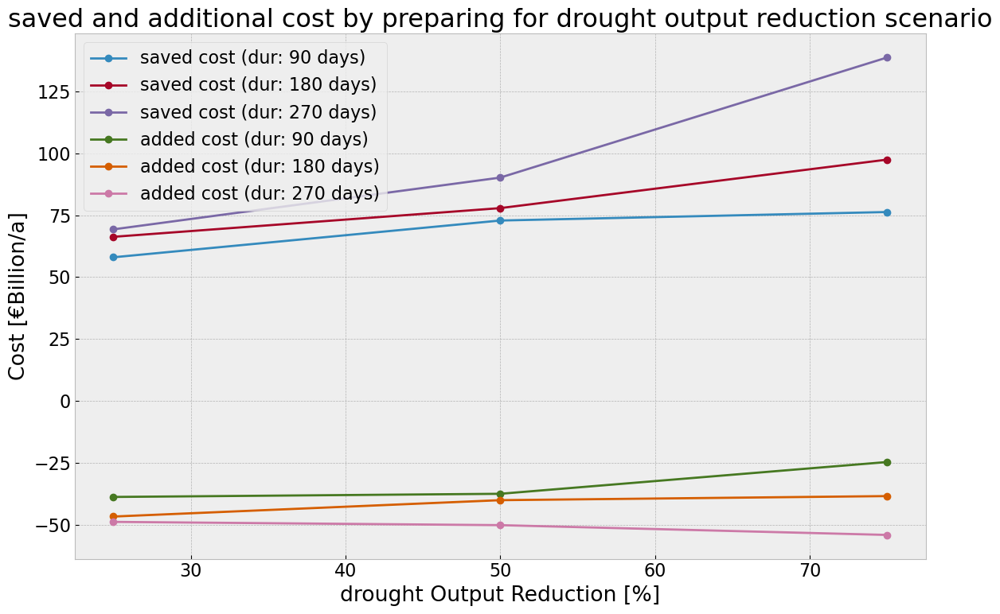

In [270]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [271]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [272]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [273]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.1514492675412664' has dtype incompatib

In [274]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'offwind': 0, 'onwind': 1, 'OCGT': 2, 'solar': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

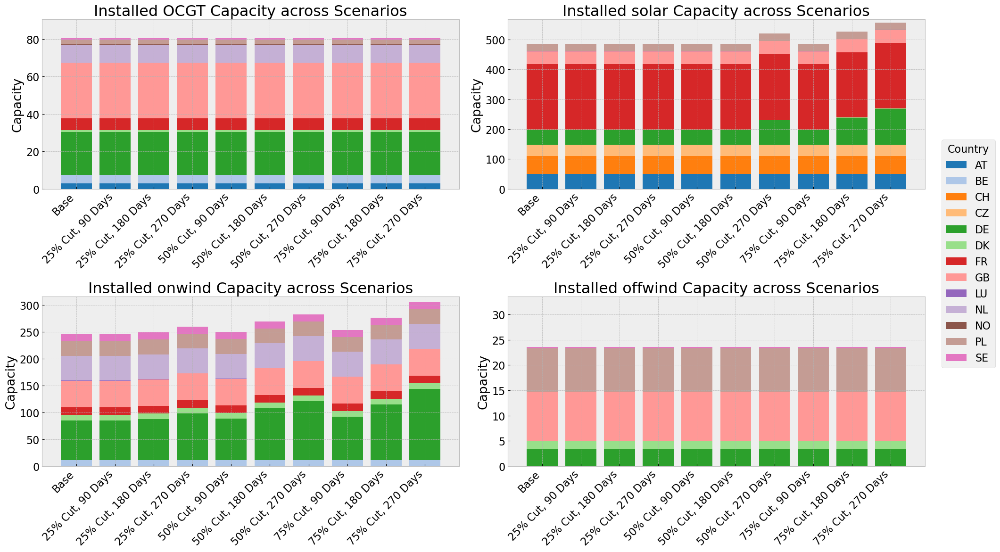

In [275]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [276]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

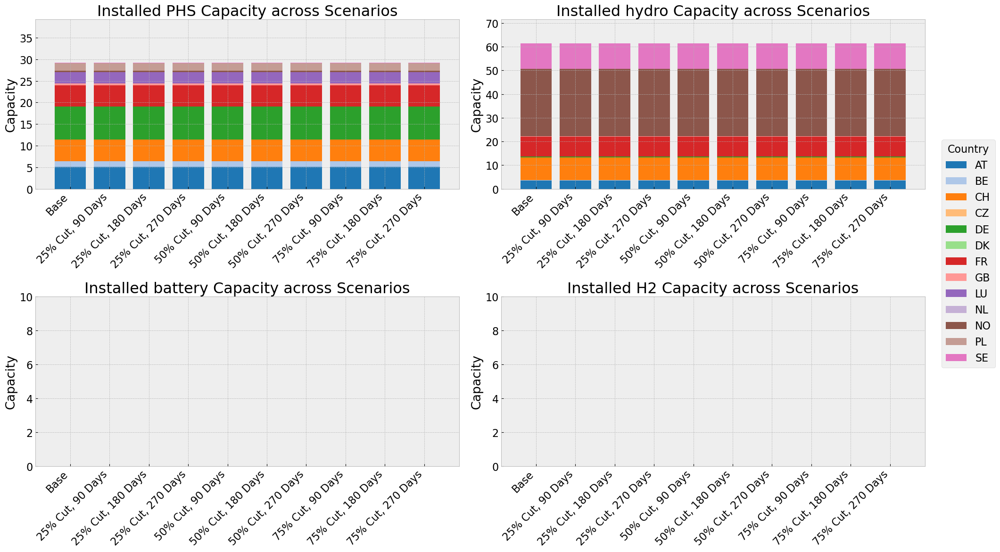

In [277]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [278]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_drought.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\794349181.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_drought.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\794349181.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_drought.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\794349181.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.91138834993883' has dtype i

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_4576\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


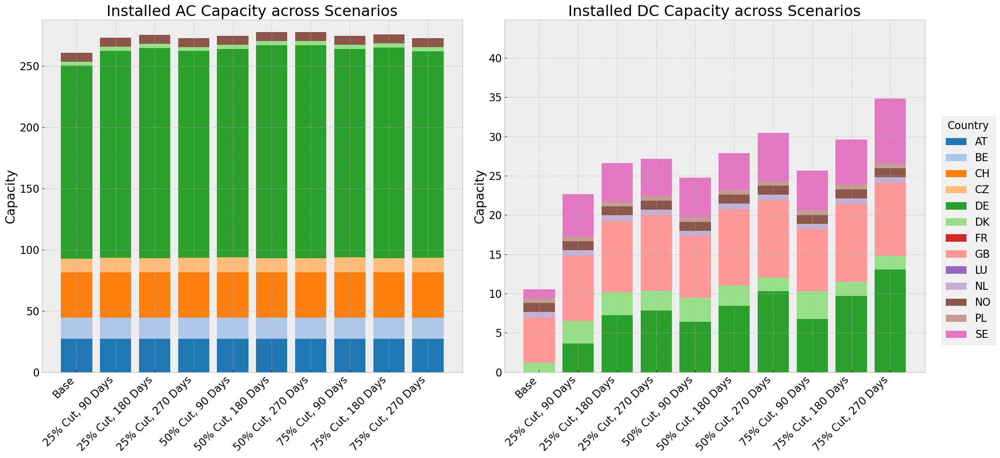

In [279]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()